In [1]:
import numpy as np
import pandas as pd
from astropy.io import fits
from astropy import units as u
from astropy import constants as const
from astropy.wcs import WCS
from scipy import ndimage
import radio_beam
from spectral_cube import SpectralCube
from reproject import reproject_exact
import matplotlib.pyplot as plt
from time import localtime, strftime, time

In [2]:
plt.rcParams['figure.facecolor'] = 'white'
import matplotlib.colors as mcolors
from matplotlib.patches import Ellipse
from matplotlib import rc
rc('font',family='DejaVu Sans',size=20)
#rc('font',family='DejaVu',size=20)
rc('mathtext',fontset='dejavusans')
rc('figure', figsize=(1.41421356237*6.,6.)) 
rc('lines', linewidth=1.8,marker=None,markersize=8 )
rc('axes', linewidth=1.5,labelsize=19)#,prop_cycle=plt.cycler(color=('k','r','b','darkorange','steelblue','hotpink','gold','c','maroon','darkgreen')) )
rc(('xtick.major','ytick.major'), size=5.2,width=1.5)
rc(('xtick.minor','ytick.minor'), size=3.2,width=1.5,visible=True)
rc(('xtick','ytick'), labelsize=15, direction='in' )
rc(('xtick'), top=True,bottom=True ) # For some stupid reason you have to do these seperately
rc(('ytick'), left=True,right=True )
rc('legend',numpoints=1,scatterpoints=1,labelspacing=0.2,fontsize=15,fancybox=True,handlelength=1.5,
            handletextpad=0.5)
rc('savefig', dpi=150,format='pdf',bbox='tight' )
rc('errorbar',capsize=3.)

In [2]:
import os.path
import glob

In [3]:
colloquiumpath = '/users/brodriguez/Documents/Notebooks/colloquiumfigures/'
figurepath    = '/vol/aibn1081/data1/brodriguez/Figures/'
databasepath    = '/vol/aibn1081/data1/brodriguez/Databases/'
califaoutpath = '/vol/aibn1081/data1/brodriguez/CALIFA/'
acaoutpath    = '/vol/aibn1081/data1/brodriguez/ACA/'
califainpath  = '/vol/alcina/data1/shared/EDGE/PIPE3DS_v2.3/'
acainpath     = '/vol/alcina/data1/shared/EDGE/aca_edge_natv/cubes/'

In [4]:
aca_table = pd.read_csv(databasepath+'ACA_sourcelist.csv',sep=',',index_col=0)

In [5]:
aca_table.info()

<class 'pandas.core.frame.DataFrame'>
Index: 60 entries, CGCG429-012 to VV488NED02
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   califa_file         60 non-null     object 
 1   Final_QS            60 non-null     object 
 2   Final_NA            60 non-null     object 
 3   RA                  60 non-null     float64
 4   DEC                 60 non-null     float64
 5   inclination_ACA     60 non-null     int64  
 6   PA_ACA              60 non-null     int64  
 7   z_ACA               60 non-null     float64
 8   Dist_Mpc_ACA        60 non-null     int64  
 9   Re_arc_ACA          60 non-null     float64
 10  z_stars             60 non-null     float64
 11  inclination_califa  60 non-null     float64
 12  PA_califa           60 non-null     float64
 13  Re_arc_califa       60 non-null     float64
 14  Re_kpc_califa       60 non-null     float64
 15  log_Mass            60 non-null     float64
 1

In [5]:
aca_table = aca_table[aca_table['inclination_califa']<70]
sources = aca_table[aca_table['califa_file']!='---'].index.to_numpy()
aca_table = aca_table.loc[sources]

In [6]:
print(len(aca_table))

40


In [7]:
from astropy.cosmology import LambdaCDM#, FlatLambdaCDM
cosmo = LambdaCDM(H0=69.7,Om0=0.3,Ode0=0.7)

In [8]:
def get_data(filename,header=False):
    hdu_list = fits.open(filename)
    data = hdu_list[0].data
    hdr = hdu_list[0].header
    hdu_list.close()
    if header:
        return data, hdr
    else:
        return data

In [9]:
import warnings
from spectral_cube.utils import SpectralCubeWarning
warnings.filterwarnings(action='ignore', category=SpectralCubeWarning,append=True)

In [10]:
cmap_rainbow = mcolors.LinearSegmentedColormap.from_list('mycmap',['blue','cyan','yellow','red'])
cmap_BPT = mcolors.ListedColormap(['w', 'b', 'r', 'g'])
cmap_EW = mcolors.ListedColormap(['purple','orange','cyan'])


Initializing source 1 of 40: CGCG429-012


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


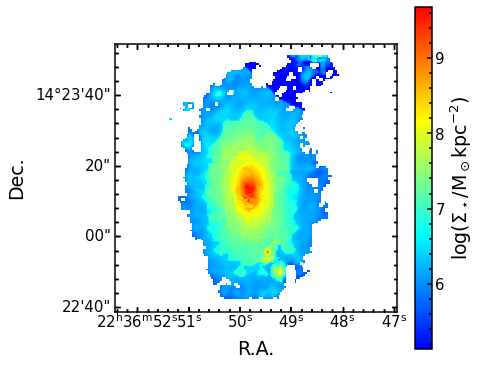

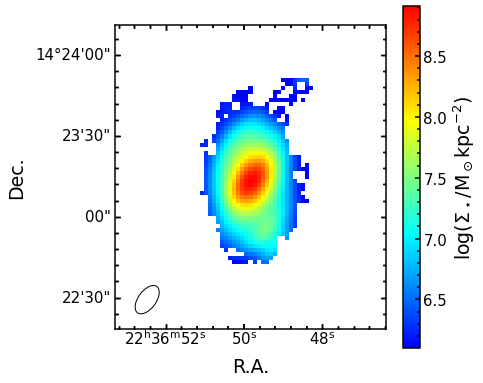

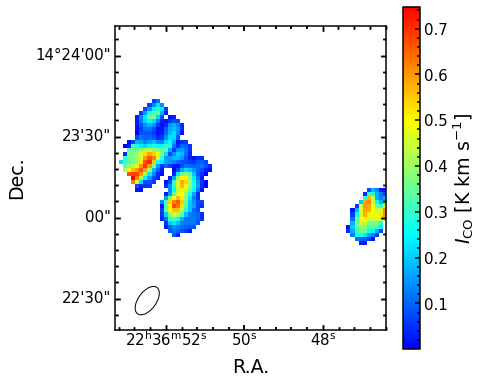

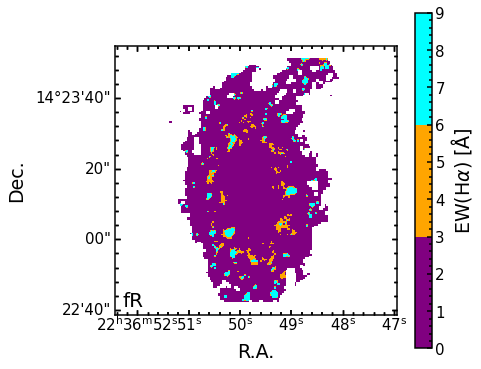

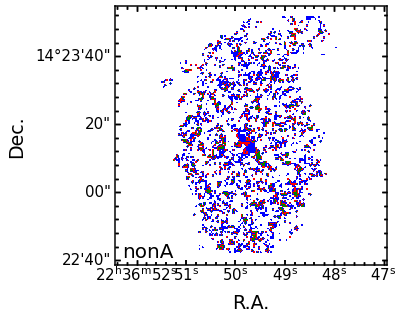


Initializing source 2 of 40: IC1079


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


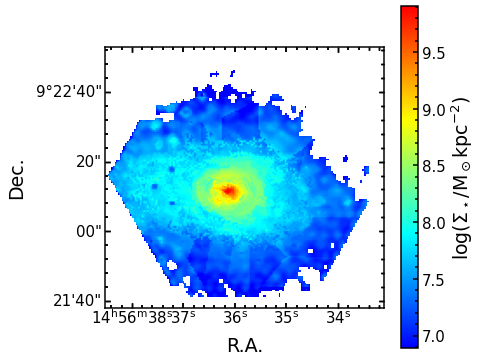

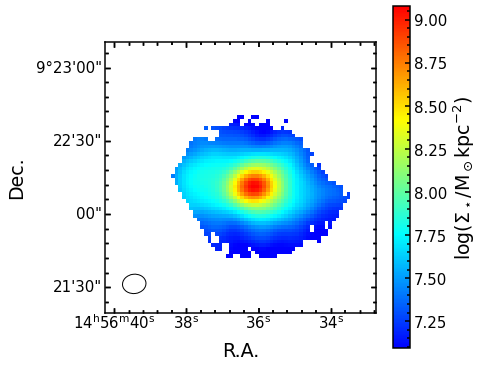

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


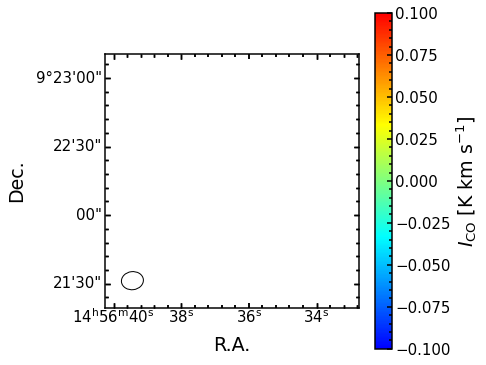

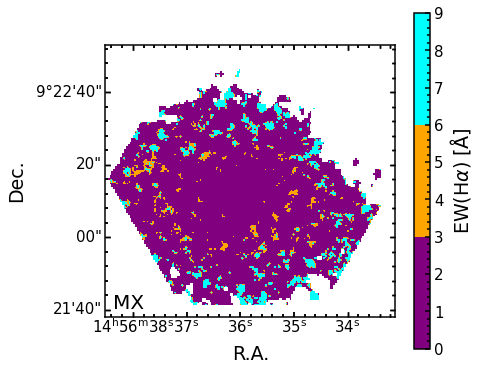

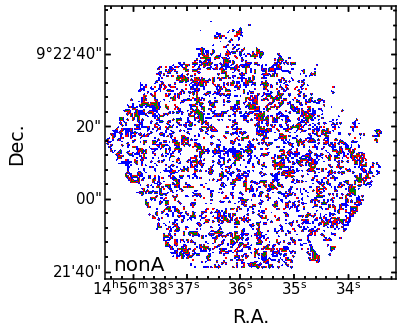


Initializing source 3 of 40: IC1528


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


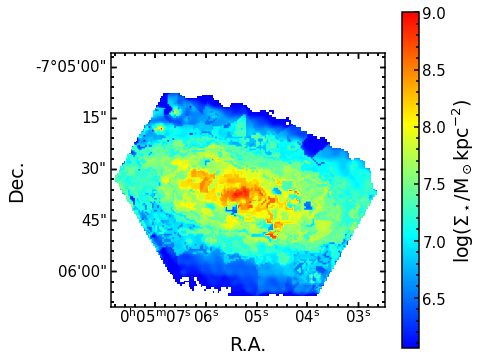

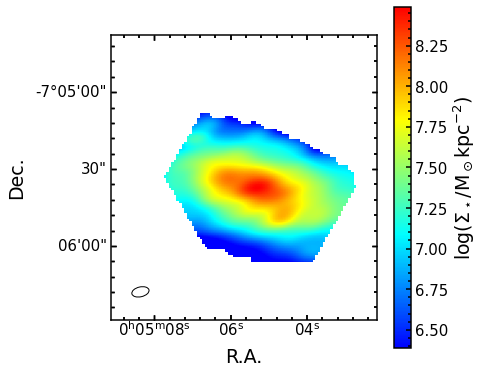

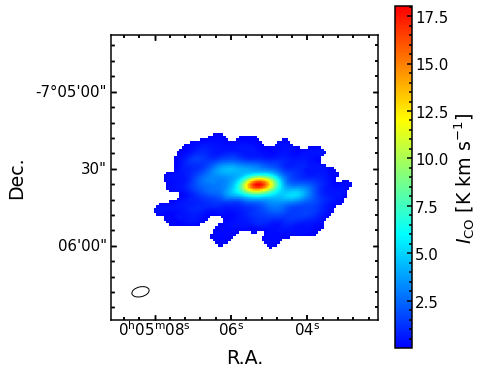

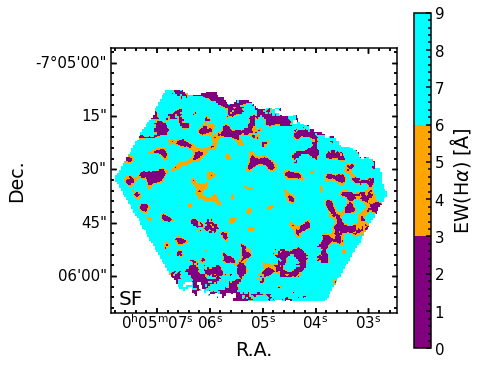

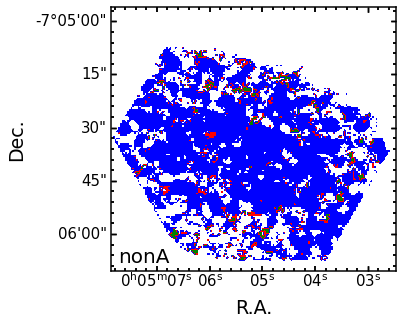


Initializing source 4 of 40: IC2341


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


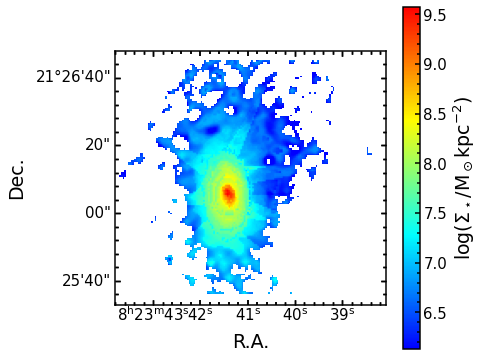

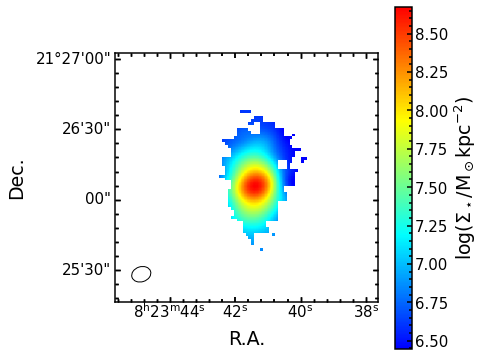

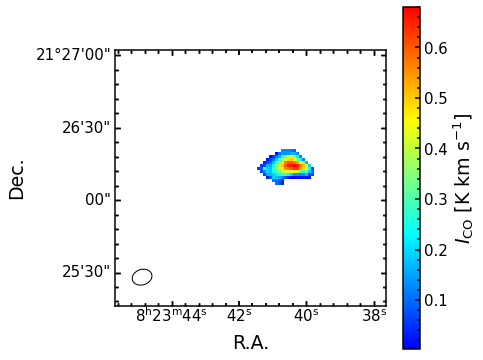

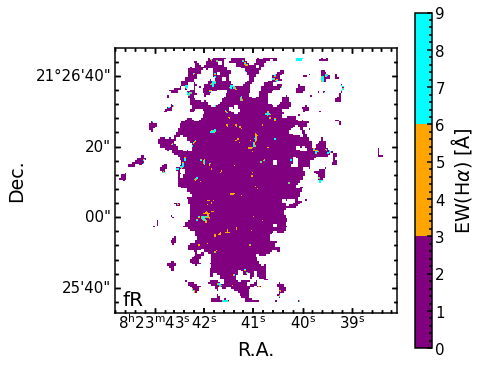

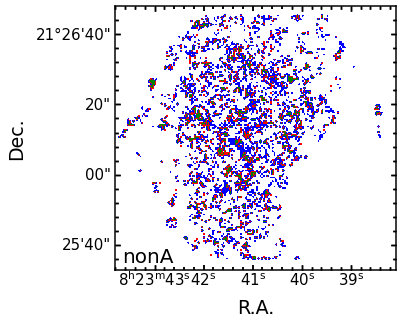


Initializing source 5 of 40: MCG-01-52-012


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


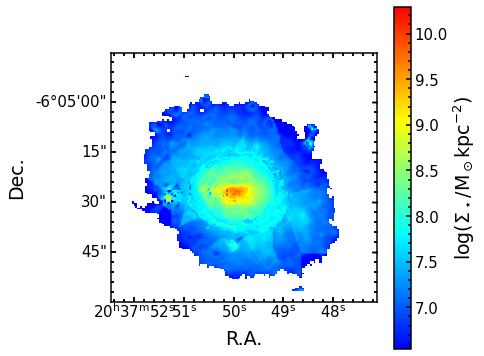

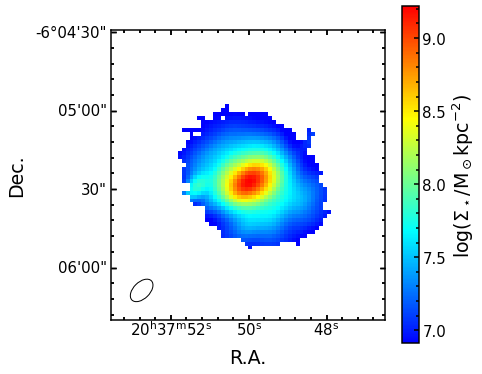

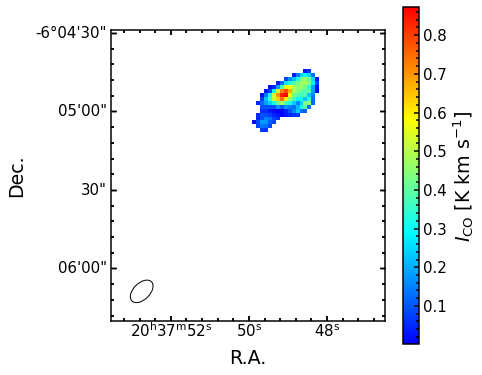

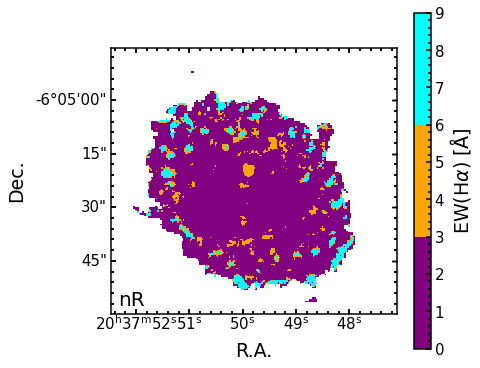

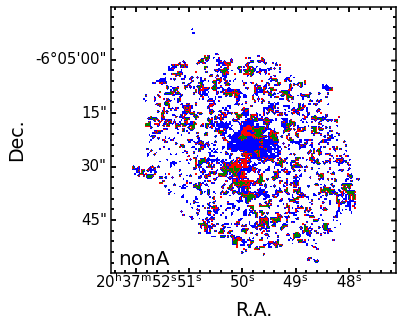


Initializing source 6 of 40: MCG-02-02-030


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


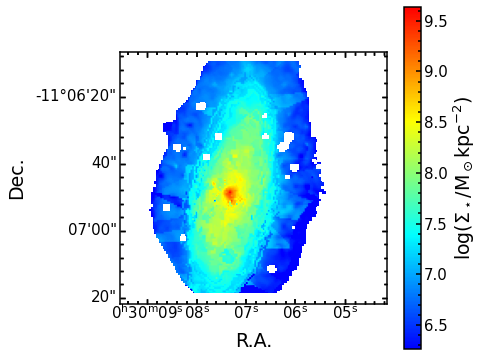

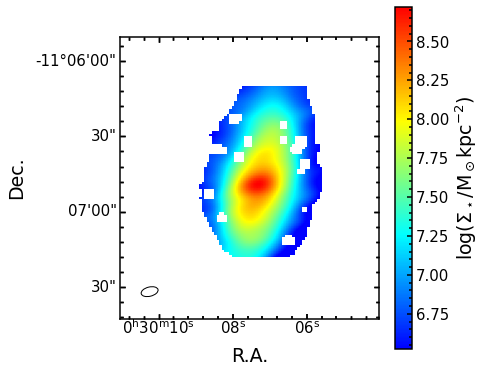

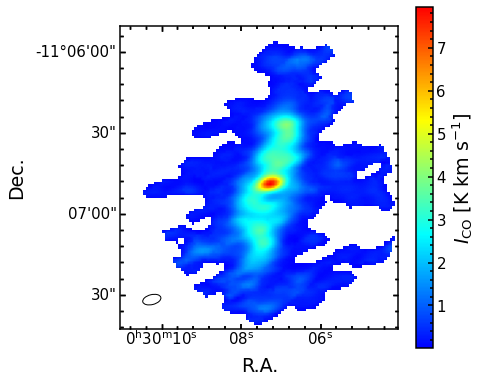

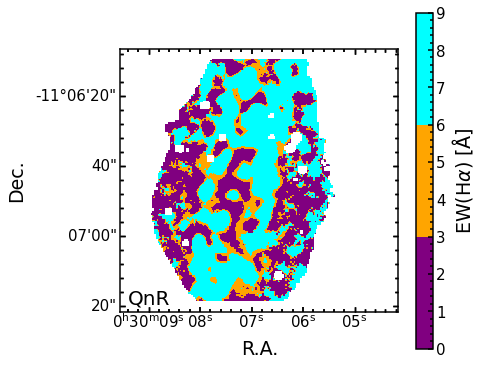

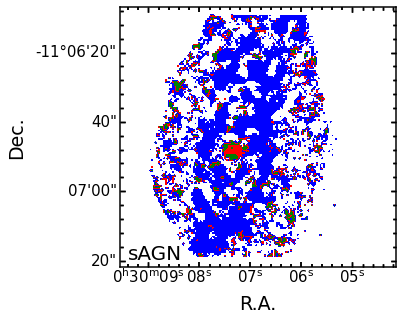


Initializing source 7 of 40: NGC0001


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


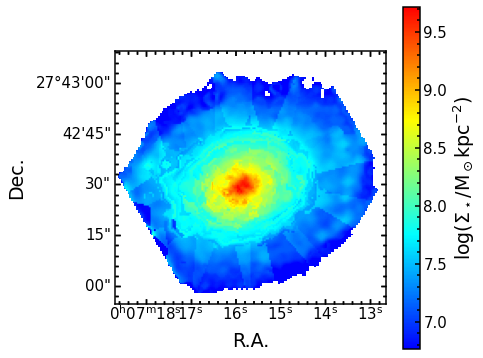

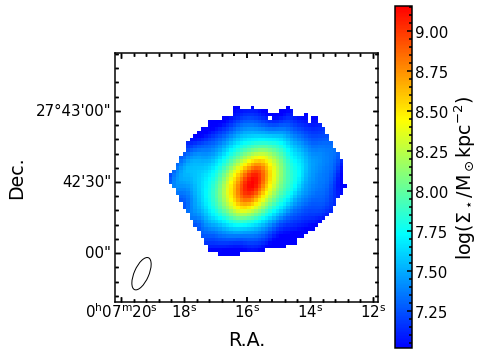

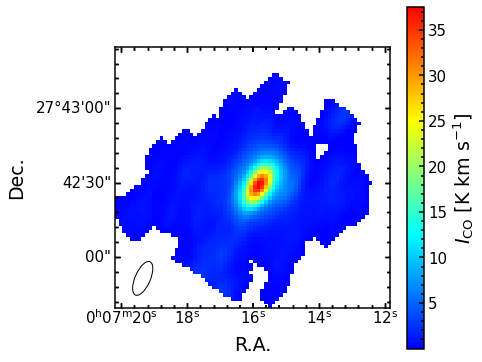

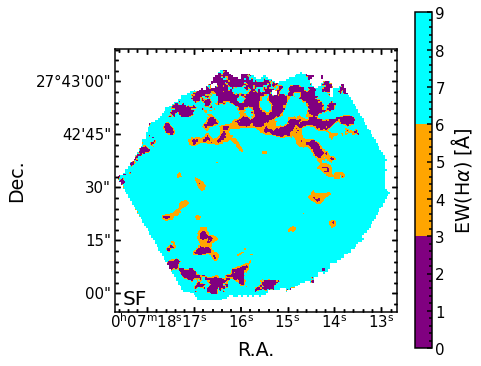

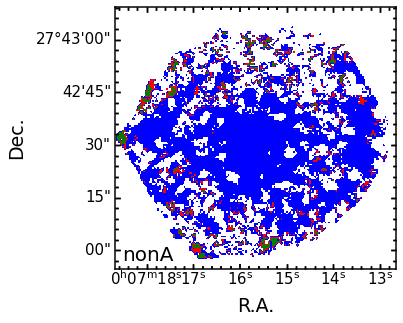


Initializing source 8 of 40: NGC0155


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


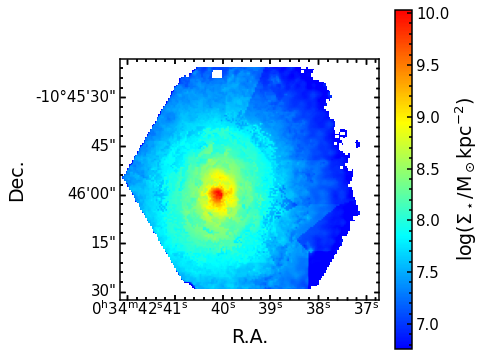

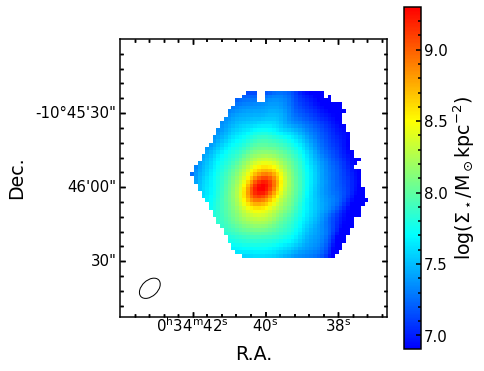

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


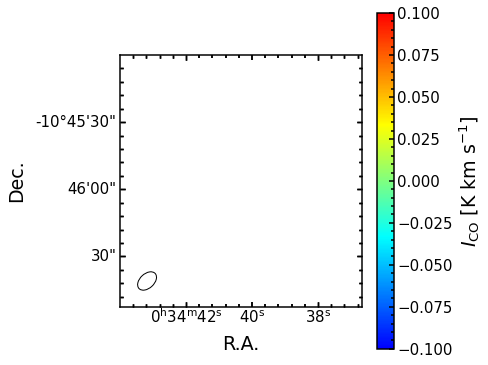

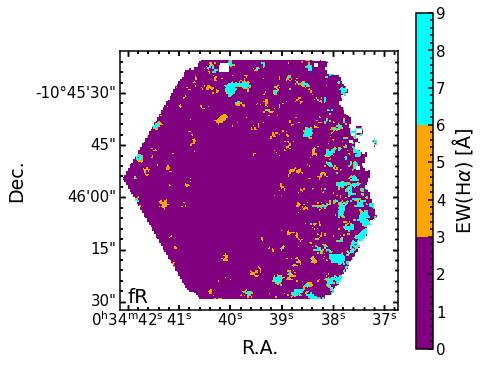

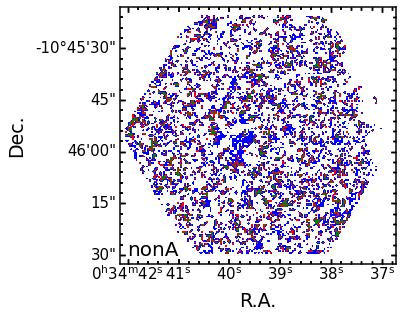


Initializing source 9 of 40: NGC0171


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


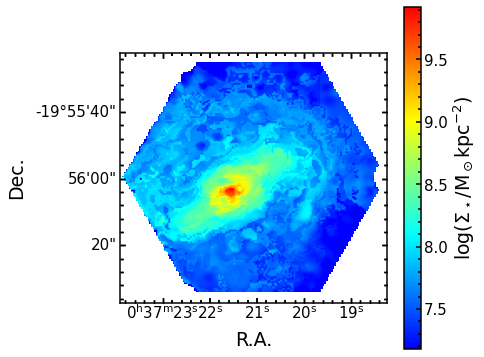

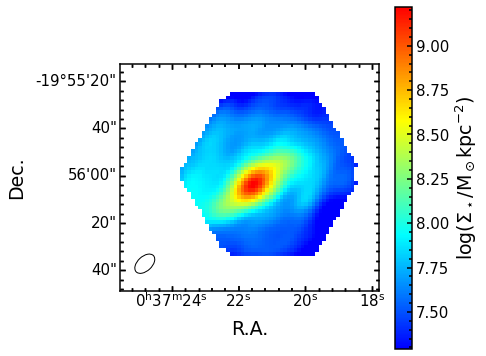

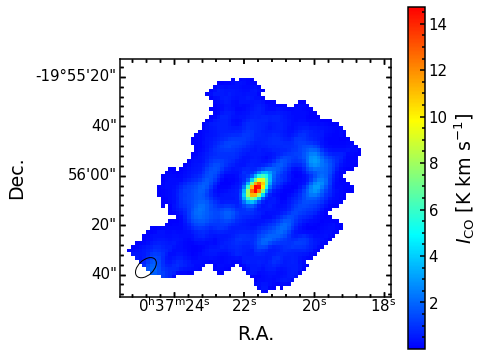

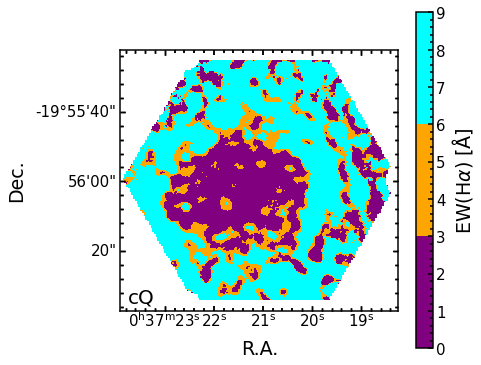

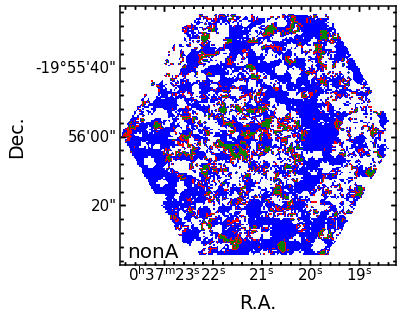


Initializing source 10 of 40: NGC0180


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


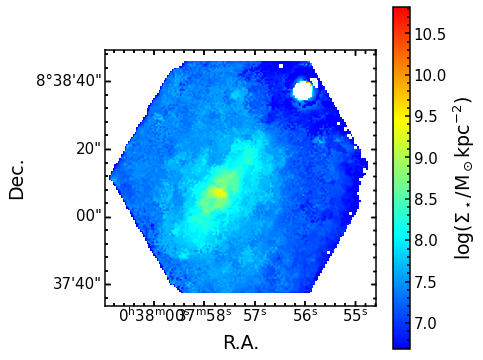

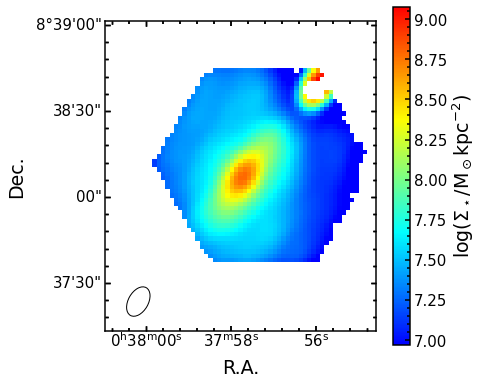

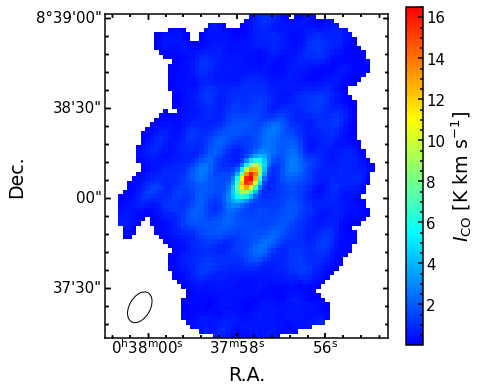

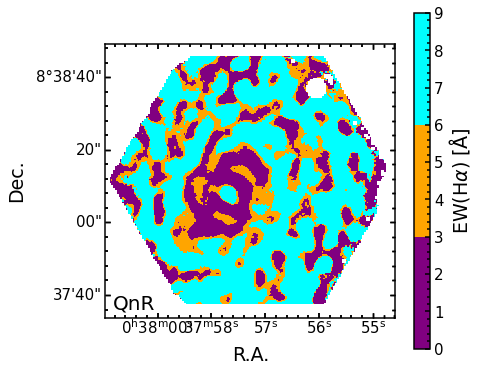

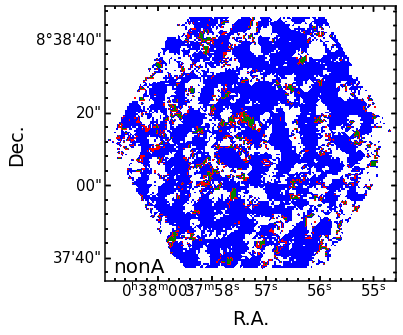


Initializing source 11 of 40: NGC0693


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


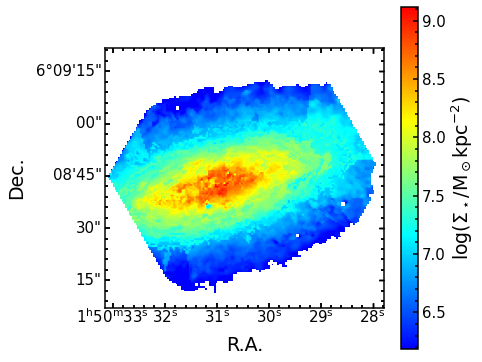

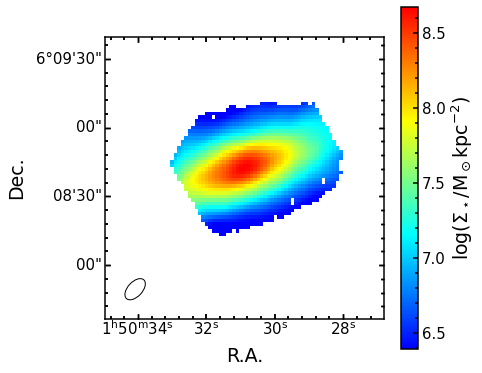

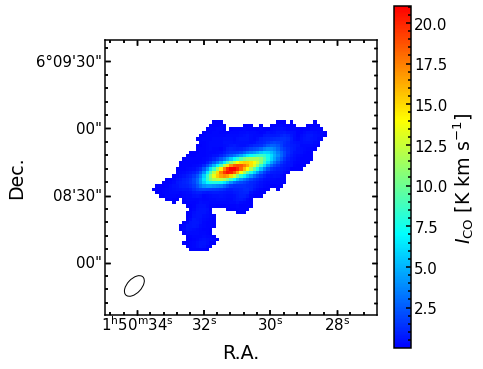

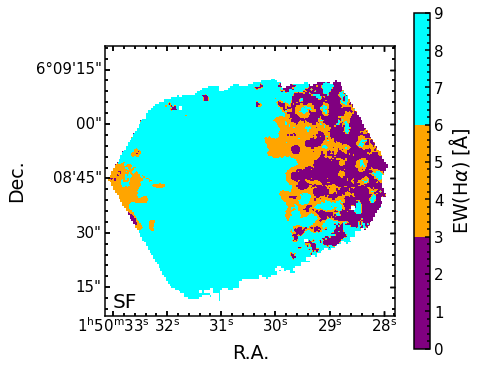

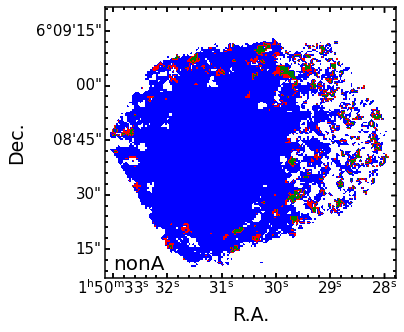


Initializing source 12 of 40: NGC0731


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


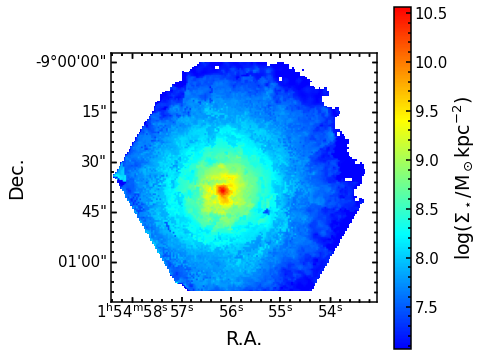

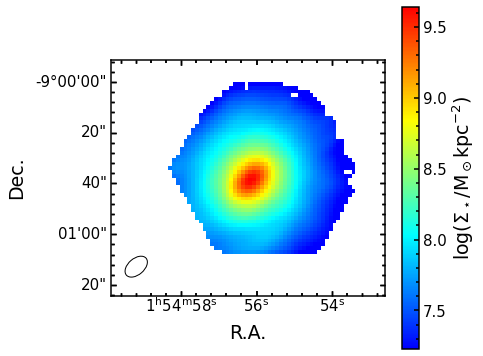

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


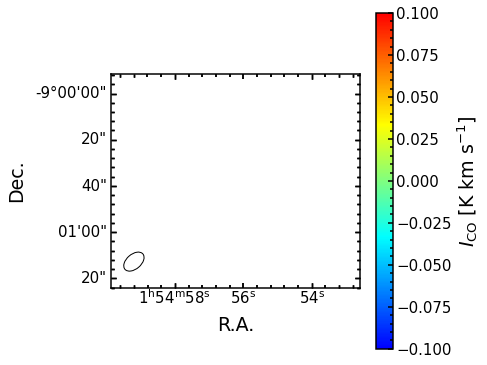

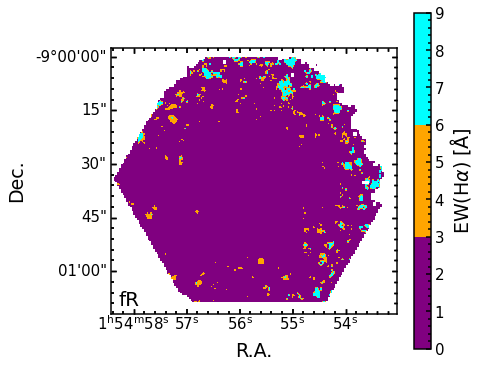

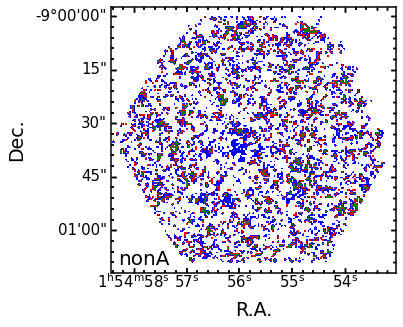


Initializing source 13 of 40: NGC0768


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


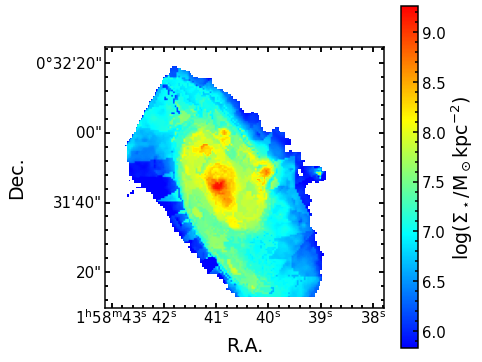

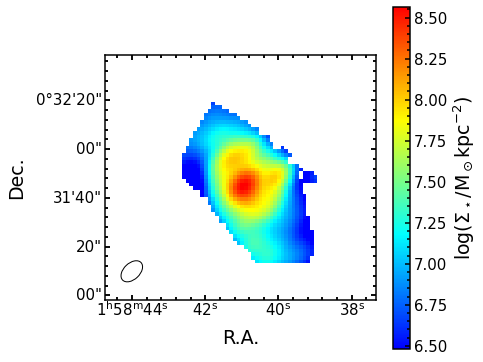

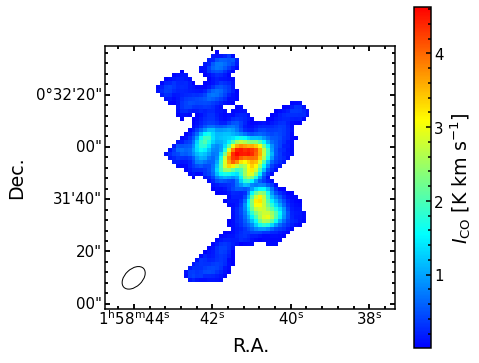

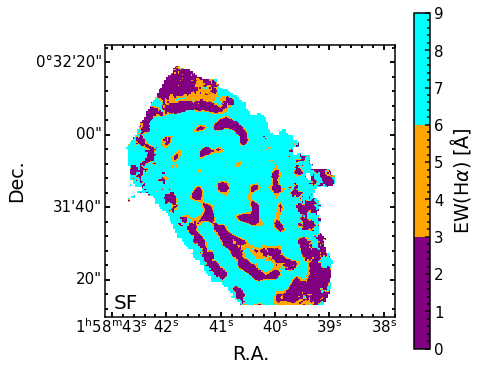

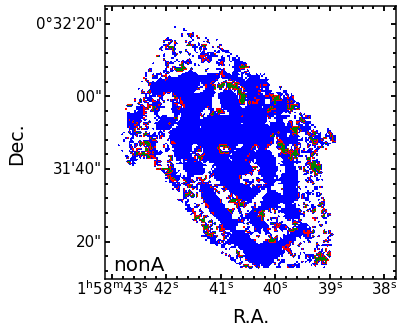


Initializing source 14 of 40: NGC1056


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


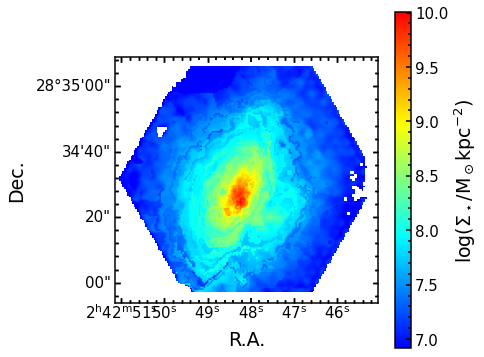

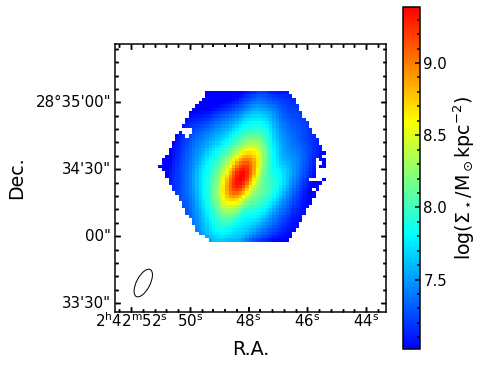

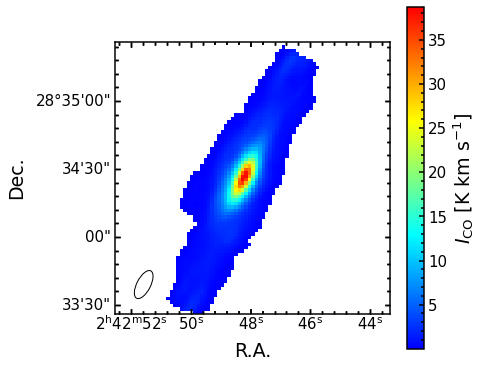

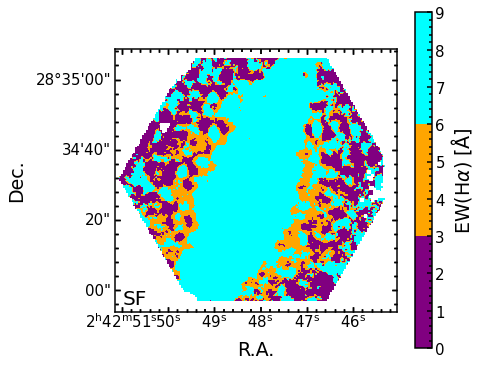

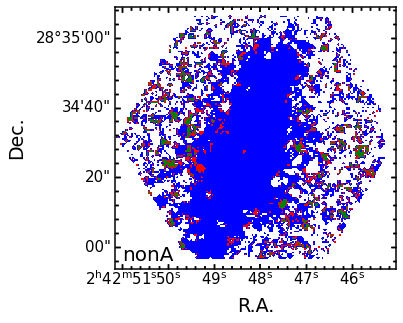


Initializing source 15 of 40: NGC1542


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


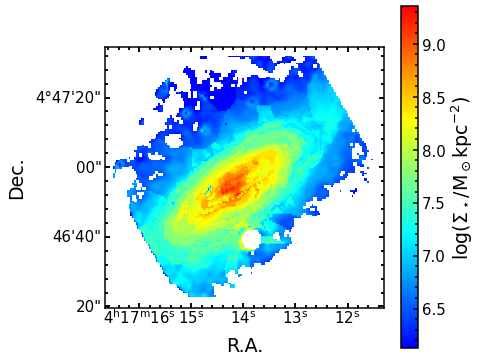

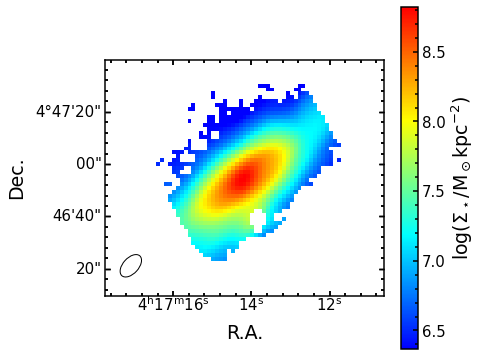

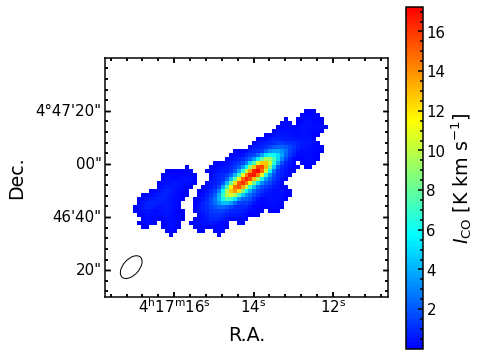

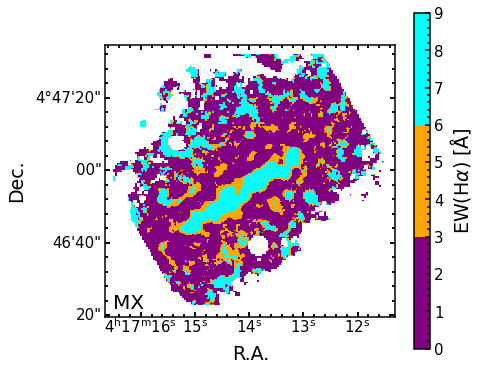

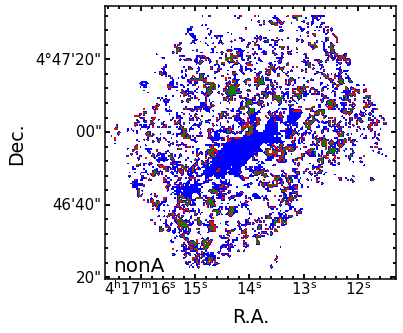


Initializing source 16 of 40: NGC2449


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


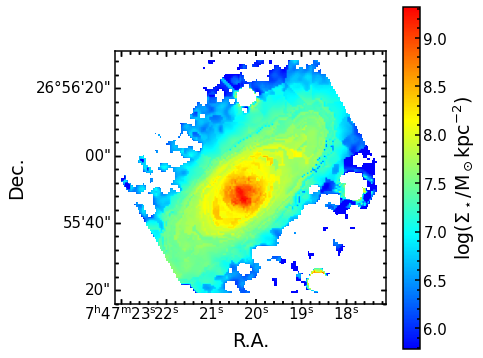

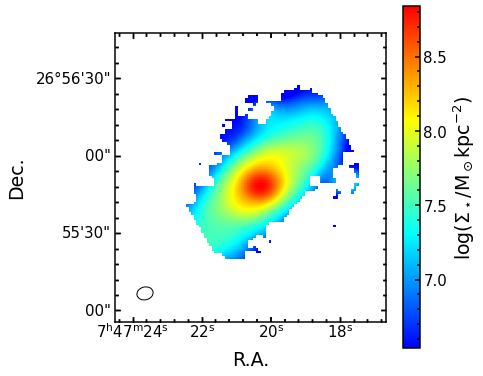

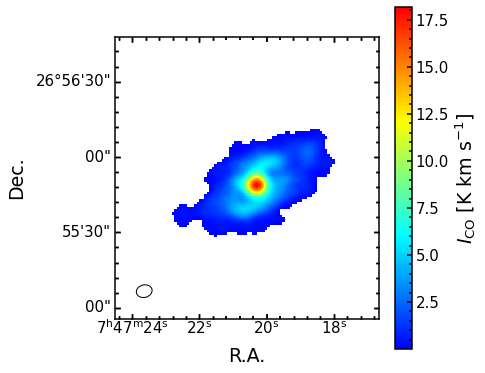

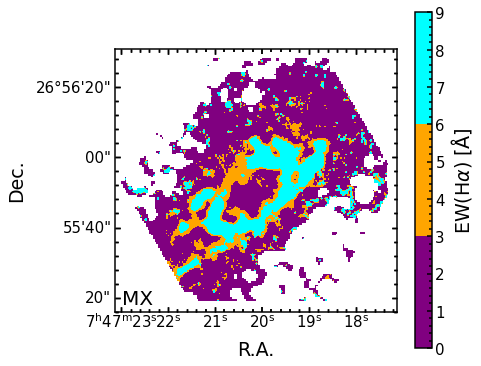

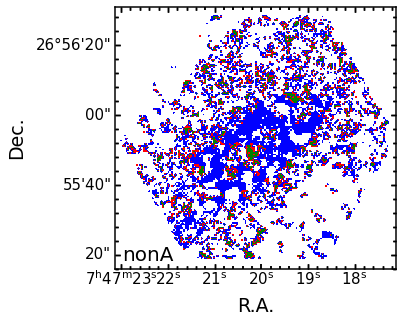


Initializing source 17 of 40: NGC2540


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


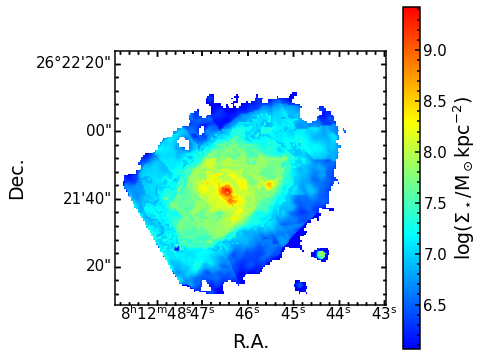

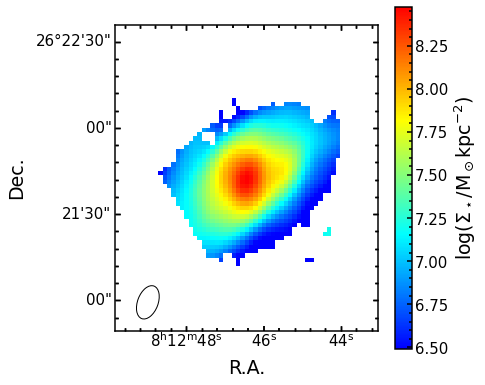

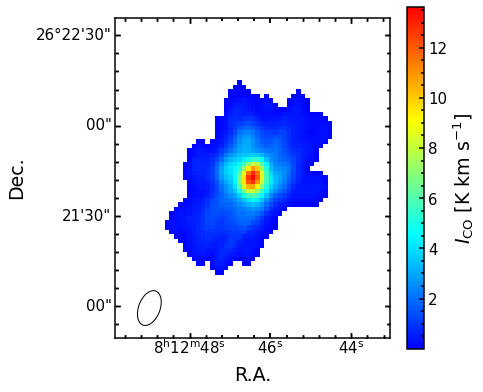

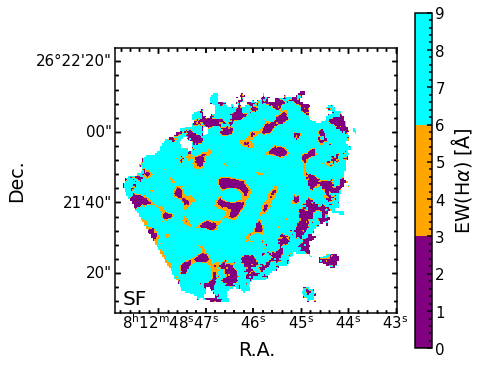

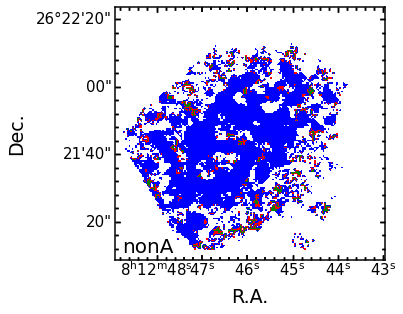


Initializing source 18 of 40: NGC2554


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


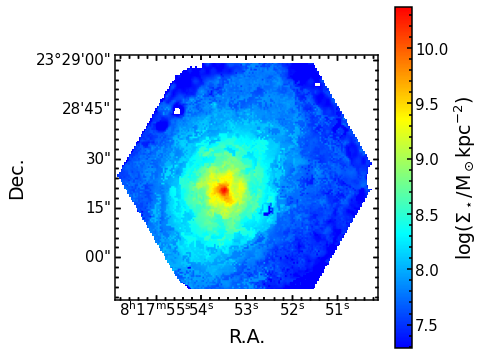

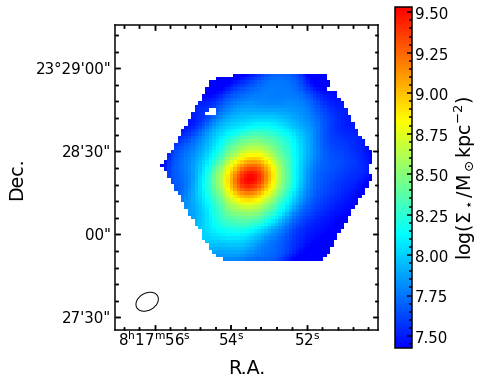

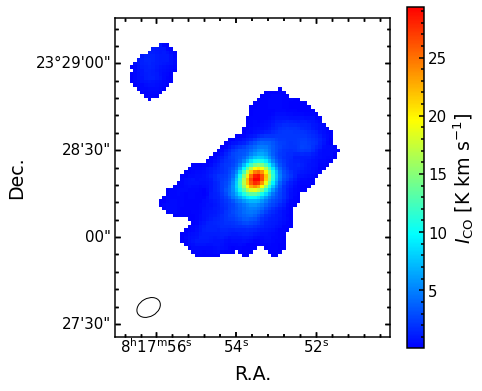

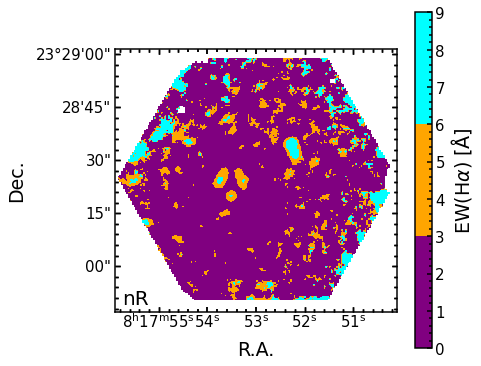

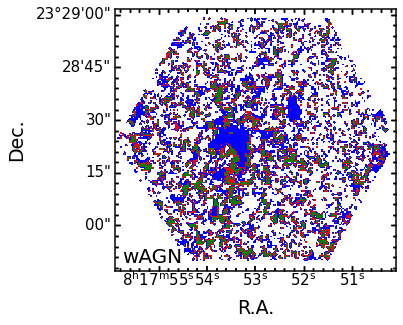


Initializing source 19 of 40: NGC2595


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


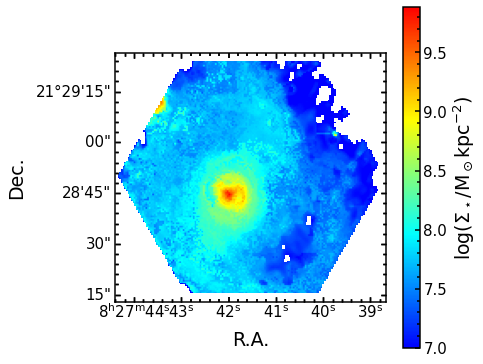

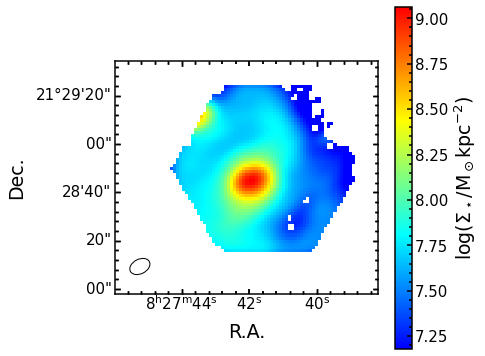

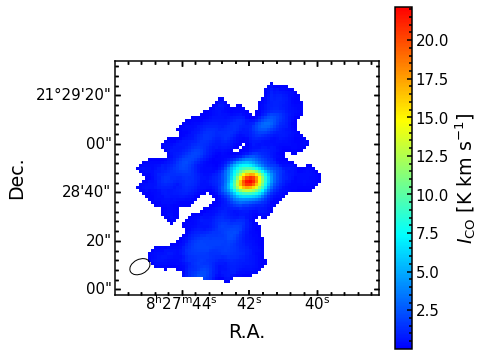

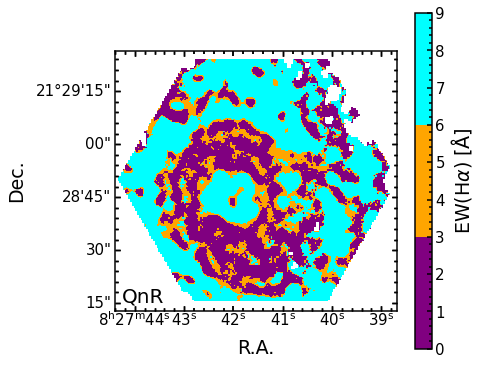

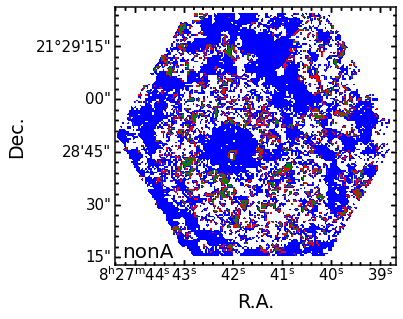


Initializing source 20 of 40: NGC3300


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


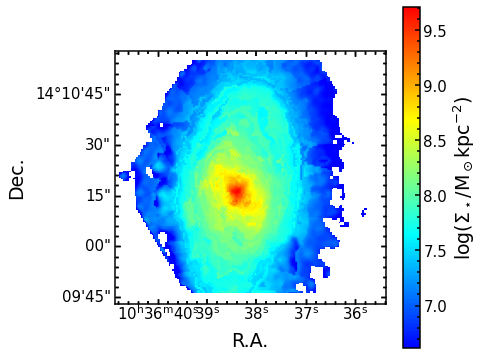

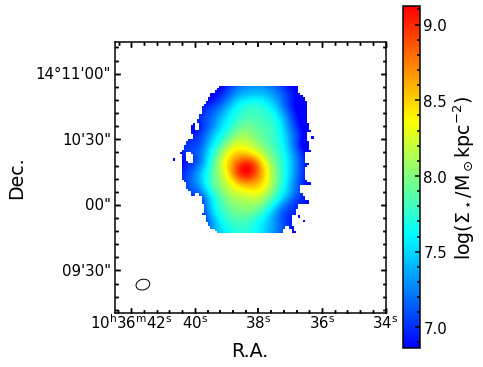

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


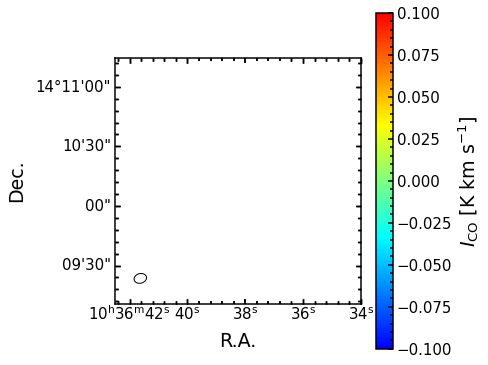

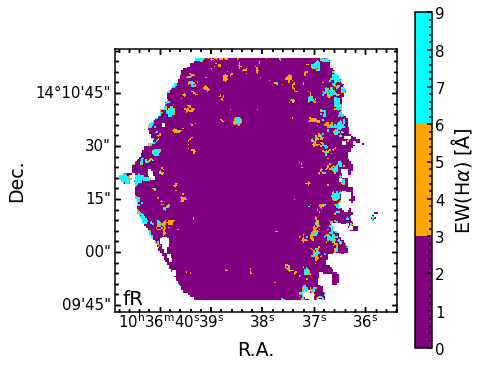

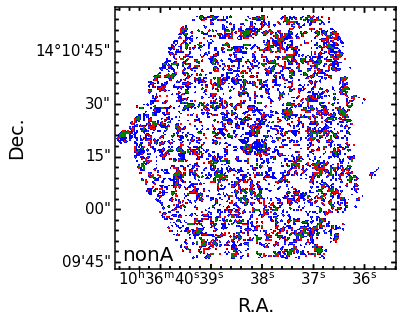


Initializing source 21 of 40: NGC7025


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


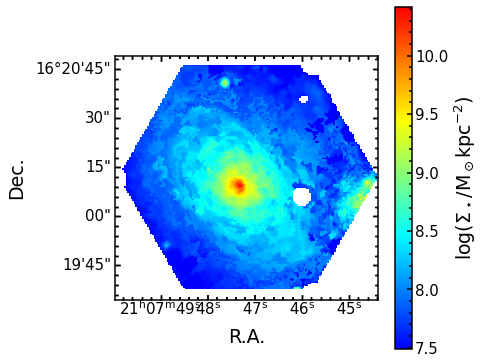

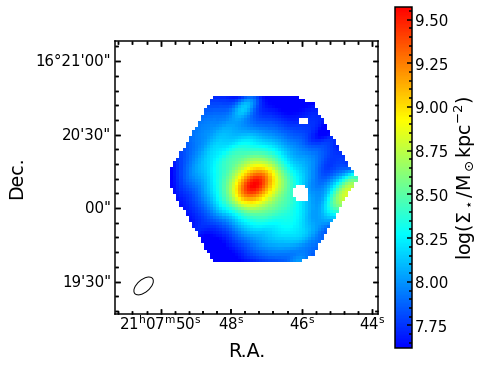

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


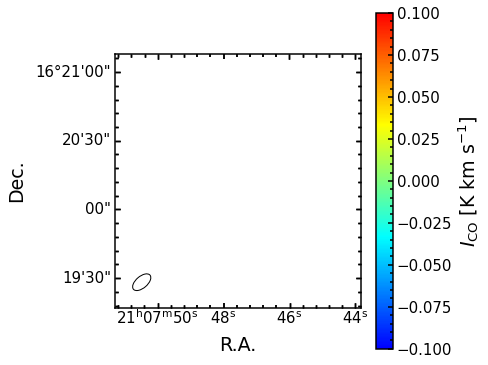

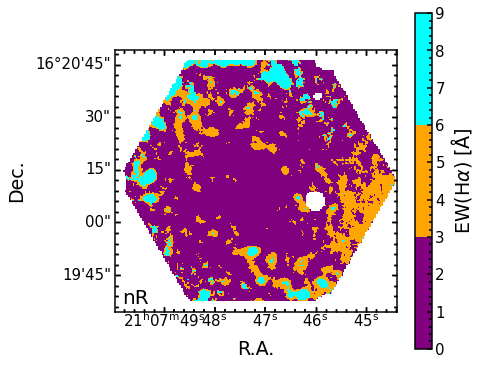

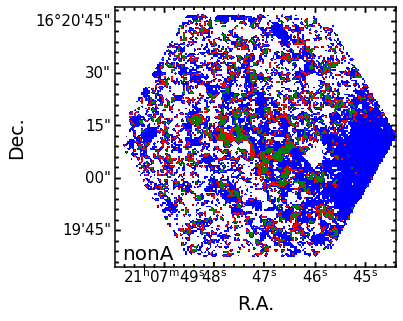


Initializing source 22 of 40: NGC7194


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


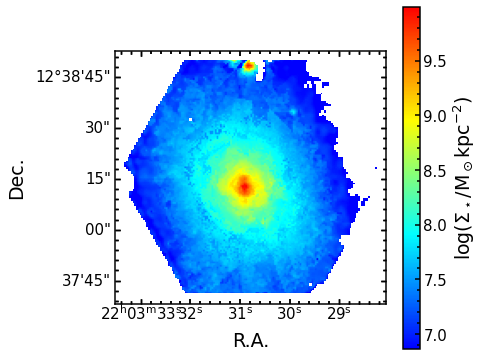

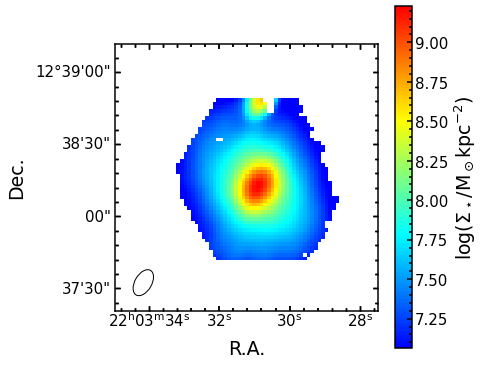

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


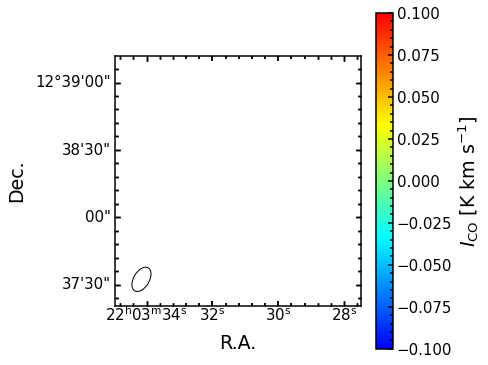

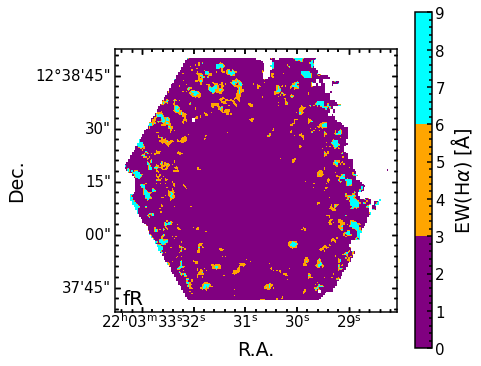

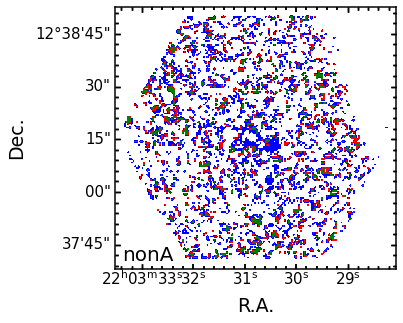


Initializing source 23 of 40: NGC7311


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


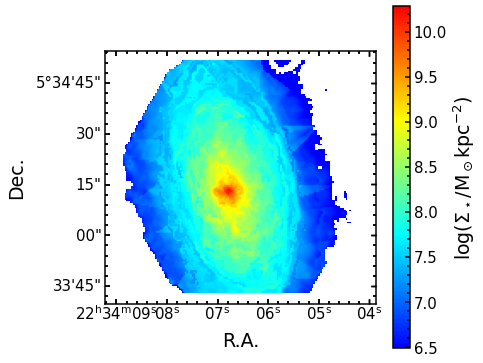

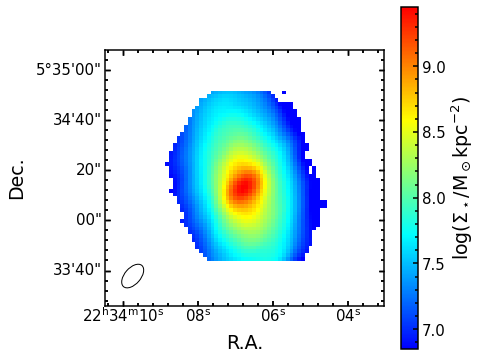

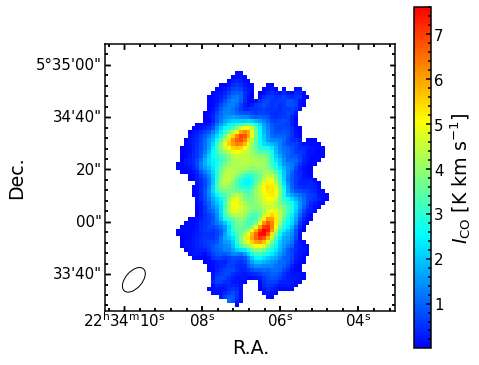

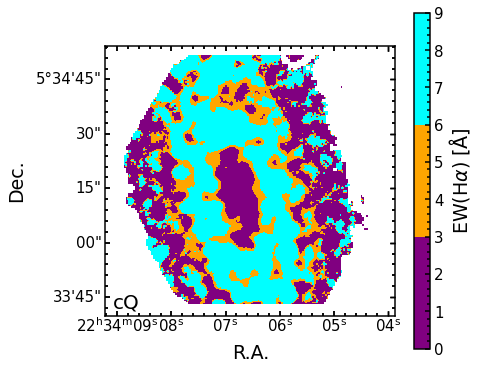

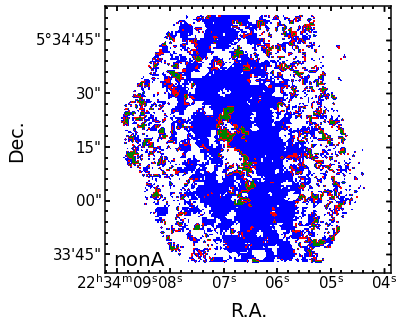


Initializing source 24 of 40: NGC7321


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


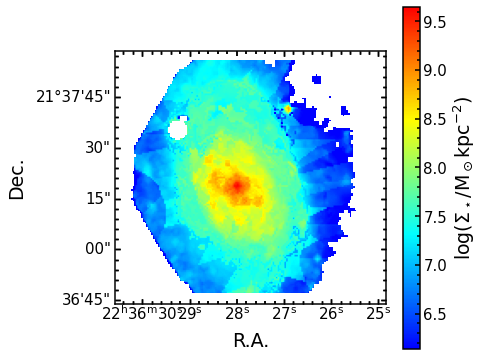

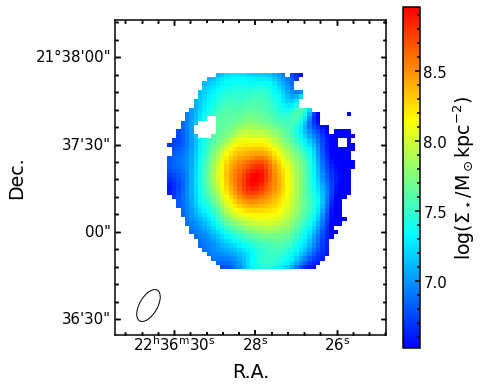

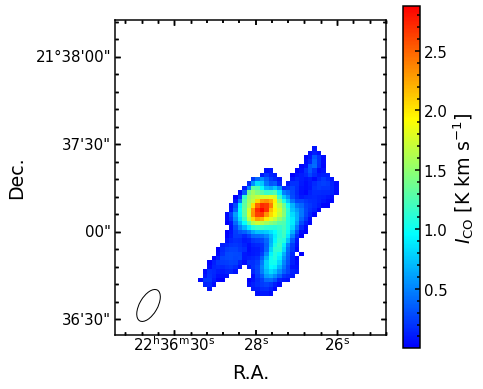

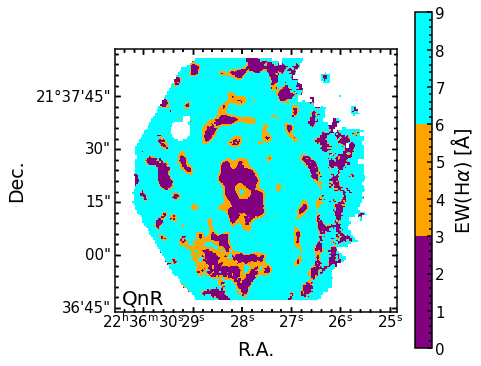

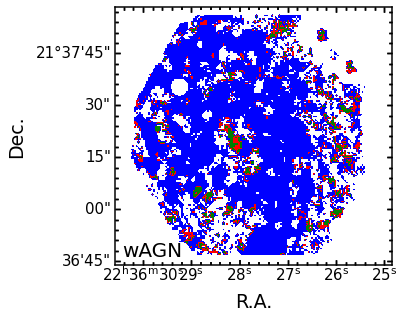


Initializing source 25 of 40: NGC7364


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


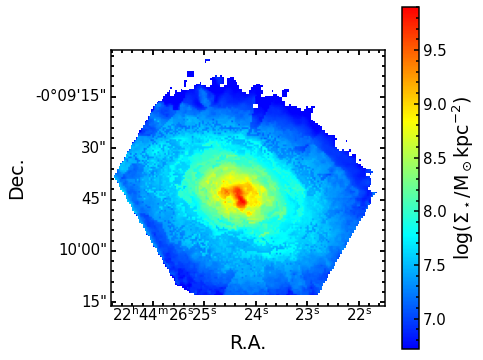

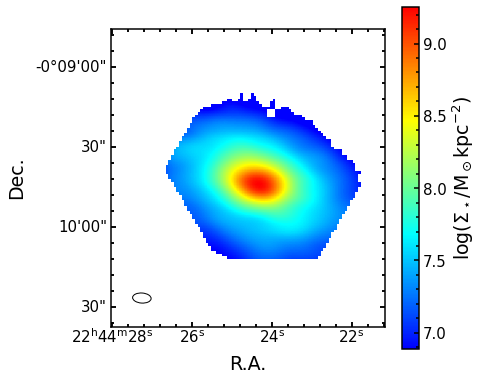

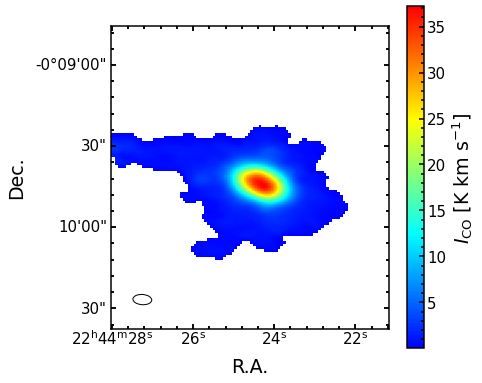

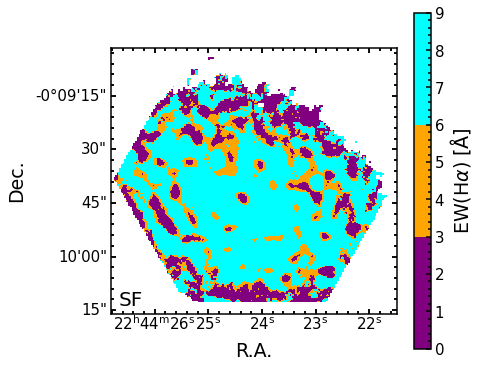

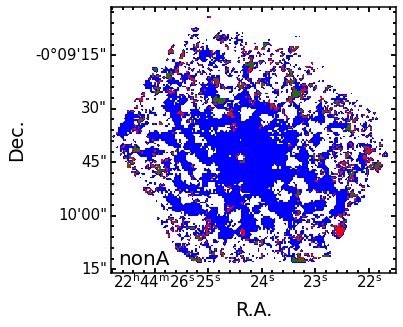


Initializing source 26 of 40: NGC7466


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


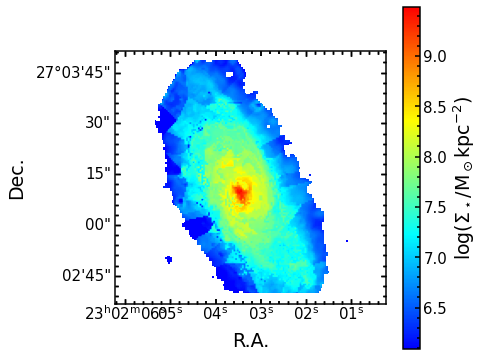

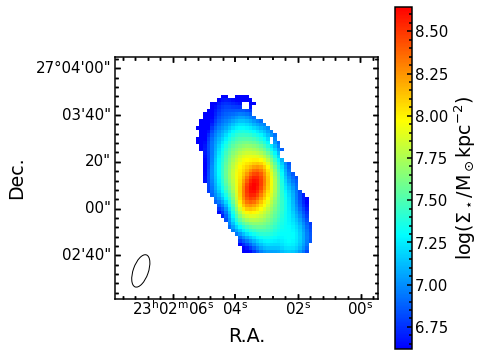

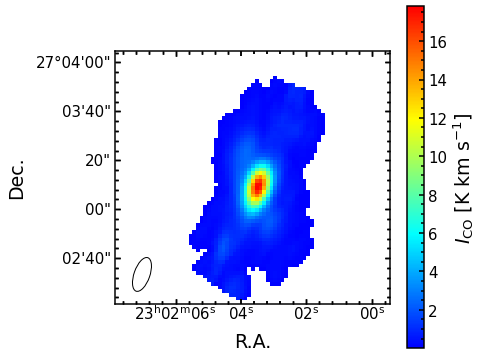

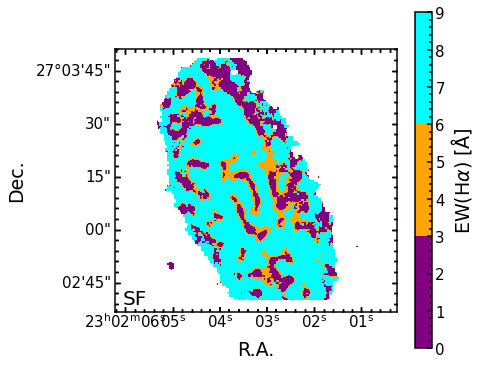

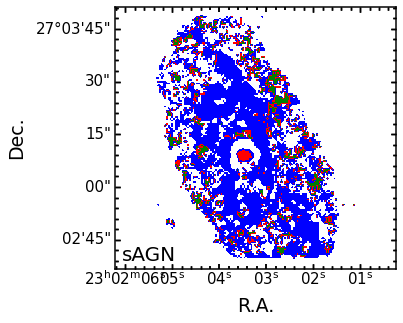


Initializing source 27 of 40: NGC7489


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


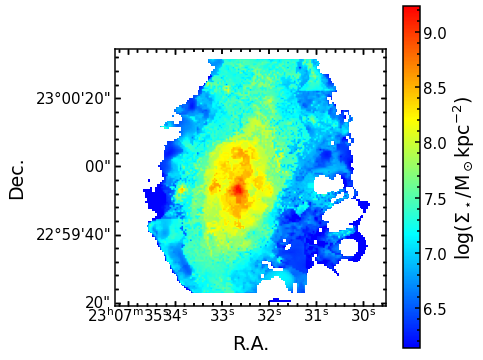

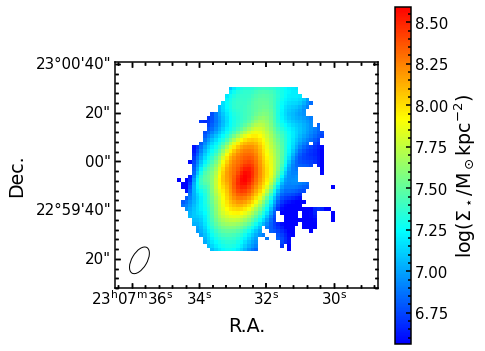

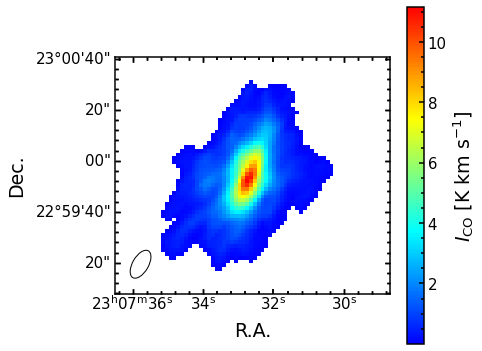

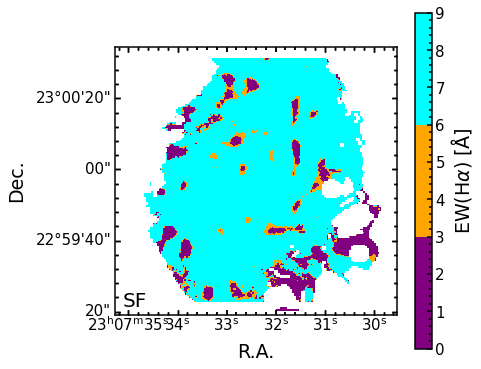

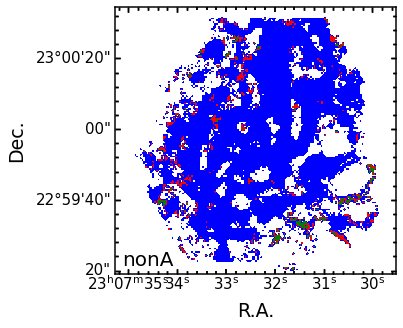


Initializing source 28 of 40: NGC7625


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


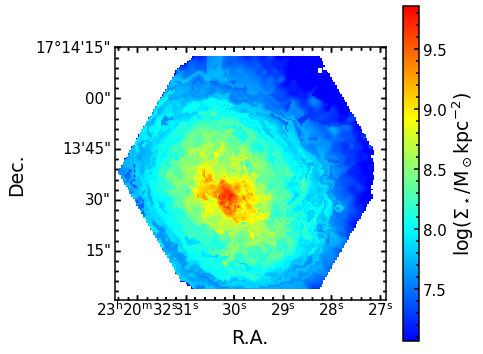

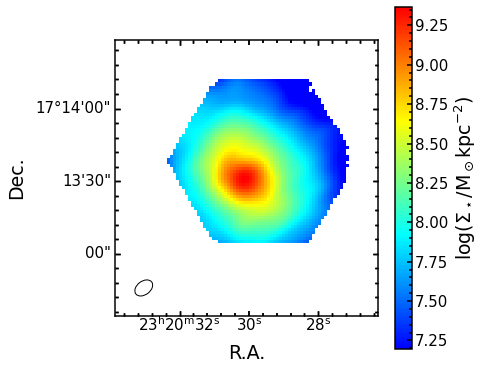

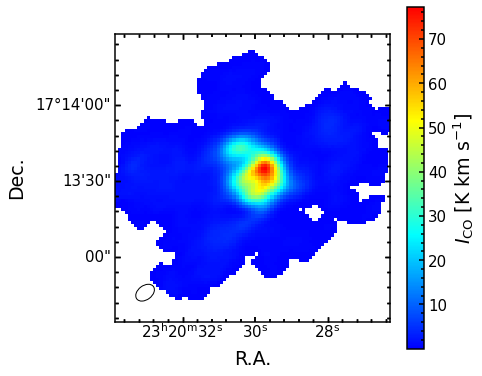

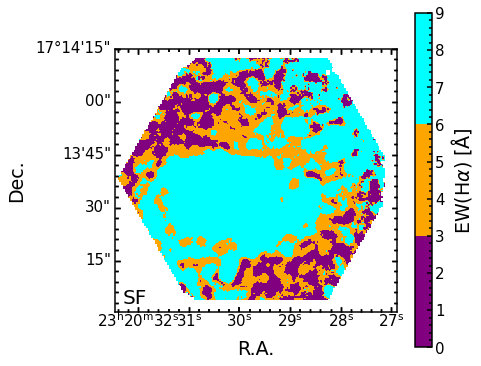

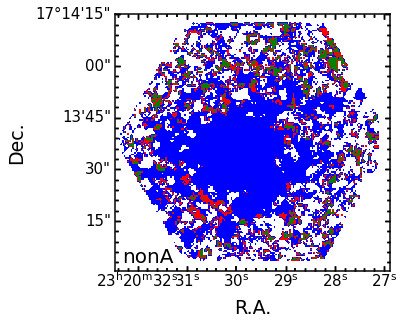


Initializing source 29 of 40: NGC7716


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


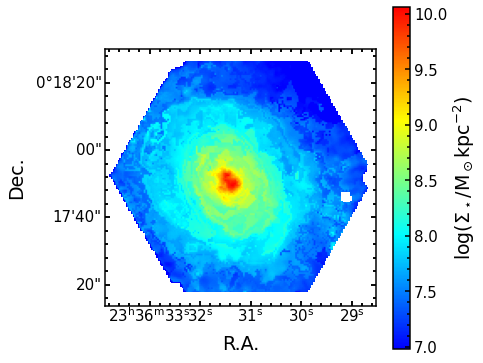

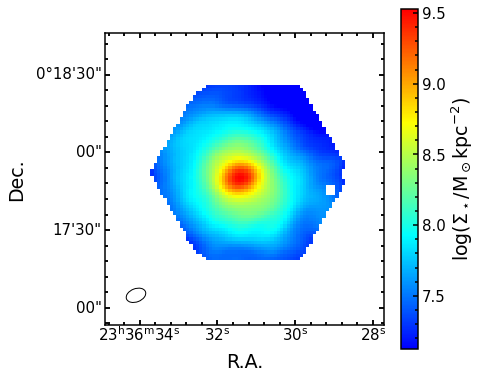

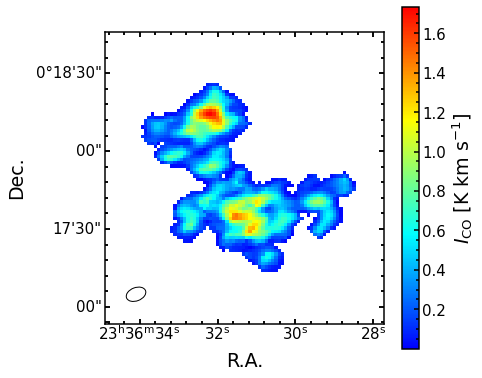

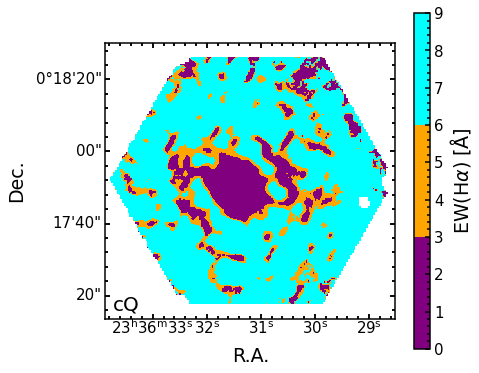

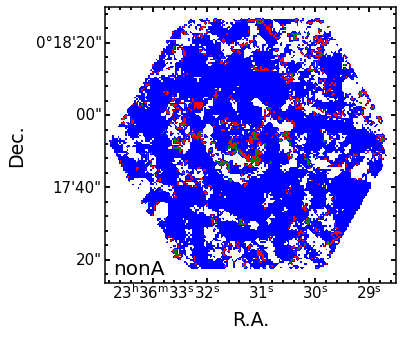


Initializing source 30 of 40: UGC00312


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


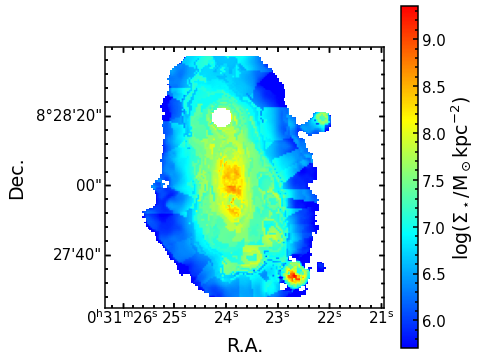

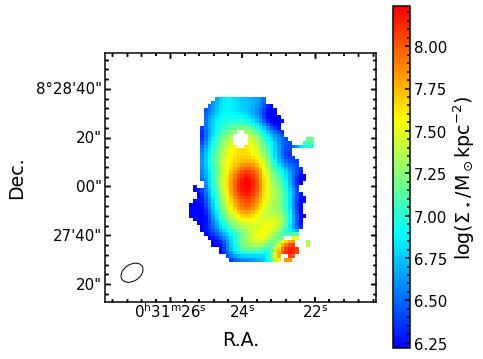

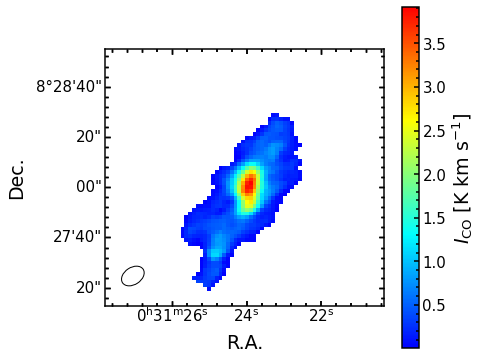

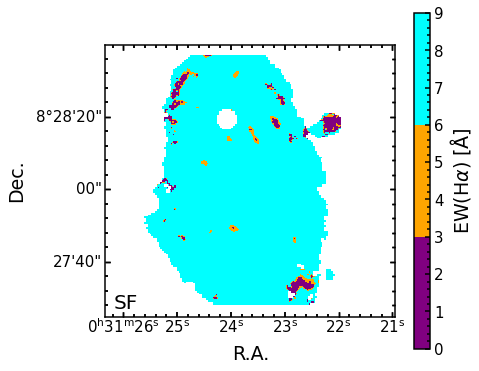

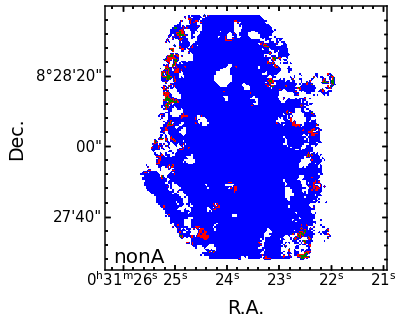


Initializing source 31 of 40: UGC00335NED02


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


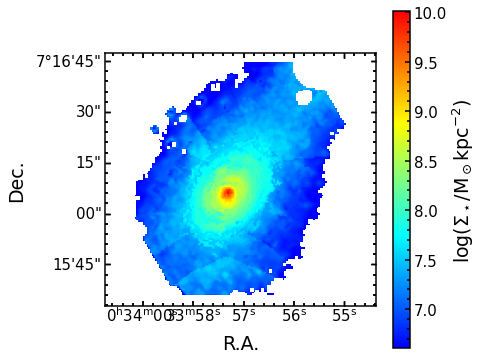

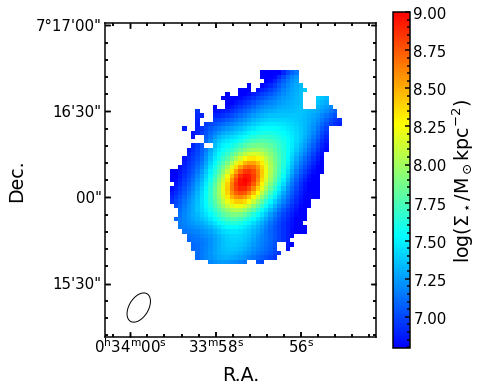

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


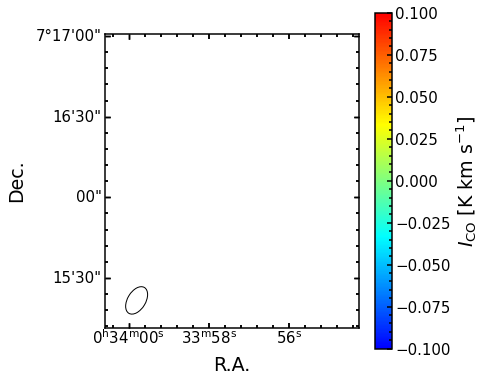

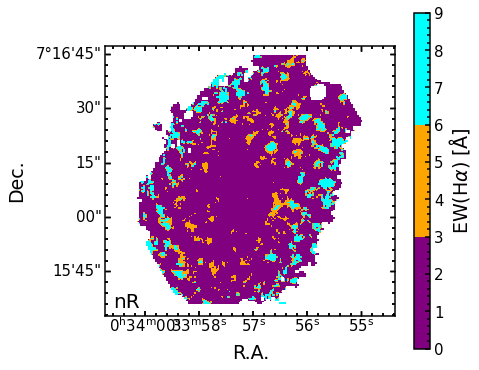

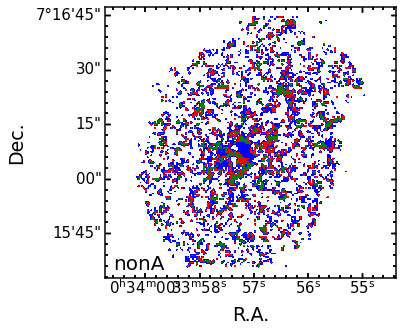


Initializing source 32 of 40: UGC02099


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


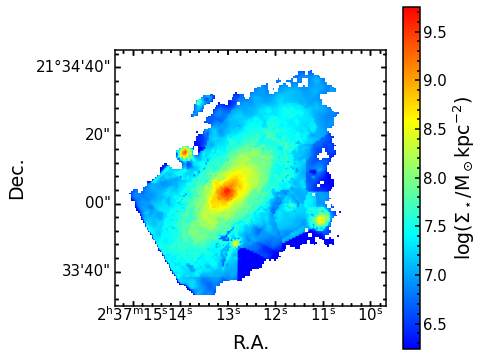

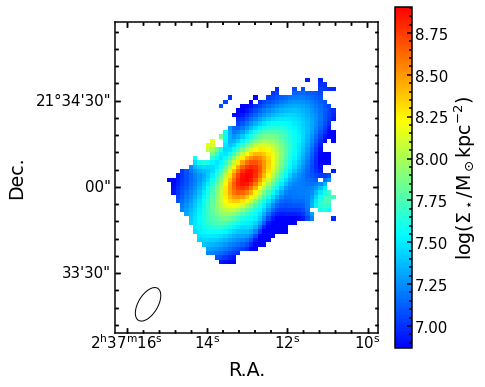

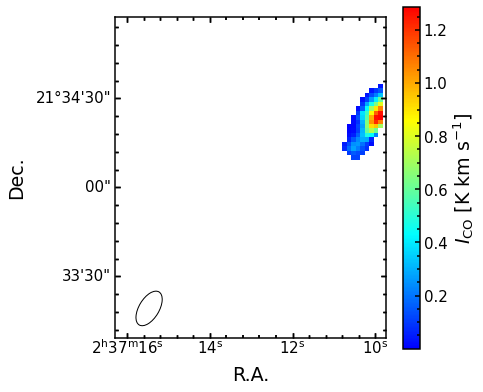

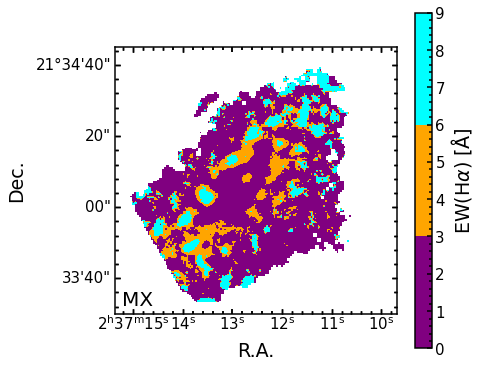

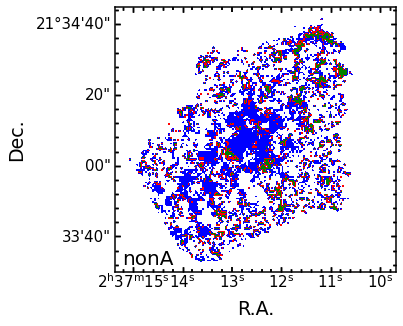


Initializing source 33 of 40: UGC04455


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


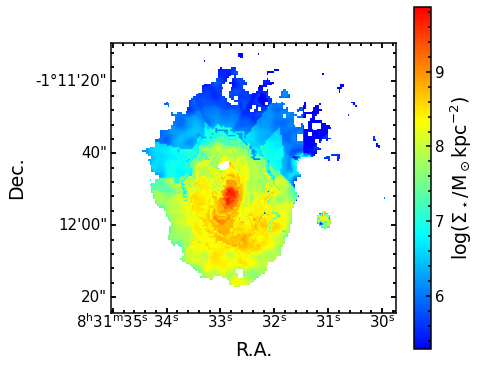

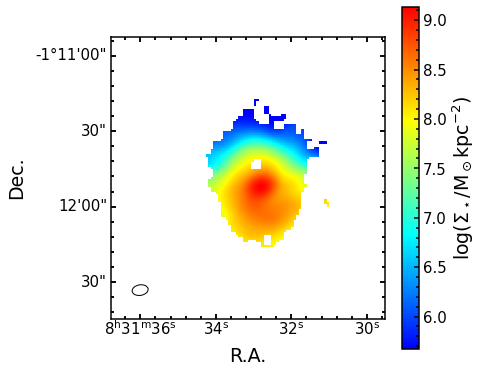

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


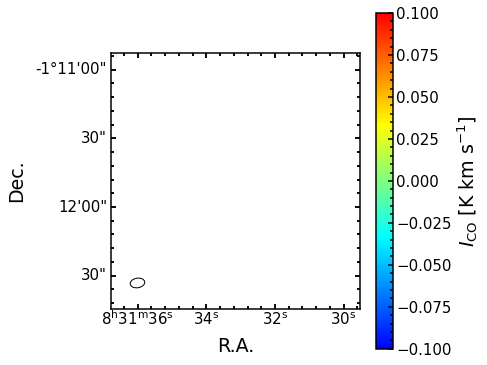

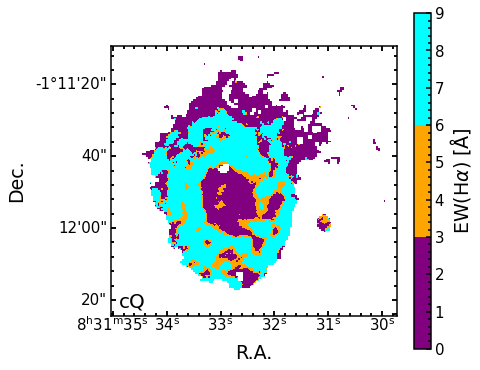

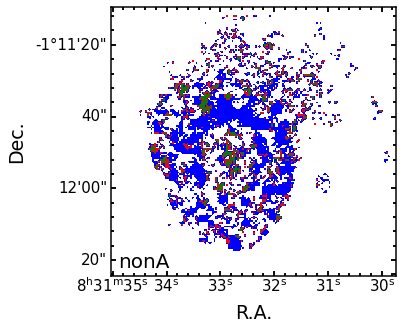


Initializing source 34 of 40: UGC08781


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


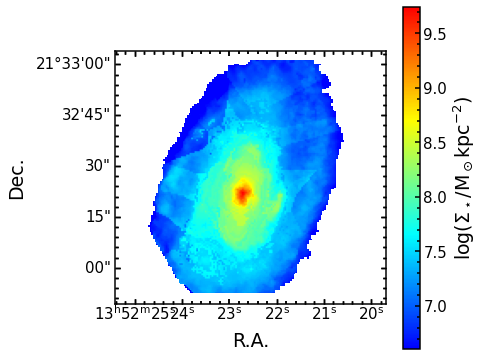

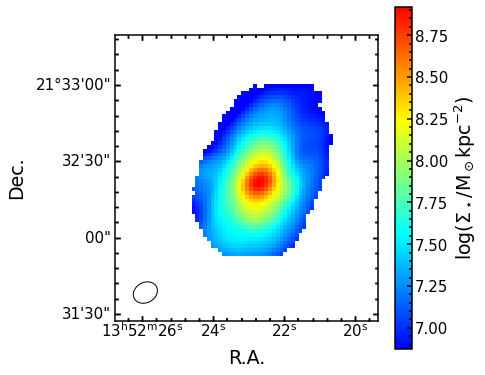

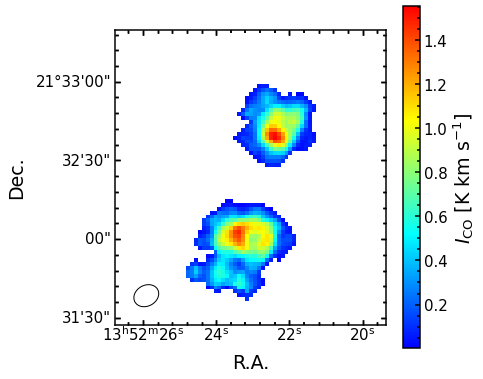

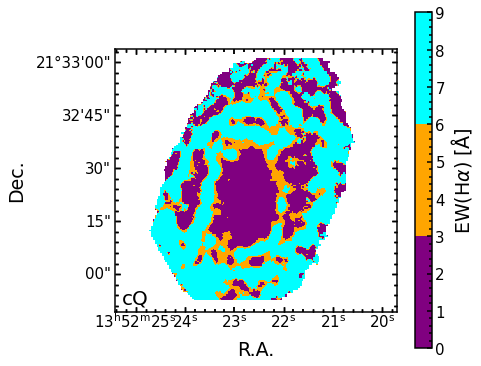

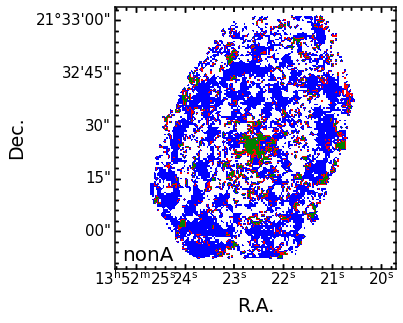


Initializing source 35 of 40: UGC11649


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


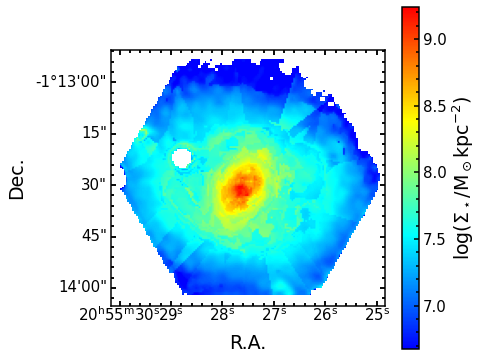

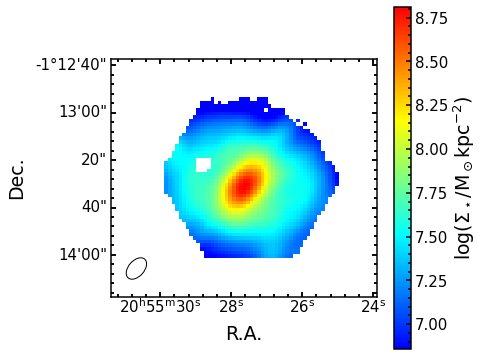

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


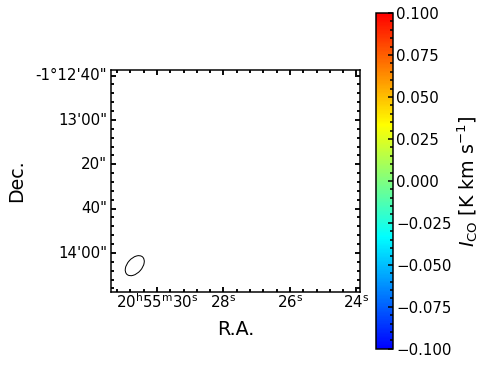

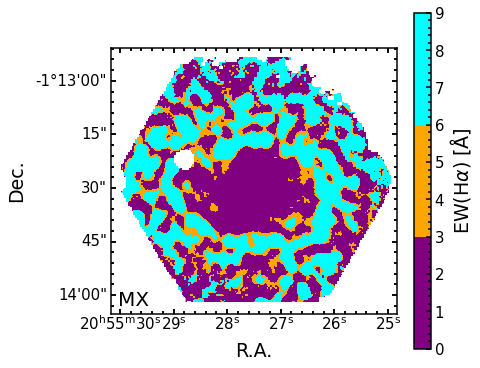

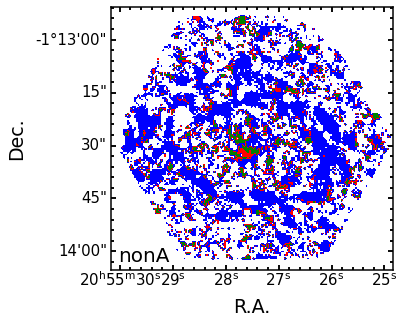


Initializing source 36 of 40: UGC11680NED02


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


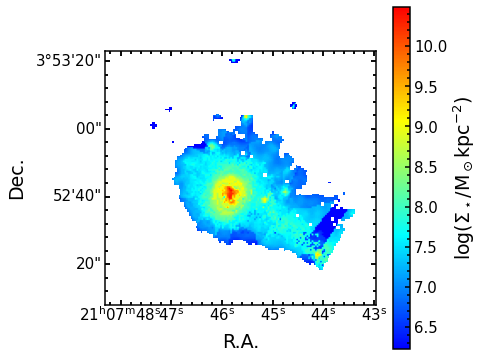

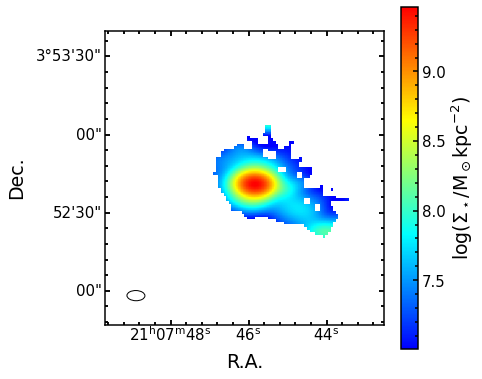

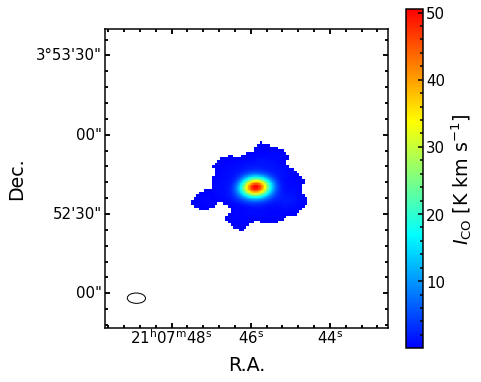

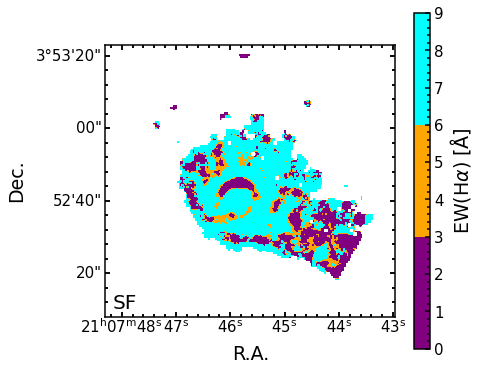

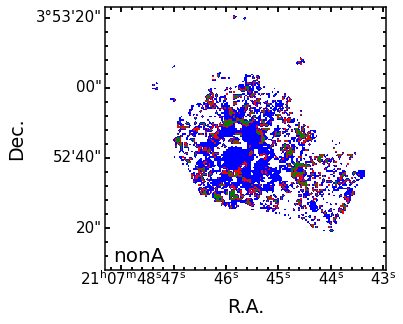


Initializing source 37 of 40: UGC12224


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


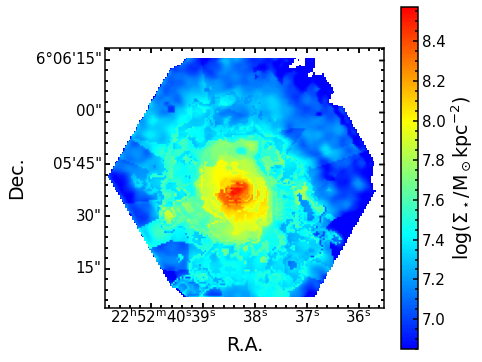

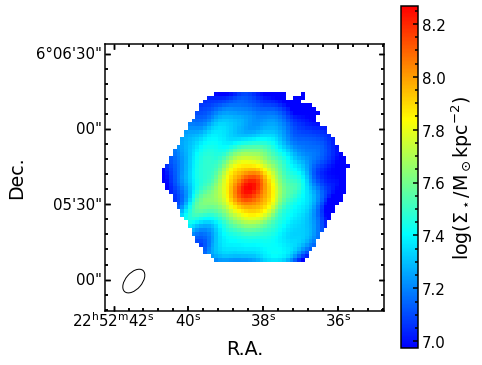

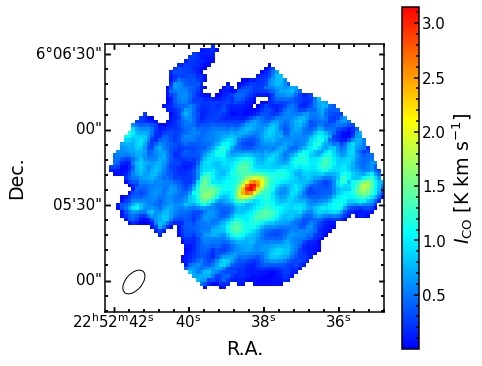

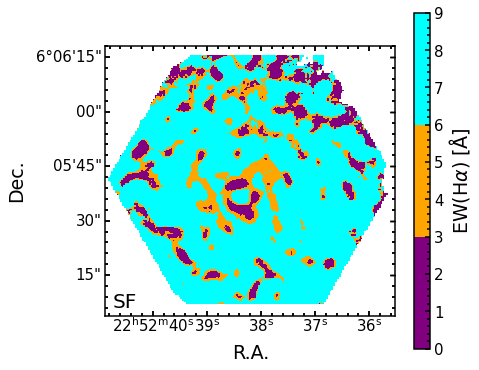

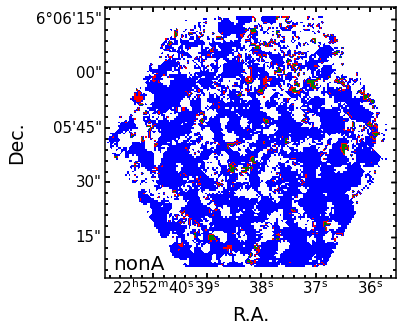


Initializing source 38 of 40: UGC12250


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


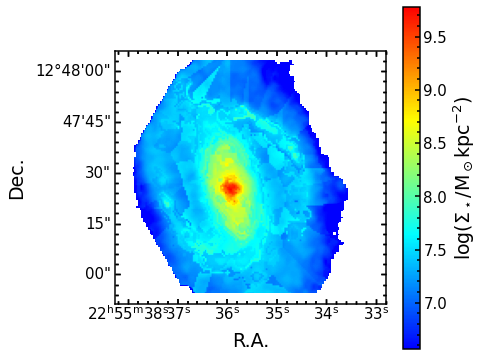

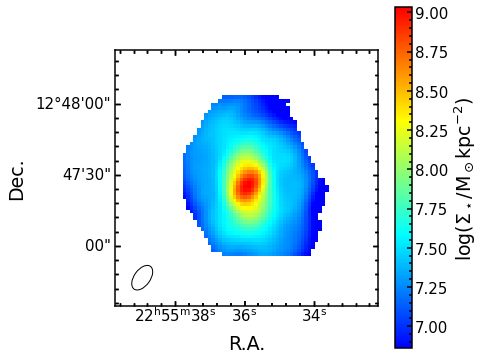

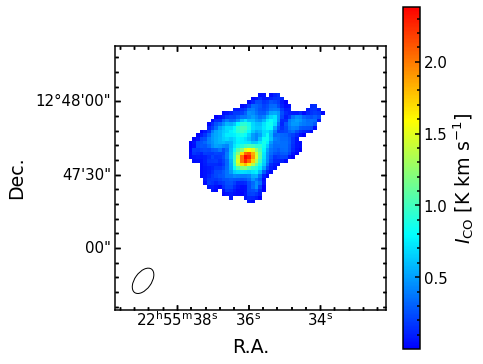

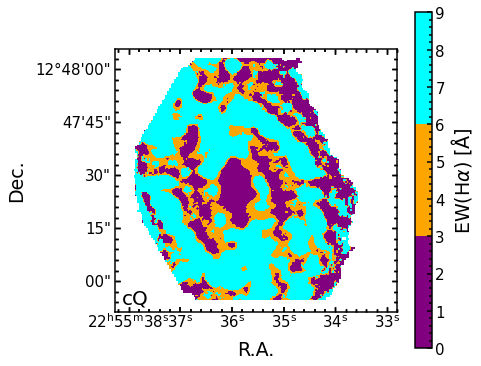

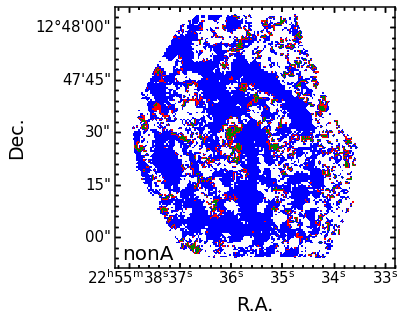


Initializing source 39 of 40: UGC12274


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


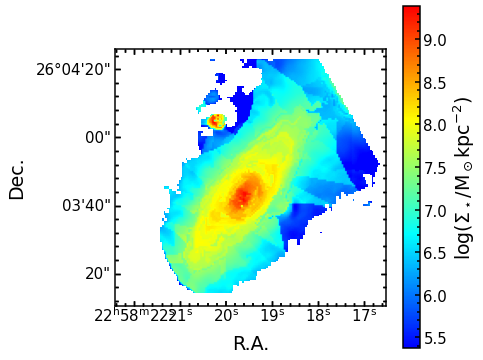

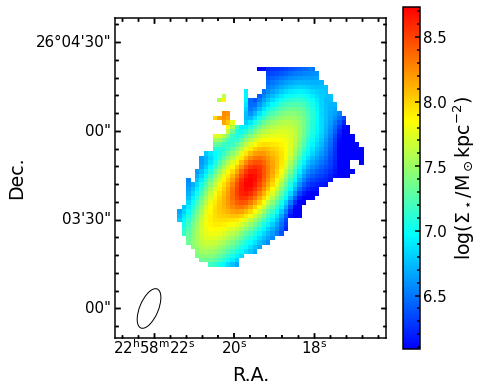

/tmp/ipykernel_1103930/4026804394.py:95: RuntimeWarning: All-NaN slice encountered
  vmin, vmax = (np.nanmin(frame),np.nanmax(frame))


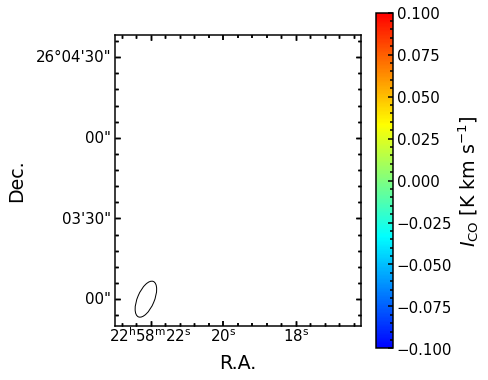

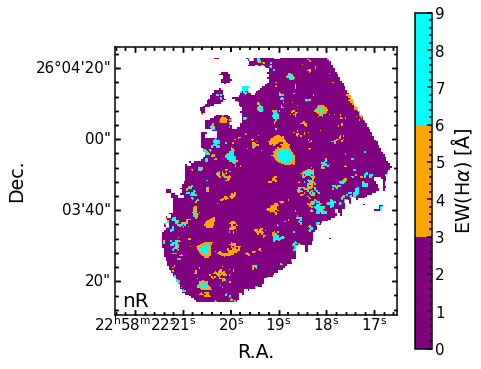

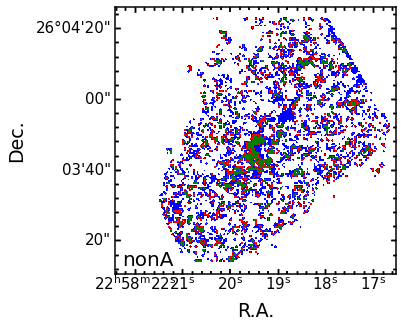


Initializing source 40 of 40: UGC12348


/tmp/ipykernel_1103930/4026804394.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/4026804394.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


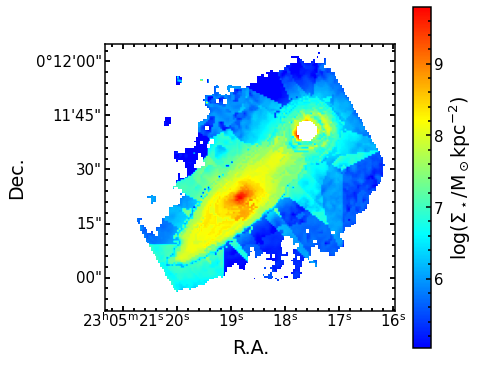

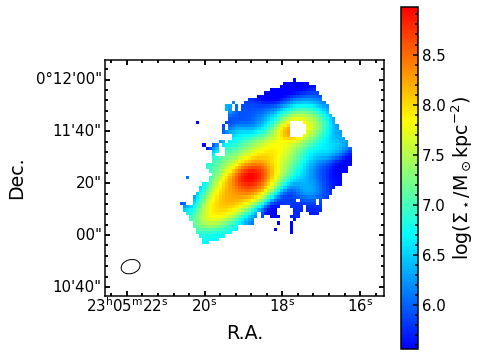

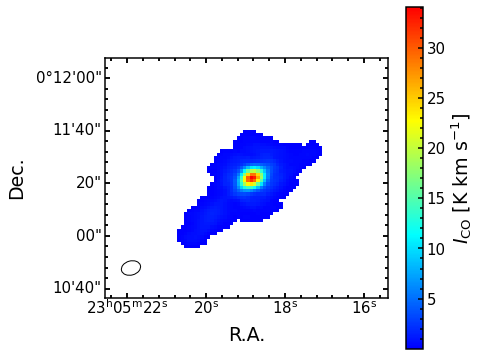

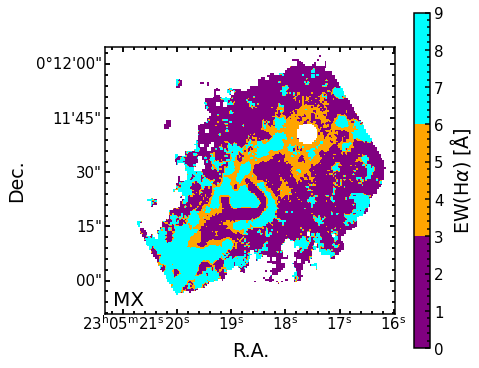

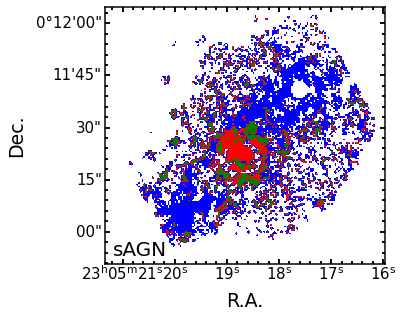

In [39]:
for n,source in enumerate(sources[:]):
    print(f'\nInitializing source {n+1} of {len(sources)}:',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90 # Position angle in degrees
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_ang = cosmo.angular_diameter_distance(z)
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    Ha_EW = get_data(califaoutpath+source+'_HaEW.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0
    
    logratio_NIIHa = np.log10(F_NII/F_Ha)
    logratio_OIIIHb = np.log10(F_OIII/F_Hb)
    maskSF = ((0.61/(logratio_NIIHa-0.47)+1.19)>logratio_OIIIHb)&(logratio_NIIHa<0.47)
    maskSy = (((0.61/(logratio_NIIHa-0.47)+1.19)<=logratio_OIIIHb)|(logratio_NIIHa>=0.47))&(1.01*logratio_NIIHa+0.48<logratio_OIIIHb)
    maskLI = (((0.61/(logratio_NIIHa-0.47)+1.19)<=logratio_OIIIHb)|(logratio_NIIHa>=0.47))&(1.01*logratio_NIIHa+0.48>logratio_OIIIHb)
    BPT_map = np.zeros(Mstar.shape)
    BPT_map[maskSF] = 1.
    BPT_map[maskSy] = 2.
    BPT_map[maskLI] = 3.

    # defining beam properties for convolution
    fwhm_califa = 1.65
    fwhm_aca = 6.
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    #beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    beam_aca = reduced_cube.beam
    
    #flux2SFR = 7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    # 1.6 factor converts from Salpeter IMF to Kroupa IMF:
    #flux2SFR = 1.6*7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    #Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    #Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    #A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    #A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    #A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    #ratio = 5.86/2.5
    #SFR2 = flux2SFR*F_Ha*np.power(10,A_Ha/2.5)
        
    # convolving CALIFA mpas to ACA resolution (error maps squared before convolution)
    #frames_cube = SpectralCube(data=np.array([Mstar,F_Ha,F_Hb,F_NII,F_OIII]),wcs=WCS(califa_hdr3D))
    frames_cube = SpectralCube(data=np.array([Mstar,F_Ha]),wcs=WCS(califa_hdr3D))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)
    frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    
    area_factor = pix_area_aca.value/pix_area_califa.value
    reprojected_list = area_factor*np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    
    #[Mstar_rep,F_Ha_rep,F_Hb_rep,F_NII_rep,F_OIII_rep] = reprojected_list
    [Mstar_rep,F_Ha_rep] = reprojected_list

    S_Mstar     = Mstar *cos/pix_area_califa.value
    S_Mstar_rep = Mstar_rep *cos/pix_area_aca.value
    
    figures = [np.log10(S_Mstar),np.log10(S_Mstar_rep),CO_int]
    #figures = [S_Mstar,S_Mstar_rep,CO_int]
    WCSs = [WCS(califa_hdr),WCS(aca_hdr),WCS(aca_hdr)]
    names = ['SMstar','SMstar_rep','COint']
    labels = ['log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)','log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)',"$I_\mathrm{CO}$ [K km s$^{-1}$]"]
    beams  = [False,True,True]
    dynamics = [True,True,False]
    
    for frame,wcs,name,label,beam,dynamic in zip(figures,WCSs,names,labels,beams,dynamics):
        fig = plt.figure(figsize=(7,6))
        ax = fig.add_subplot(1,1,1,projection=wcs)
        if dynamic:
            vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
        else:
            vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
        im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
        fig.colorbar(im,ax=ax,orientation='vertical',label=label)
        ax.coords['ra'].set_axislabel('R.A.')
        ax.coords['dec'].set_axislabel('Dec.')
        if beam:
            ell = Ellipse(xy=(frame.shape[0]/10,frame.shape[1]/10), width=3000*beam_aca.minor.value, height=3000*beam_aca.major.value, angle=beam_aca.pa.value, color='black')
            ell.set_facecolor('none')
            ax.add_artist(ell)
        fig.tight_layout()
        fig.savefig(figurepath+source+name)
        plt.show()
        plt.close()
    
    fig = plt.figure(figsize=(7,6))
    ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
    im = ax.imshow(Ha_EW, origin='lower',cmap=cmap_EW,vmin=0,vmax=9)
    fig.colorbar(im,ax=ax,orientation='vertical',label=r'EW(H$\alpha$) [$\mathrm{\AA}$]')
    ax.text(Ha_EW.shape[0]/40,Ha_EW.shape[1]/40,QS)
    ax.coords['ra'].set_axislabel('R.A.')
    ax.coords['dec'].set_axislabel('Dec.')
    fig.tight_layout()
    fig.savefig(figurepath+source+'EWmap')
    plt.show()
    plt.close()
    
    fig = plt.figure(figsize=(6,6))
    ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
    ax.imshow(BPT_map,origin='lower',cmap=cmap_BPT,vmin=-0.5,vmax=3.5)
    ax.text(BPT_map.shape[0]/40,BPT_map.shape[1]/40,NA)
    ax.coords['ra'].set_axislabel('R.A.')
    ax.coords['dec'].set_axislabel('Dec.')
    fig.tight_layout()
    fig.savefig(figurepath+source+'BPTmap')
    plt.show()
    plt.close()


Initializing source 1 of 40: CGCG429-012


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


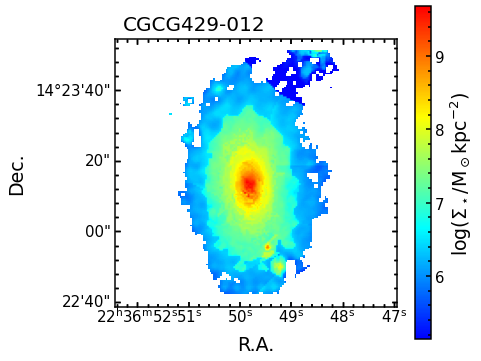


Initializing source 2 of 40: IC1079


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


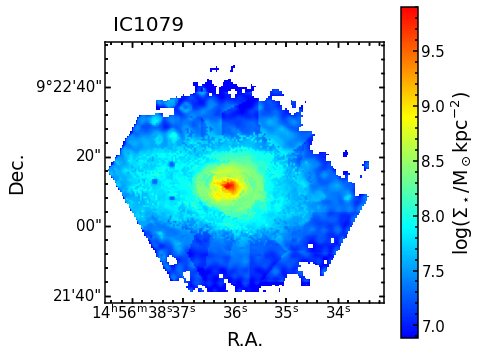


Initializing source 3 of 40: IC1528


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


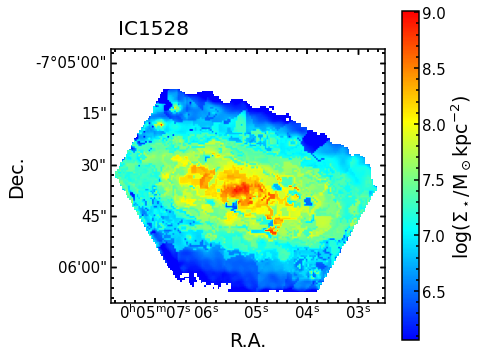


Initializing source 4 of 40: IC2341


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


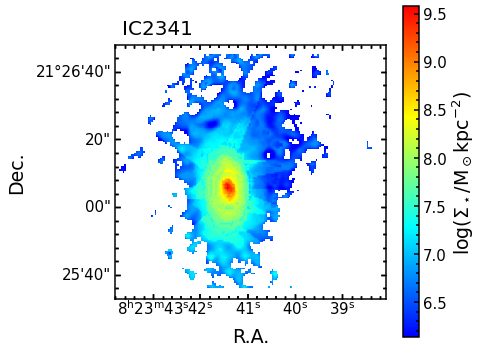


Initializing source 5 of 40: MCG-01-52-012


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


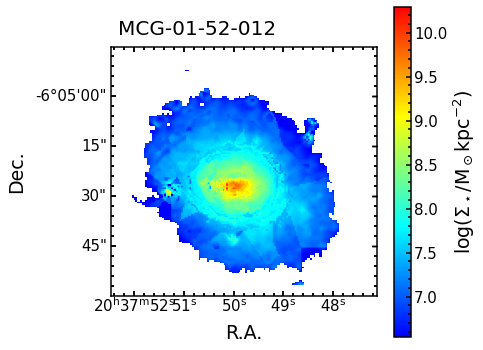


Initializing source 6 of 40: MCG-02-02-030


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


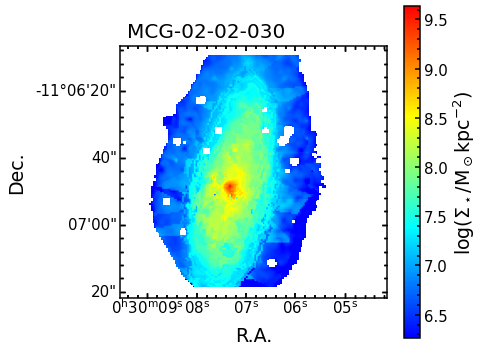


Initializing source 7 of 40: NGC0001


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


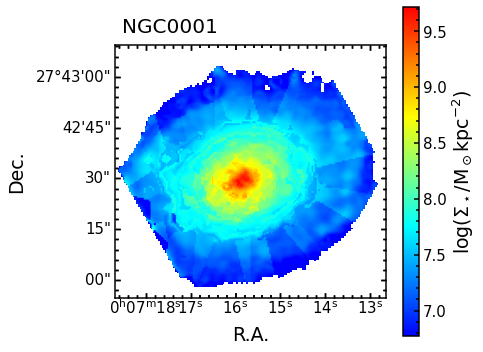


Initializing source 8 of 40: NGC0155


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


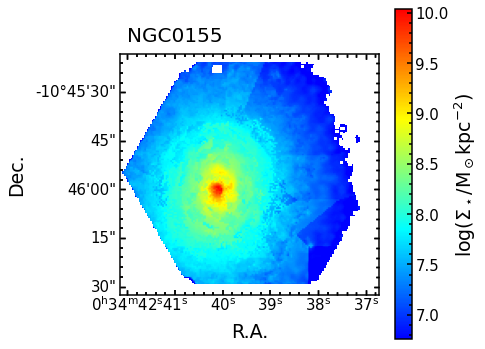


Initializing source 9 of 40: NGC0171


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


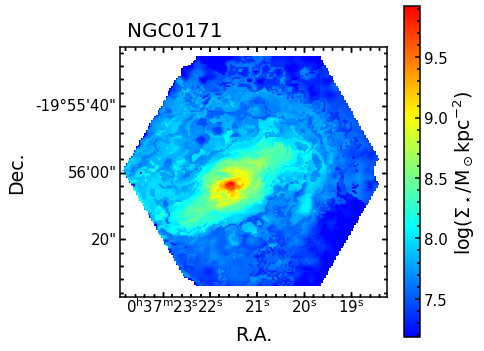


Initializing source 10 of 40: NGC0180


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


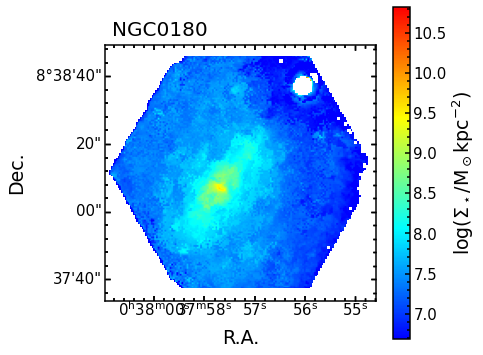


Initializing source 11 of 40: NGC0693


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


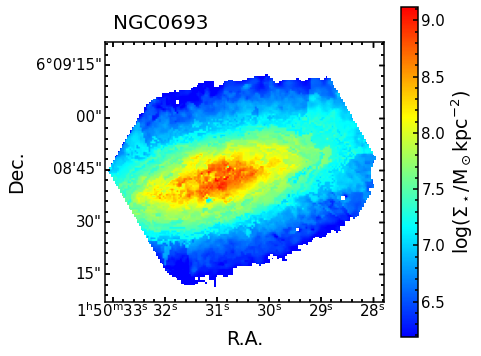


Initializing source 12 of 40: NGC0731


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


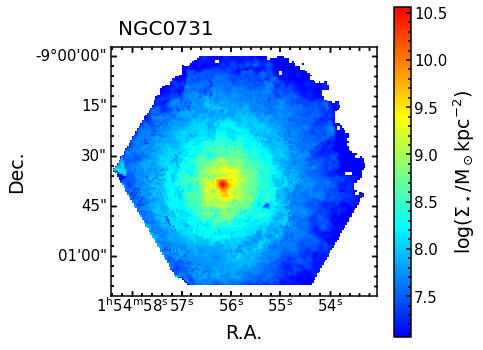


Initializing source 13 of 40: NGC0768


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


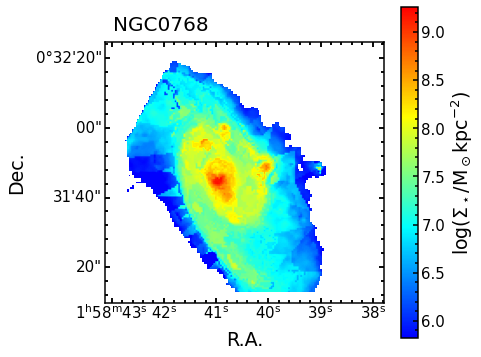


Initializing source 14 of 40: NGC1056


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


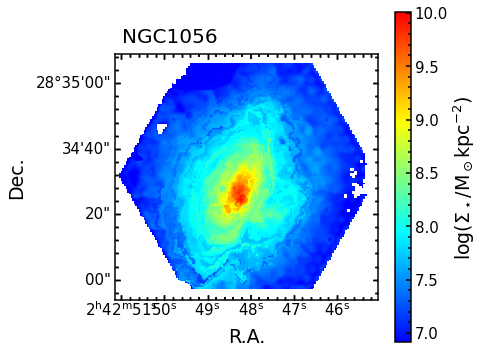


Initializing source 15 of 40: NGC1542


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


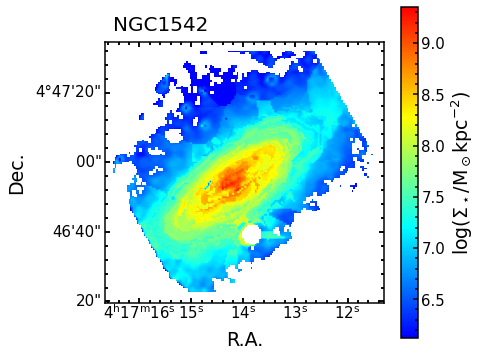


Initializing source 16 of 40: NGC2449


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


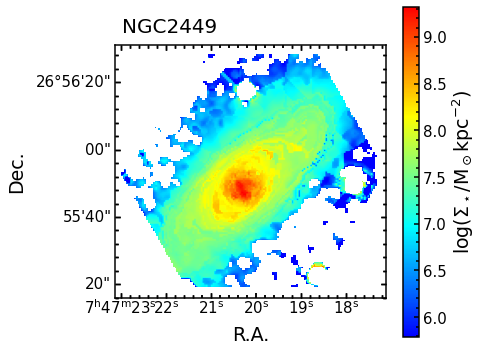


Initializing source 17 of 40: NGC2540


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


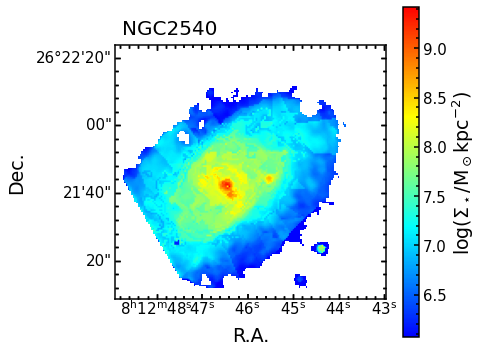


Initializing source 18 of 40: NGC2554


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


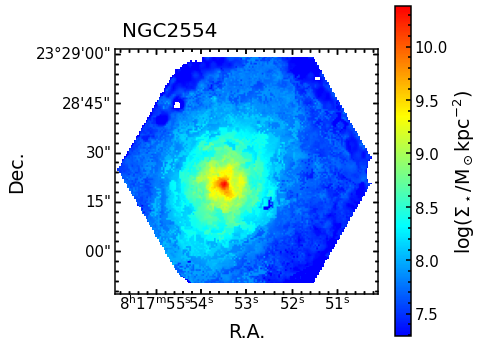


Initializing source 19 of 40: NGC2595


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


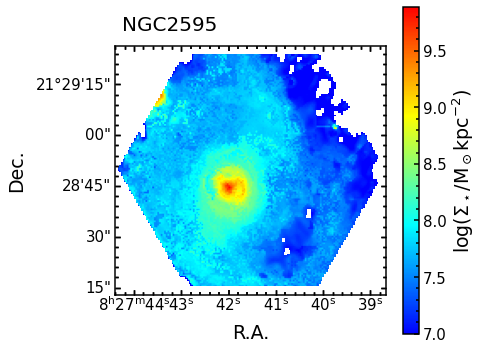


Initializing source 20 of 40: NGC3300


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


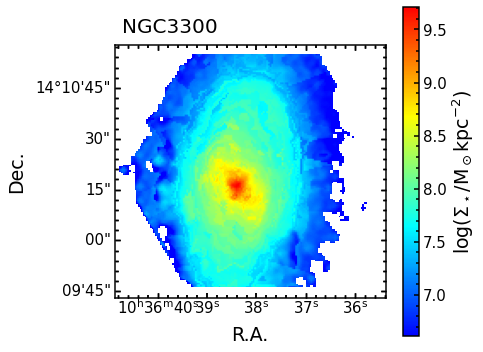


Initializing source 21 of 40: NGC7025


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


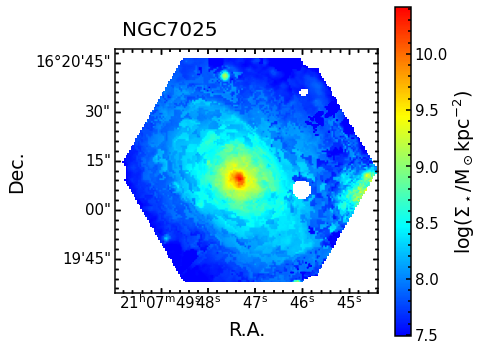


Initializing source 22 of 40: NGC7194


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


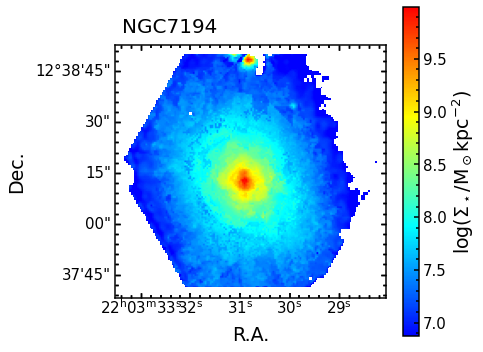


Initializing source 23 of 40: NGC7311


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


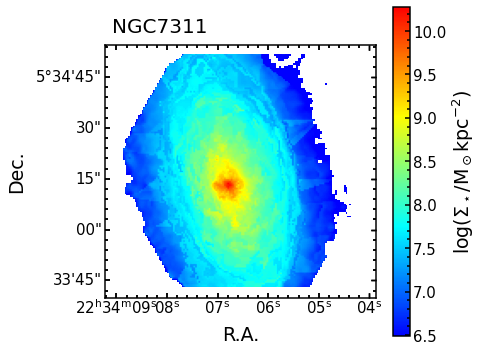


Initializing source 24 of 40: NGC7321


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


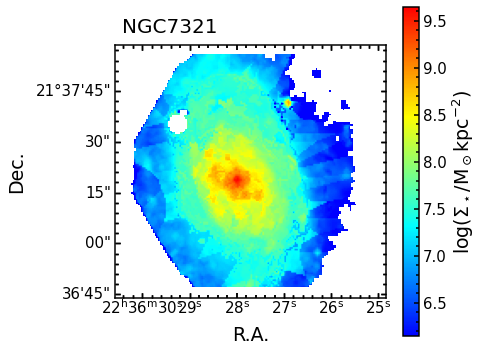


Initializing source 25 of 40: NGC7364


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


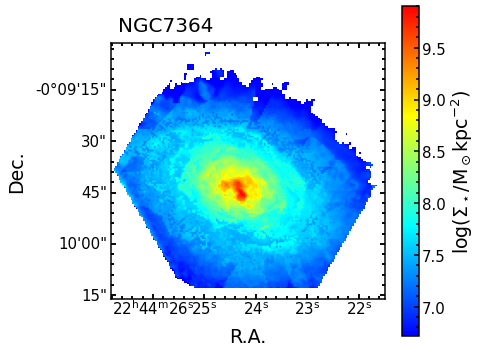


Initializing source 26 of 40: NGC7466


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


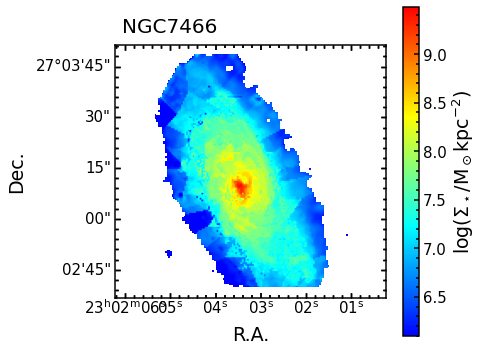


Initializing source 27 of 40: NGC7489


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


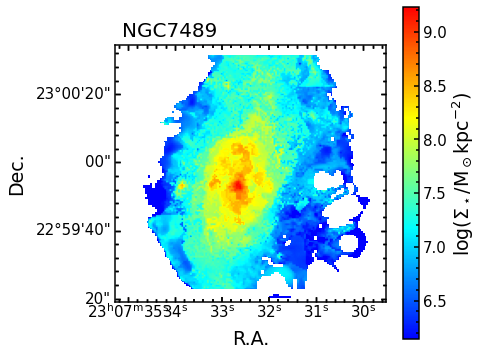


Initializing source 28 of 40: NGC7625


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


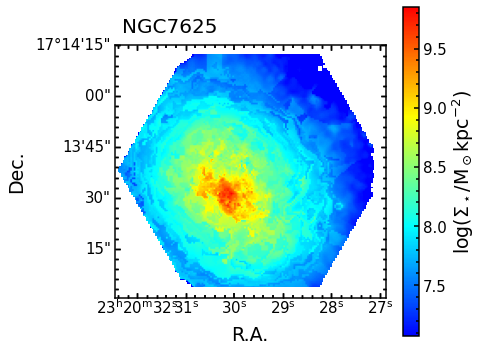


Initializing source 29 of 40: NGC7716


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


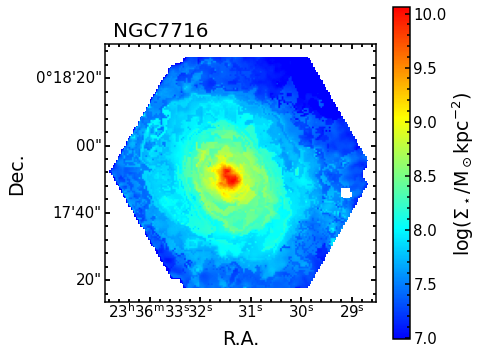


Initializing source 30 of 40: UGC00312


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


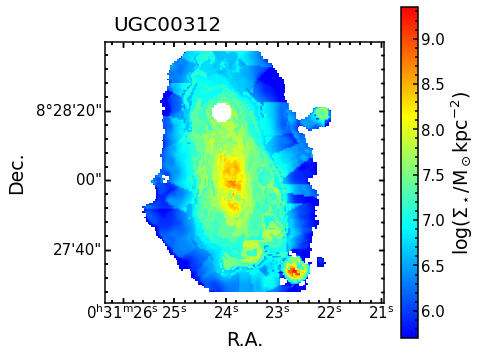


Initializing source 31 of 40: UGC00335NED02


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


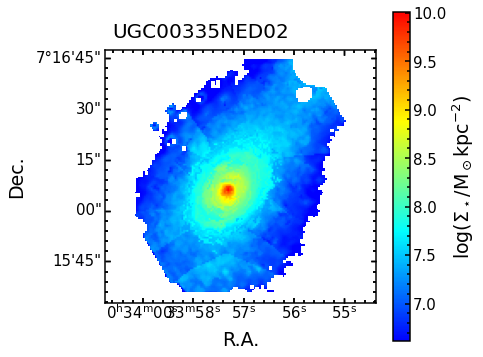


Initializing source 32 of 40: UGC02099


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


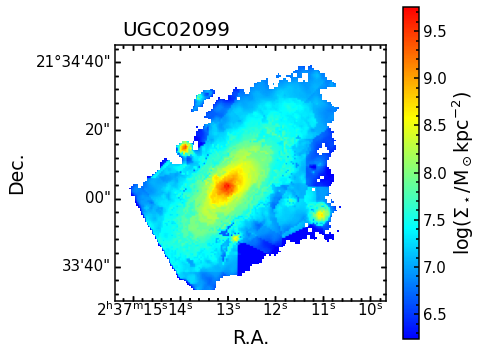


Initializing source 33 of 40: UGC04455


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


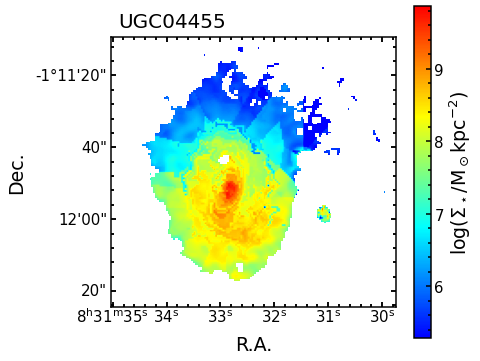


Initializing source 34 of 40: UGC08781


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


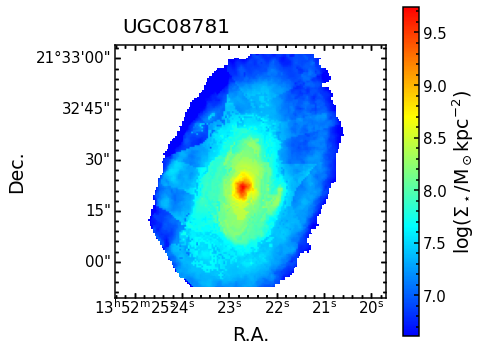


Initializing source 35 of 40: UGC11649


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


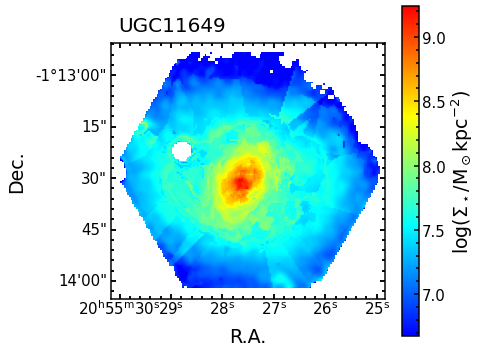


Initializing source 36 of 40: UGC11680NED02


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


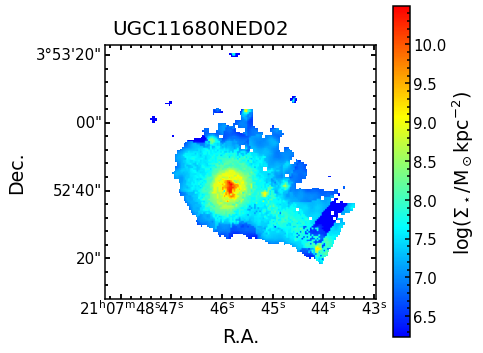


Initializing source 37 of 40: UGC12224


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


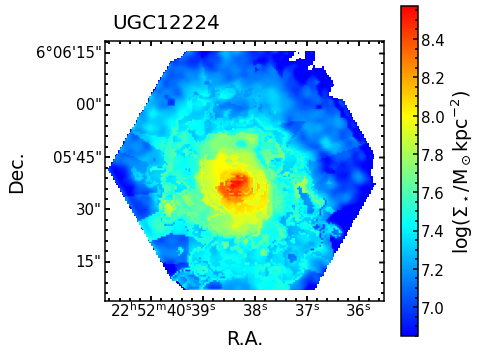


Initializing source 38 of 40: UGC12250


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


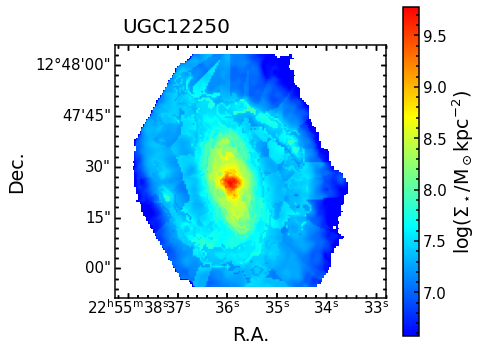


Initializing source 39 of 40: UGC12274


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


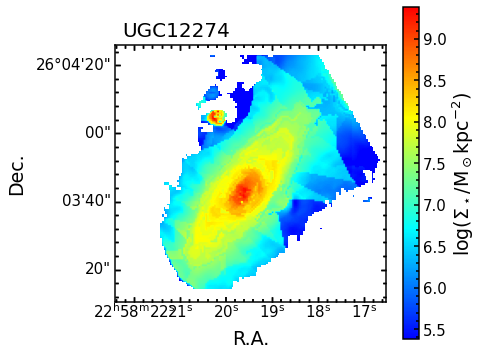


Initializing source 40 of 40: UGC12348


/tmp/ipykernel_1103930/1432321271.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_1103930/1432321271.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)


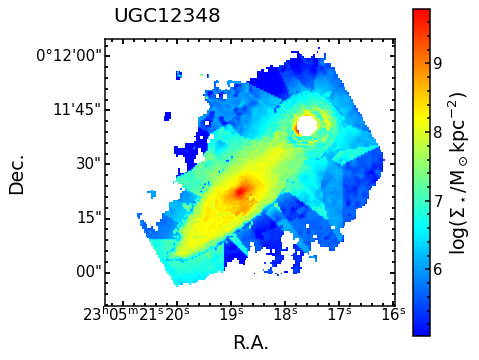

In [55]:
for n,source in enumerate(sources[:]):
    print(f'\nInitializing source {n+1} of {len(sources)}:',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90 # Position angle in degrees
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_ang = cosmo.angular_diameter_distance(z)
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    Ha_EW = get_data(califaoutpath+source+'_HaEW.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0
    
    logratio_NIIHa = np.log10(F_NII/F_Ha)
    logratio_OIIIHb = np.log10(F_OIII/F_Hb)
    maskSF = ((0.61/(logratio_NIIHa-0.47)+1.19)>logratio_OIIIHb)&(logratio_NIIHa<0.47)
    maskSy = (((0.61/(logratio_NIIHa-0.47)+1.19)<=logratio_OIIIHb)|(logratio_NIIHa>=0.47))&(1.01*logratio_NIIHa+0.48<logratio_OIIIHb)
    maskLI = (((0.61/(logratio_NIIHa-0.47)+1.19)<=logratio_OIIIHb)|(logratio_NIIHa>=0.47))&(1.01*logratio_NIIHa+0.48>logratio_OIIIHb)
    BPT_map = np.zeros(Mstar.shape)
    BPT_map[maskSF] = 1.
    BPT_map[maskSy] = 2.
    BPT_map[maskLI] = 3.

    # defining beam properties for convolution
    fwhm_califa = 1.65
    fwhm_aca = 6.
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    #beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    beam_aca = reduced_cube.beam
    
    #flux2SFR = 7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    # 1.6 factor converts from Salpeter IMF to Kroupa IMF:
    #flux2SFR = 1.6*7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    #Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    #Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    #A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    #A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    #A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    #ratio = 5.86/2.5
    #SFR2 = flux2SFR*F_Ha*np.power(10,A_Ha/2.5)
        
    # convolving CALIFA mpas to ACA resolution (error maps squared before convolution)
    #frames_cube = SpectralCube(data=np.array([Mstar,F_Ha,F_Hb,F_NII,F_OIII]),wcs=WCS(califa_hdr3D))
    #frames_cube = SpectralCube(data=np.array([Mstar,F_Ha]),wcs=WCS(califa_hdr3D))
    #frames_cube = frames_cube.with_mask(region)
    #frames_cube = frames_cube.with_beam(beam_califa)
    #frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    #frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    
    #area_factor = pix_area_aca.value/pix_area_califa.value
    #reprojected_list = area_factor*np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    
    #[Mstar_rep,F_Ha_rep,F_Hb_rep,F_NII_rep,F_OIII_rep] = reprojected_list
    #[Mstar_rep,F_Ha_rep] = reprojected_list

    S_Mstar     = Mstar *cos/pix_area_califa.value
    #S_Mstar_rep = Mstar_rep *cos/pix_area_aca.value
    
    #figures = [np.log10(S_Mstar),np.log10(S_Mstar_rep),CO_int]
    #figures = [S_Mstar,S_Mstar_rep,CO_int]
    #WCSs = [WCS(califa_hdr),WCS(aca_hdr),WCS(aca_hdr)]
    #names = ['SMstar','SMstar_rep','COint']
    #labels = ['log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)','log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)',"$I_\mathrm{CO}$ [K km s$^{-1}$]"]
    #beams  = [False,True,True]
    #dynamics = [True,True,False]
    
    frame = np.log10(S_Mstar)
    #for frame,wcs,name,label,beam,dynamic in zip(figures,WCSs,names,labels,beams,dynamics):
    fig = plt.figure(figsize=(7,6))
    ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
    vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
    im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
    fig.colorbar(im,ax=ax,orientation='vertical',label='log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)')
    ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
    ax.coords['ra'].set_axislabel('R.A.')
    ax.coords['dec'].set_axislabel('Dec.')
    fig.tight_layout()
    fig.savefig(figurepath+source+'SMstar')
    plt.show()
    plt.close()
    
    #fig = plt.figure(figsize=(7,6))
    #ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
    #im = ax.imshow(Ha_EW, origin='lower',cmap=cmap_EW,vmin=0,vmax=9)
    #fig.colorbar(im,ax=ax,orientation='vertical',label=r'EW(H$\alpha$) [$\mathrm{\AA}$]')
    #ax.text(Ha_EW.shape[0]/40,Ha_EW.shape[1]/40,QS)
    #ax.coords['ra'].set_axislabel('R.A.')
    #ax.coords['dec'].set_axislabel('Dec.')
    #fig.tight_layout()
    #fig.savefig(figurepath+source+'EWmap')
    #plt.show()
    #plt.close()
    
    #fig = plt.figure(figsize=(6,6))
    #ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
    #ax.imshow(BPT_map,origin='lower',cmap=cmap_BPT,vmin=-0.5,vmax=3.5)
    #ax.text(BPT_map.shape[0]/40,BPT_map.shape[1]/40,NA)
    #ax.coords['ra'].set_axislabel('R.A.')
    #ax.coords['dec'].set_axislabel('Dec.')
    #fig.tight_layout()
    #fig.savefig(figurepath+source+'BPTmap')
    #plt.show()
    #plt.close()


Initializing source 1 of 40: UGC12224


/tmp/ipykernel_917951/2803212593.py:34: RuntimeWarning: invalid value encountered in log10
  logratio_NIIHa = np.log10(F_NII/F_Ha)
/tmp/ipykernel_917951/2803212593.py:35: RuntimeWarning: invalid value encountered in log10
  logratio_OIIIHb = np.log10(F_OIII/F_Hb)
/tmp/ipykernel_917951/2803212593.py:83: RuntimeWarning: invalid value encountered in power
  Z_O3N2_rep = (10**(-12+8.533)*(F_OIII_rep*F_Ha_rep/(F_Hb_rep*F_NII_rep))**-0.214)/Z_sun
/tmp/ipykernel_917951/2803212593.py:84: RuntimeWarning: invalid value encountered in power
  Z_N2_rep   = (10**(-12+8.743)*(F_NII_rep/F_Ha_rep)**+0.462)/Z_sun
/tmp/ipykernel_917951/2803212593.py:94: RuntimeWarning: invalid value encountered in log10
  figures = [np.log10(F_Ha),np.log10(frames_cube_convolved[1]),np.log10(F_Ha_rep)]


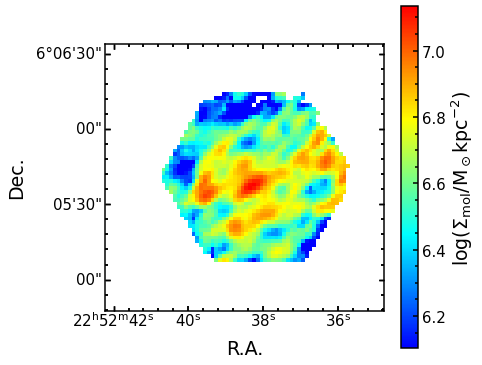

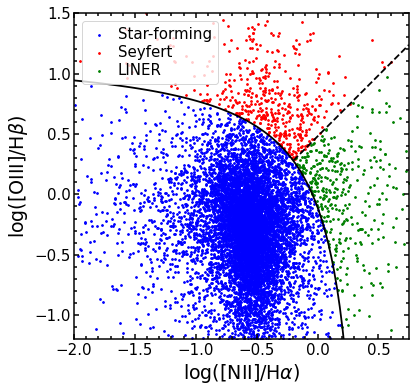

In [17]:
for n,source in enumerate(['UGC12224']):
    print(f'\nInitializing source {n+1} of {len(sources)}:',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90 # Position angle in degrees
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_ang = cosmo.angular_diameter_distance(z)
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    Ha_EW = get_data(califaoutpath+source+'_HaEW.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0
    
    logratio_NIIHa = np.log10(F_NII/F_Ha)
    logratio_OIIIHb = np.log10(F_OIII/F_Hb)
    maskSF = ((0.61/(logratio_NIIHa-0.47)+1.19)>logratio_OIIIHb)&(logratio_NIIHa<0.47)
    maskSy = (((0.61/(logratio_NIIHa-0.47)+1.19)<=logratio_OIIIHb)|(logratio_NIIHa>=0.47))&(1.01*logratio_NIIHa+0.48<logratio_OIIIHb)
    maskLI = (((0.61/(logratio_NIIHa-0.47)+1.19)<=logratio_OIIIHb)|(logratio_NIIHa>=0.47))&(1.01*logratio_NIIHa+0.48>logratio_OIIIHb)
    BPT_map = np.zeros(Mstar.shape)
    BPT_map[maskSF] = 1.
    BPT_map[maskSy] = 2.
    BPT_map[maskLI] = 3.

    # defining beam properties for convolution
    fwhm_califa = 1.65
    fwhm_aca = 6.
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    #beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    beam_aca = reduced_cube.beam
    
    #flux2SFR = 7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    # 1.6 factor converts from Salpeter IMF to Kroupa IMF:
    #flux2SFR = 1.6*7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    #Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    #Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    #A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    #A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    #A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    #ratio = 5.86/2.5
    #SFR2 = flux2SFR*F_Ha*np.power(10,A_Ha/2.5)
        
    # convolving CALIFA mpas to ACA resolution (error maps squared before convolution)
    frames_cube = SpectralCube(data=np.array([Mstar,F_Ha,F_Hb,F_NII,F_OIII]),wcs=WCS(califa_hdr3D))
    #frames_cube = SpectralCube(data=np.array([Mstar,F_Ha]),wcs=WCS(califa_hdr3D))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)
    frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    
    area_factor = pix_area_aca.value/pix_area_califa.value
    reprojected_list = area_factor*np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    
    [Mstar_rep,F_Ha_rep,F_Hb_rep,F_NII_rep,F_OIII_rep] = reprojected_list
    #[Mstar_rep,F_Ha_rep] = reprojected_list

    S_Mstar     = Mstar *cos/pix_area_califa.value
    S_Mstar_conv = frames_cube_convolved[0]*cos/pix_area_califa.value
    S_Mstar_rep = Mstar_rep *cos/pix_area_aca.value
    
    Z_sun = 4.9*10**-4 # solar metallicity, Baumgartner & Mushotzky 2006
    Z_O3N2_rep = (10**(-12+8.533)*(F_OIII_rep*F_Ha_rep/(F_Hb_rep*F_NII_rep))**-0.214)/Z_sun
    Z_N2_rep   = (10**(-12+8.743)*(F_NII_rep/F_Ha_rep)**+0.462)/Z_sun
    # from Bolatto et al. 2013
    S_GMC = 1
    # using 10^8 instead of 100 because S_Mstar is in M_sun kpc^-2 instead of M_sun pc^-2
    alphaCO_O3N2_rep = 2.9*np.exp(0.4/(S_GMC*Z_O3N2_rep))*np.power(S_Mstar_rep/10**8,np.where(S_Mstar_rep>10**8,-0.5,0))
    alphaCO_N2_rep   = 2.9*np.exp(0.4/(S_GMC*Z_N2_rep))*np.power(S_Mstar_rep/10**8,np.where(S_Mstar_rep>10**8,-0.5,0))

    R_21=0.65
    Smol = CO_int*cos*alphaCO_O3N2_rep*10**6/R_21
    
    figures = [np.log10(F_Ha),np.log10(frames_cube_convolved[1]),np.log10(F_Ha_rep)]
    #figures = [np.log10(S_Mstar),np.log10(S_Mstar_conv),np.log10(S_Mstar_rep)]
    #figures = [S_Mstar,S_Mstar_rep,CO_int]
    WCSs = [WCS(califa_hdr),WCS(califa_hdr),WCS(aca_hdr)]
    names = ['SMstar','SMstar_conv','SMstar_rep']
    labels = [r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)',r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)',r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)']
    beams  = [False,True,True]
    dynamics = [True,True,True]
    tosave = [False,False,False]
    
    
    #for frame,wcs,name,label,beam,dynamic,save in zip(figures,WCSs,names,labels,beams,dynamics,tosave):
    #    fig = plt.figure(figsize=(7,6))
    #    ax = fig.add_subplot(1,1,1,projection=wcs)
    #    if dynamic:
    #        vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
    #    else:
     #       vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
    #    im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
    #    fig.colorbar(im,ax=ax,orientation='vertical',label=label)
    #    ax.text(frame.shape[0]/40,frame.shape[1]*34/40,source)
    #    ax.coords['ra'].set_axislabel('R.A.')
    #    ax.coords['dec'].set_axislabel('Dec.')
    #    if beam:
    #        ell = Ellipse(xy=(frame.shape[0]/10,frame.shape[1]/10), width=7500*beam_aca.minor.value, height=7500*beam_aca.major.value, angle=beam_aca.pa.value, color='black')
    #        ell.set_facecolor('none')
    #        ax.add_artist(ell)
    #    fig.tight_layout()
    #    if save:
    #        fig.savefig(figurepath+source+name)
    #    plt.show()
    #    plt.close()

    #for frame,wcs,name,label,beam,dynamic,save in zip(figures,WCSs,names,labels,beams,dynamics,tosave):
    fig = plt.figure(figsize=(7,6))
    ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
    #    if dynamic:
    vmin, vmax = (np.nanpercentile(np.log10(Smol),5),np.nanmax(np.log10(Smol)))#np.nanpercentile(frame,95))
    #    else:
     #       vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
    im = ax.imshow(np.log10(Smol), origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
    fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{mol}$/M$_\odot$kpc$^{-2}$)')
    #    ax.text(frame.shape[0]/40,frame.shape[1]*34/40,source)
    ax.coords['ra'].set_axislabel('R.A.')
    ax.coords['dec'].set_axislabel('Dec.')
    #    if beam:
    #        ell = Ellipse(xy=(frame.shape[0]/10,frame.shape[1]/10), width=7500*beam_aca.minor.value, height=7500*beam_aca.major.value, angle=beam_aca.pa.value, color='black')
    #        ell.set_facecolor('none')
    #        ax.add_artist(ell)
    fig.tight_layout()
    #    if save:
    fig.savefig(figurepath+source+'_Smol')
    fig.savefig(colloquiumpath+source+'_Smol.png')
    plt.show()
    plt.close()
    
    xNII = [np.linspace(-2,0.25,100),np.linspace(-0.19935,0.25+0.5,10)]
    yNII = [0.61/(xNII[0]-0.47) + 1.19,1.01*xNII[1]+0.48]
    fig, ax = plt.subplots(1,1,figsize=(6,6))
    ax.plot(xNII[0],yNII[0],c='k')
    ax.plot(xNII[1],yNII[1],c='k',ls='--')
    ax.scatter(logratio_NIIHa[maskSF],logratio_OIIIHb[maskSF],c='b',s=3.,label='Star-forming')
    ax.scatter(logratio_NIIHa[maskSy],logratio_OIIIHb[maskSy],c='r',s=3.,label='Seyfert')
    ax.scatter(logratio_NIIHa[maskLI],logratio_OIIIHb[maskLI],c='g',s=3.,label='LINER')
    ax.set_xlabel(r'log([NII]/H$\alpha$)')
    ax.set_ylabel(r'log([OIII]/H$\beta$)')
    ax.set_xlim(xNII[0][0],xNII[0][-1]+0.5)
    ax.set_ylim(-1.2,1.5)
    ax.legend(loc='upper left')
    #fig.tight_layout()
    #fig.savefig(figurepath+source+'BPTdiag')
    plt.show()
    plt.close()
    
    #fig = plt.figure(figsize=(6,6))
    #ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
    #ax.imshow(BPT_map,origin='lower',cmap=cmap_BPT,vmin=-0.5,vmax=3.5)
    #ax.text(BPT_map.shape[0]/40,BPT_map.shape[1]/40,NA)
    #ax.coords['ra'].set_axislabel('R.A.')
    #ax.coords['dec'].set_axislabel('Dec.')
    #fig.tight_layout()
    #fig.savefig(figurepath+source+'BPTmap')
    #plt.show()
    #plt.close()

In [11]:
for n,source in enumerate(['UGC12224']):
    print(f'\nInitializing source :',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90 # Position angle in degrees
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_ang = cosmo.angular_diameter_distance(z)
    D_lum = cosmo.luminosity_distance(z)
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    eF_Hb = get_data(califaoutpath+source+'_eF_Hb.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    Ha_EW = get_data(califaoutpath+source+'_HaEW.fits')
    D4000 = get_data(califaoutpath+source+'_D4000.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0

    # defining beam properties for convolution
    fwhm_califa = 1.65
    fwhm_aca = 6.
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    #beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    beam_aca = reduced_cube.beam
    
    flux2SFR = 7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    # 1.6 factor converts from Salpeter IMF to Kroupa IMF:
    #flux2SFR = 1.6*7.9*(10**-(42+16))*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    ratio = 5.86/2.5
    SFR2 = flux2SFR*F_Ha*np.power(10,A_Ha/2.5)
        
    # convolving CALIFA mpas to ACA resolution (error maps squared before convolution)
    frames_cube = SpectralCube(data=np.array([Mstar,F_Ha,F_Hb,F_NII,F_OIII]),wcs=WCS(califa_hdr3D))
    #frames_cube = SpectralCube(data=np.array([Mstar,F_Ha]),wcs=WCS(califa_hdr3D))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)
    frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    
    area_factor = pix_area_aca.value/pix_area_califa.value
    reprojected_list = area_factor*np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    
    [Mstar_rep,F_Ha_rep,F_Hb_rep,F_NII_rep,F_OIII_rep] = reprojected_list

    Ha_to_Hb_rep = np.where(F_Ha_rep/F_Hb_rep>2.86,F_Ha_rep/F_Hb_rep,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb_rep = np.where(F_Ha_rep>0,Ha_to_Hb_rep,np.nan)
    # from Villanueva et al. 2023
    Ha_to_Hb_median_rep = np.nanmedian(Ha_to_Hb_rep[(Ha_to_Hb_rep>2.86)])
    Ha_to_Hb_rep = np.where(np.isnan(F_Hb_rep)&(F_Ha_rep>0),Ha_to_Hb_median_rep,Ha_to_Hb_rep)
    #A_Ha_rep = 5.86*np.log10(Ha_to_Hb_rep/2.86)
    #SFR_rep = flux2SFR*F_Ha_rep*np.power(10,A_Ha_rep/2.5)
    ratio = 5.86/2.5
    SFR_rep = flux2SFR*np.where(Ha_to_Hb_rep>2.86,(2.86**-ratio)*np.power(Ha_to_Hb_rep,ratio)*F_Ha_rep,F_Ha_rep)

    S_Mstar      = Mstar*cos/pix_area_califa.value
    S_SFR        = SFR2  *cos/pix_area_califa.value
    S_Mstar_conv = frames_cube_convolved[0]*cos/pix_area_califa.value
    S_Mstar_rep  = Mstar_rep*cos/pix_area_aca.value
    S_SFR_rep    = SFR_rep  *cos/pix_area_aca.value
    
    


Initializing source : UGC12224


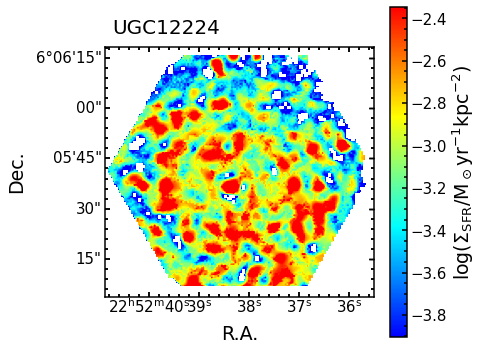

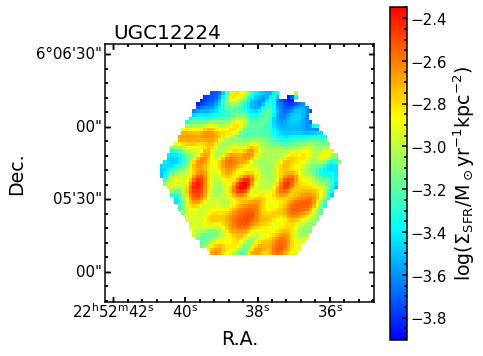

In [15]:
source = 'UGC12224'
vmin = np.nanpercentile(np.log10(S_SFR),5)
vmax = np.nanmax(np.log10(S_SFR_rep))

frame = np.log10(S_SFR)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'_SSFR')
#fig.savefig(colloquiumpath+source+'_SSFR.png')
plt.show()
plt.close()

frame = np.log10(S_SFR_rep)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'_SSFR_rep')
#fig.savefig(colloquiumpath+source+'_SSFR_rep.png')
plt.show()
plt.close()

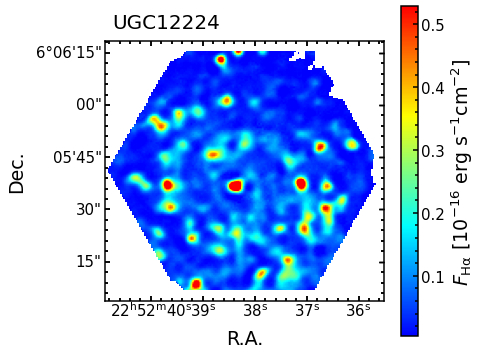

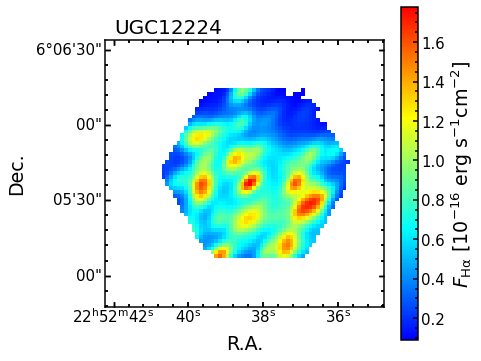

In [25]:
source = 'UGC12224'
vmin = np.nanpercentile(F_Ha,5)
#vmax = np.nanmax(F_Ha)
vmax = np.nanpercentile(F_Ha,99.5)
#vmin = np.nanmin(F_Ha_rep)
#vmax = np.nanmax(F_Ha_rep)

frame = F_Ha
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'$F_\mathrm{H\alpha}$ [10$^{-16}$ erg s$^{-1}$cm$^{-2}$]')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'_FHa')
fig.savefig(colloquiumpath+source+'_FHa.png')
plt.show()
plt.close()

frame = F_Ha_rep
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow)#,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'$F_\mathrm{H\alpha}$ [10$^{-16}$ erg s$^{-1}$cm$^{-2}$]')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'_FHa_rep')
fig.savefig(colloquiumpath+source+'_FHa_rep.png')
plt.show()
plt.close()

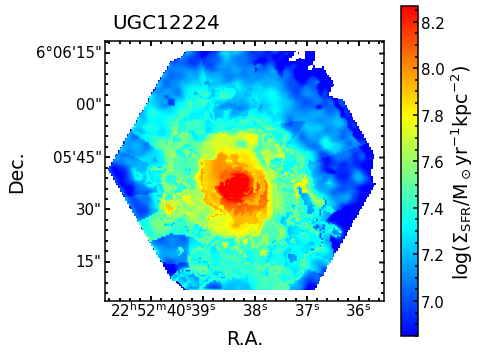

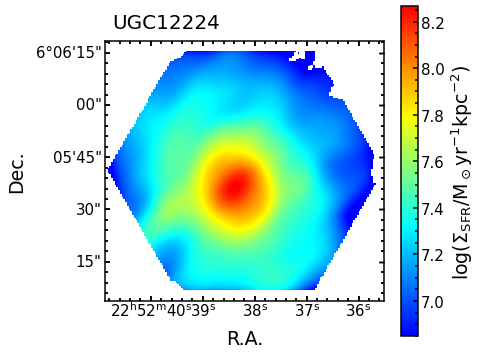

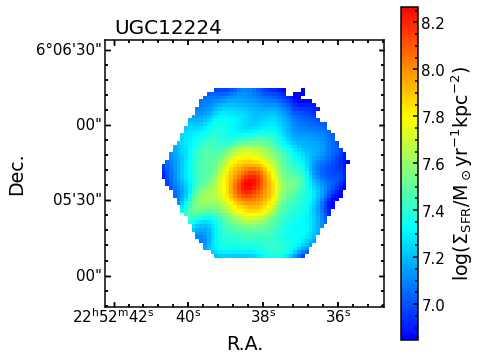

In [12]:
source = 'UGC12224'
vmin = np.nanpercentile(np.log10(S_Mstar),5)
vmax = np.nanmax(np.log10(S_Mstar_rep))

frame = np.log10(S_Mstar)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'SMstar')
#fig.savefig(colloquiumpath+source+'SMstar.png')
plt.show()
plt.close()

frame = np.log10(S_Mstar_conv)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
fig.savefig(figurepath+source+'SMstar_conv')
fig.savefig(colloquiumpath+source+'SMstar_conv.png')
plt.show()
plt.close()

frame = np.log10(S_Mstar_rep)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'SMstar_rep')
#fig.savefig(colloquiumpath+source+'SMstar_rep.png')
plt.show()
plt.close()

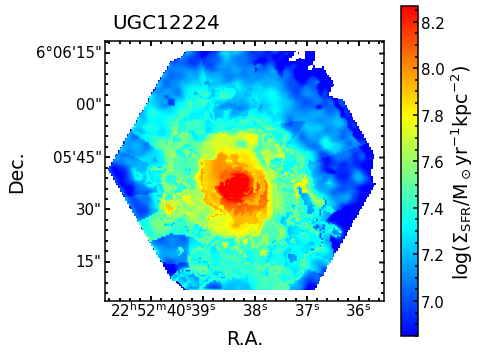

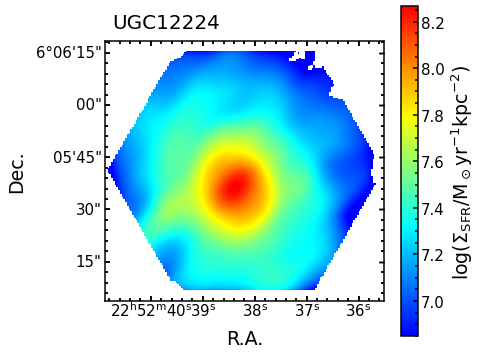

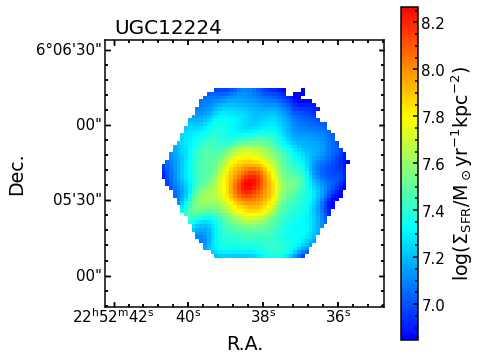

In [ ]:
source = 'UGC12224'
vmin = np.nanpercentile(np.log10(S_Mstar),5)
vmax = np.nanmax(np.log10(S_Mstar_rep))

frame = np.log10(S_Mstar)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'SMstar')
#fig.savefig(colloquiumpath+source+'SMstar.png')
plt.show()
plt.close()

frame = np.log10(S_Mstar_conv)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'SMstar_conv')
#fig.savefig(colloquiumpath+source+'SMstar_conv.png')
plt.show()
plt.close()

frame = np.log10(S_Mstar_rep)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+'SMstar_rep')
#fig.savefig(colloquiumpath+source+'SMstar_rep.png')
plt.show()
plt.close()

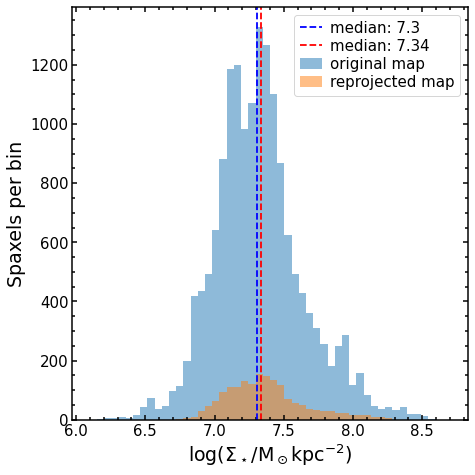

In [39]:
fig, ax = plt.subplots(figsize=(7,7))
#ax.hist(np.log10(S_Mstar).flatten(),alpha=0.5,label=r'original map',density=True,bins=np.linspace(6.1,8.7,51))
ax.hist(np.log10(S_Mstar).flatten(),alpha=0.5,label=r'original map',bins=np.linspace(6.1,8.7,51))
median1 = np.nanmedian(np.log10(S_Mstar).flatten())
#ax.hist(np.log10(S_Mstar_rep).flatten(),alpha=0.5,label=r'reprojected map',density=True,bins=np.linspace(6.1,8.7,51))
ax.hist(np.log10(S_Mstar_rep).flatten(),alpha=0.5,label=r'reprojected map',bins=np.linspace(6.1,8.7,51))
median2 = np.nanmedian(np.log10(S_Mstar_rep).flatten())
ax.axvline(median1,ls='--',c='b',label=f'median: {median1:.3}')
ax.axvline(median2,ls='--',c='r',label=f'median: {median2:.3}')
ax.set_xlabel(r'log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)')
ax.set_ylabel(r'Spaxels per bin')
ax.legend(loc='best')
fig.tight_layout()
fig.savefig(figurepath+source+'_SMstar_hist')
fig.savefig(colloquiumpath+source+'_SMstar_hist.png')
plt.show()

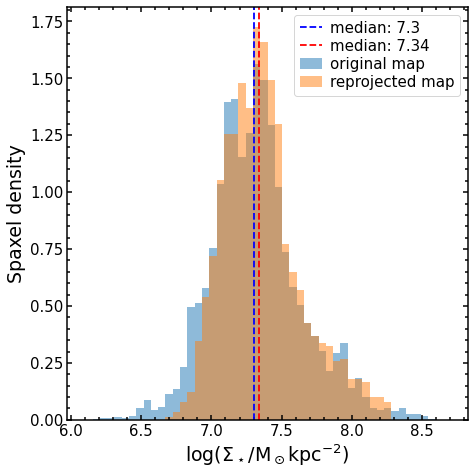

In [40]:
fig, ax = plt.subplots(figsize=(7,7))
ax.hist(np.log10(S_Mstar).flatten(),alpha=0.5,label=r'original map',density=True,bins=np.linspace(6.1,8.7,51))
median1 = np.nanmedian(np.log10(S_Mstar).flatten())
ax.hist(np.log10(S_Mstar_rep).flatten(),alpha=0.5,label=r'reprojected map',density=True,bins=np.linspace(6.1,8.7,51))
median2 = np.nanmedian(np.log10(S_Mstar_rep).flatten())
ax.axvline(median1,ls='--',c='b',label=f'median: {median1:.3}')
ax.axvline(median2,ls='--',c='r',label=f'median: {median2:.3}')
ax.set_xlabel(r'log($\Sigma_\star$/M$_\odot$kpc$^{-2}$)')
ax.set_ylabel(r'Spaxel density')
ax.legend(loc='best')
fig.tight_layout()
fig.savefig(figurepath+source+'_SMstar_hist_density')
fig.savefig(colloquiumpath+source+'_SMstar_hist_density.png')
plt.show()

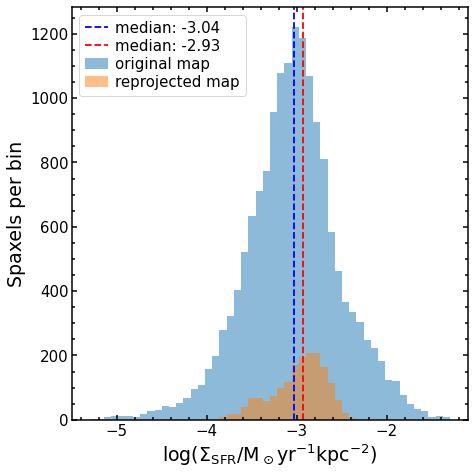

In [41]:
fig, ax = plt.subplots(figsize=(7,7))
#ax.hist(np.log10(S_SFR).flatten(),alpha=0.5,label=r'original map',density=True,bins=np.linspace(-5.3,-1.3,51))
ax.hist(np.log10(S_SFR).flatten(),alpha=0.5,label=r'original map',bins=np.linspace(-5.3,-1.3,51))
median1 = np.nanmedian(np.log10(S_SFR).flatten())
#ax.hist(np.log10(S_SFR_rep).flatten(),alpha=0.5,label=r'reprojected map',density=True,bins=np.linspace(-5.3,-1.3,51))
ax.hist(np.log10(S_SFR_rep).flatten(),alpha=0.5,label=r'reprojected map',bins=np.linspace(-5.3,-1.3,51))
median2 = np.nanmedian(np.log10(S_SFR_rep).flatten())
ax.axvline(median1,ls='--',c='b',label=f'median: {median1:.3}')
ax.axvline(median2,ls='--',c='r',label=f'median: {median2:.3}')
ax.set_xlabel(r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.set_ylabel(r'Spaxels per bin')
ax.legend(loc='best')
fig.tight_layout()
fig.savefig(figurepath+source+'_SSFR_hist')
fig.savefig(colloquiumpath+source+'_SSFR_hist.png')
plt.show()

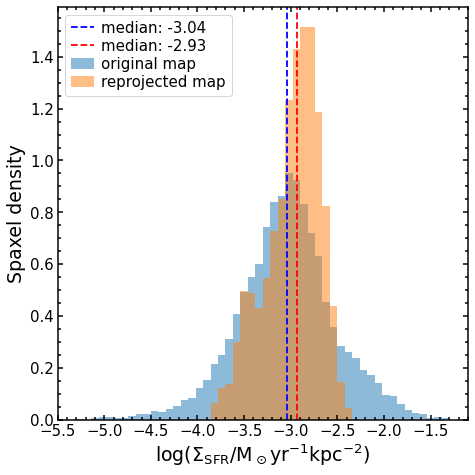

In [42]:
fig, ax = plt.subplots(figsize=(7,7))
ax.hist(np.log10(S_SFR).flatten(),alpha=0.5,label=r'original map',density=True,bins=np.linspace(-5.3,-1.3,51))
#ax.hist(np.log10(S_SFR).flatten(),alpha=0.5,label=r'original map',bins=np.linspace(-5.3,-1.3,51))
median1 = np.nanmedian(np.log10(S_SFR).flatten())
ax.hist(np.log10(S_SFR_rep).flatten(),alpha=0.5,label=r'reprojected map',density=True,bins=np.linspace(-5.3,-1.3,51))
#ax.hist(np.log10(S_SFR_rep).flatten(),alpha=0.5,label=r'reprojected map',bins=np.linspace(-5.3,-1.3,51))
median2 = np.nanmedian(np.log10(S_SFR_rep).flatten())
ax.axvline(median1,ls='--',c='b',label=f'median: {median1:.3}')
ax.axvline(median2,ls='--',c='r',label=f'median: {median2:.3}')
ax.set_xlabel(r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)')
ax.set_ylabel(r'Spaxel density')
ax.legend(loc='best')
fig.tight_layout()
fig.savefig(figurepath+source+'_SSFR_hist_density')
fig.savefig(colloquiumpath+source+'_SSFR_hist_density.png')
plt.show()

In [12]:
from scipy.stats import ks_2samp

In [14]:
ks_SMstar = ks_2samp(np.log10(S_Mstar[np.isfinite(S_Mstar)]),np.log10(S_Mstar_rep[np.isfinite(S_Mstar_rep)]))#,method='exact')
print(ks_SMstar)
ks_SMstar = ks_2samp(np.log10(S_Mstar[S_Mstar>0]),np.log10(S_Mstar_rep[S_Mstar_rep>0]))#,method='exact')
print(ks_SMstar)

KstestResult(statistic=0.08505132824039532, pvalue=3.240320037634527e-10, statistic_location=7.167597938292341, statistic_sign=1)
KstestResult(statistic=0.08505132824039532, pvalue=3.240320037634527e-10, statistic_location=7.167597938292341, statistic_sign=1)


In [15]:
ks_SSFR = ks_2samp(np.log10(S_SFR[np.isfinite(S_SFR)]),np.log10(S_SFR_rep[np.isfinite(S_SFR_rep)]))#,method='exact')
print(ks_SSFR)
ks_SSFR = ks_2samp(np.log10(S_SFR[S_SFR>0]),np.log10(S_SFR_rep[S_SFR_rep>0]))#,method='exact')
print(ks_SSFR)

KstestResult(statistic=0.151407506338529, pvalue=1.733773106694874e-31, statistic_location=-3.103387533912667, statistic_sign=1)
KstestResult(statistic=0.151407506338529, pvalue=1.733773106694874e-31, statistic_location=-3.103387533912667, statistic_sign=1)


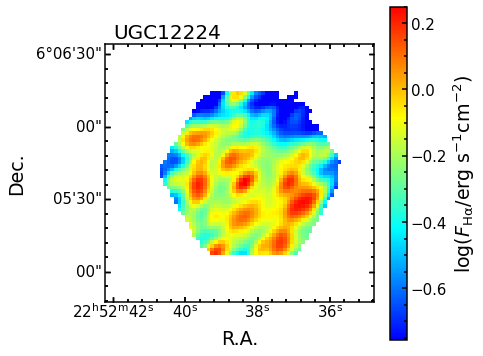

/tmp/ipykernel_1003443/102981036.py:17: RuntimeWarning: invalid value encountered in log10
  frame = np.log10(F_Ha)


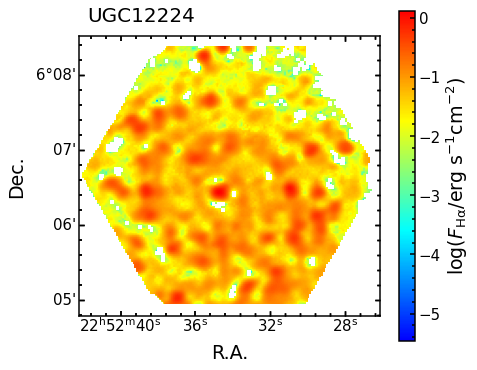

In [20]:
source = 'UGC12224'
frame = np.log10(F_Ha_rep)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+name)
plt.show()
plt.close()

frame = np.log10(F_Ha)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(aca_hdr))
#vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow)#,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)')
ax.text(frame.shape[0]/40,frame.shape[1]*39/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+name)
plt.show()
plt.close()

In [ ]:
frame = np.log10(S_Mstar_rep)
fig = plt.figure(figsize=(7,6))
ax = fig.add_subplot(1,1,1,projection=WCS(califa_hdr))
vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
#vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
fig.colorbar(im,ax=ax,orientation='vertical',label=r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)')
    #    ax.text(frame.shape[0]/40,frame.shape[1]*34/40,source)
ax.coords['ra'].set_axislabel('R.A.')
ax.coords['dec'].set_axislabel('Dec.')
fig.tight_layout()
#fig.savefig(figurepath+source+name)
plt.show()
plt.close()

In [ ]:
figures = [np.log10(F_Ha),np.log10(frames_cube_convolved[1]),np.log10(F_Ha_rep)]
    #figures = [np.log10(S_Mstar),np.log10(S_Mstar_conv),np.log10(S_Mstar_rep)]
    #figures = [S_Mstar,S_Mstar_rep,CO_int]
    WCSs = [WCS(califa_hdr),WCS(califa_hdr),WCS(aca_hdr)]
    names = ['SMstar','SMstar_conv','SMstar_rep']
    labels = [r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)',r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)',r'log($F_\mathrm{H\alpha}$/erg s$^{-1}$cm$^{-2}$)']
    beams  = [False,True,True]
    dynamics = [True,True,True]
    tosave = [False,False,False]
    
    
    #for frame,wcs,name,label,beam,dynamic,save in zip(figures,WCSs,names,labels,beams,dynamics,tosave):
    #    fig = plt.figure(figsize=(7,6))
    #    ax = fig.add_subplot(1,1,1,projection=wcs)
    #    if dynamic:
    #        vmin, vmax = (np.nanpercentile(frame,5),np.nanmax(frame))#np.nanpercentile(frame,95))
    #    else:
     #       vmin, vmax = (np.nanmin(frame),np.nanmax(frame))
    #    im = ax.imshow(frame, origin='lower',cmap=cmap_rainbow,vmin=vmin,vmax=vmax)
    #    fig.colorbar(im,ax=ax,orientation='vertical',label=label)
    #    ax.text(frame.shape[0]/40,frame.shape[1]*34/40,source)
    #    ax.coords['ra'].set_axislabel('R.A.')
    #    ax.coords['dec'].set_axislabel('Dec.')
    #    if beam:
    #        ell = Ellipse(xy=(frame.shape[0]/10,frame.shape[1]/10), width=7500*beam_aca.minor.value, height=7500*beam_aca.major.value, angle=beam_aca.pa.value, color='black')
    #        ell.set_facecolor('none')
    #        ax.add_artist(ell)
    #    fig.tight_layout()
    #    if save:
    #        fig.savefig(figurepath+source+name)
    #    plt.show()
    #    plt.close()


Initializing source 1 of 58: CGCG429-012


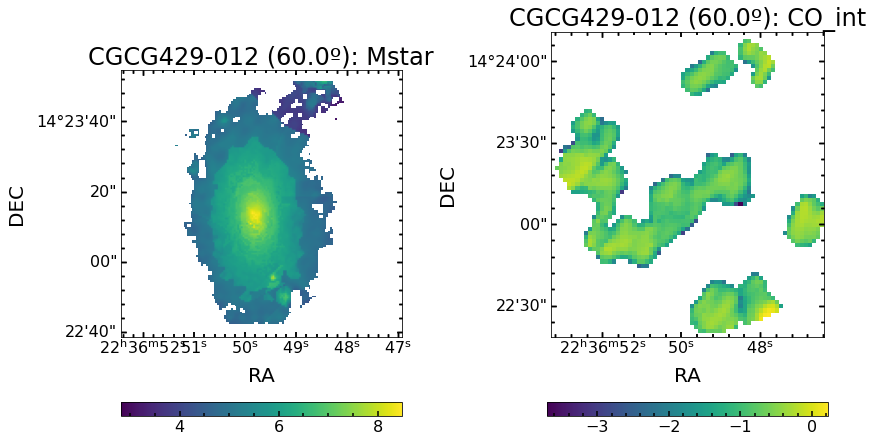


Initializing source 2 of 58: IC1079


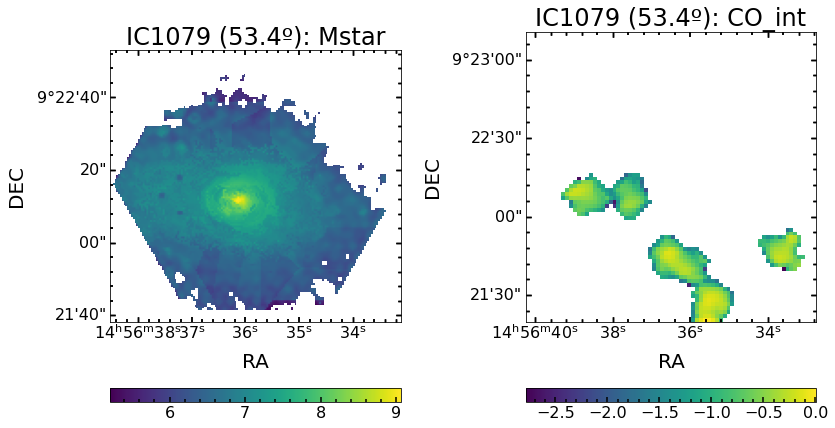


Initializing source 3 of 58: IC1528


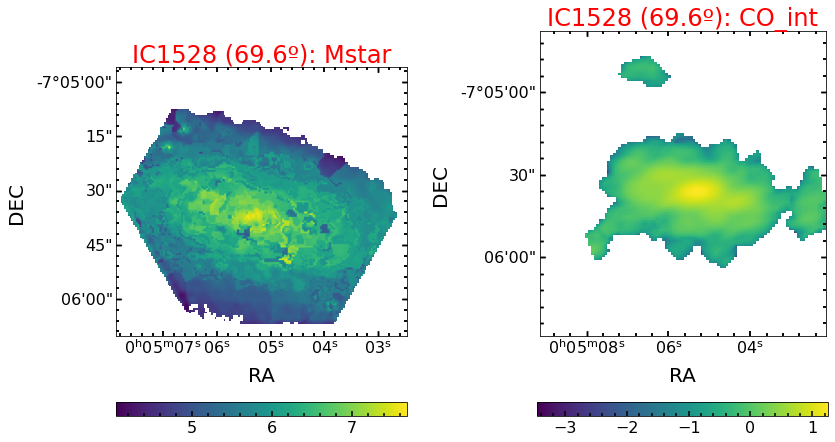


Initializing source 4 of 58: IC2341


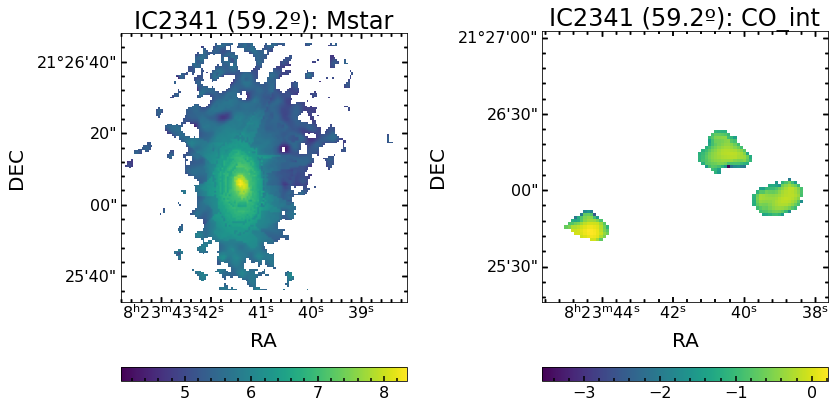


Initializing source 5 of 58: MCG-01-01-012


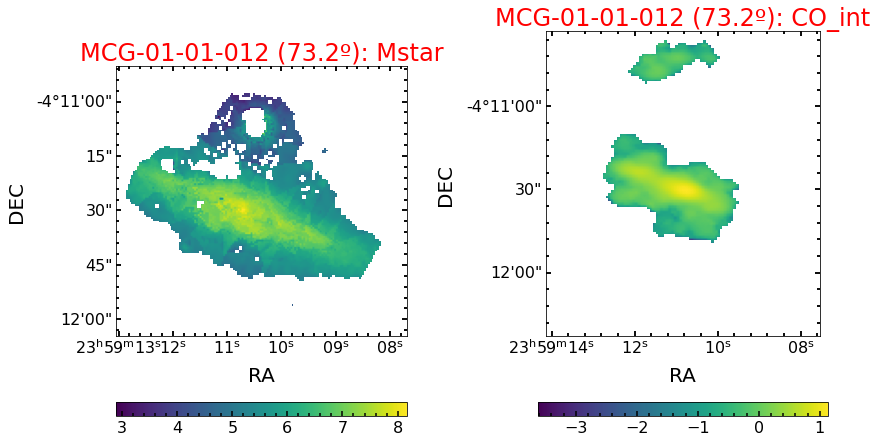


Initializing source 6 of 58: MCG-01-10-015


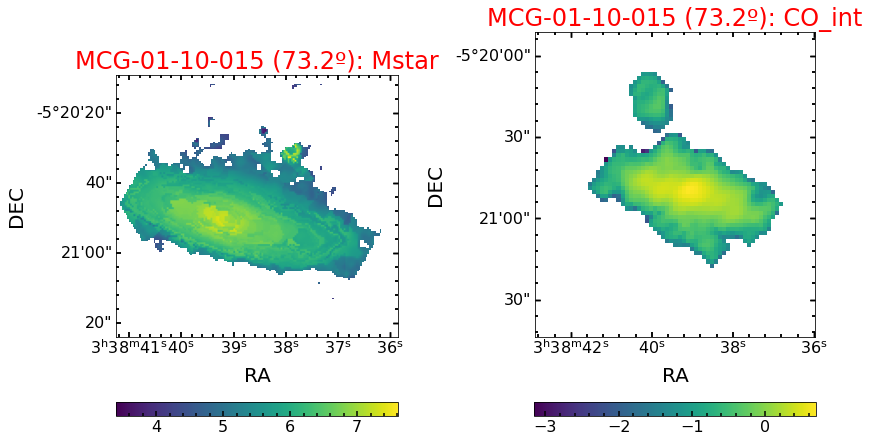


Initializing source 7 of 58: MCG-01-52-012


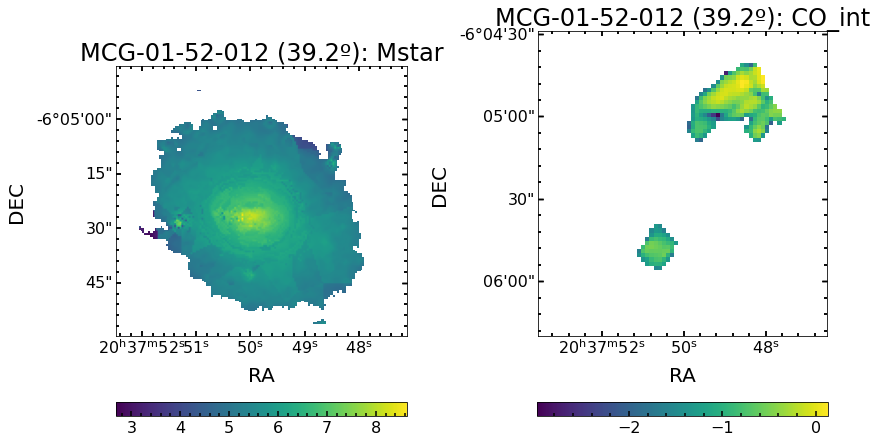


Initializing source 8 of 58: MCG-02-02-030


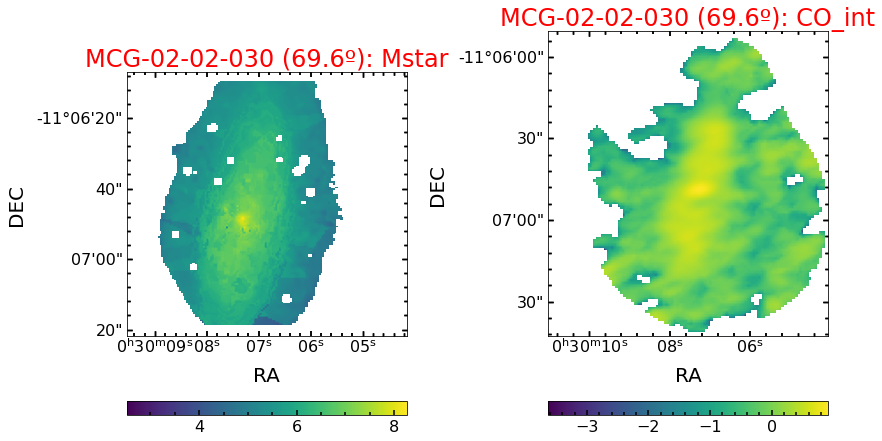


Initializing source 9 of 58: MCG-02-51-004


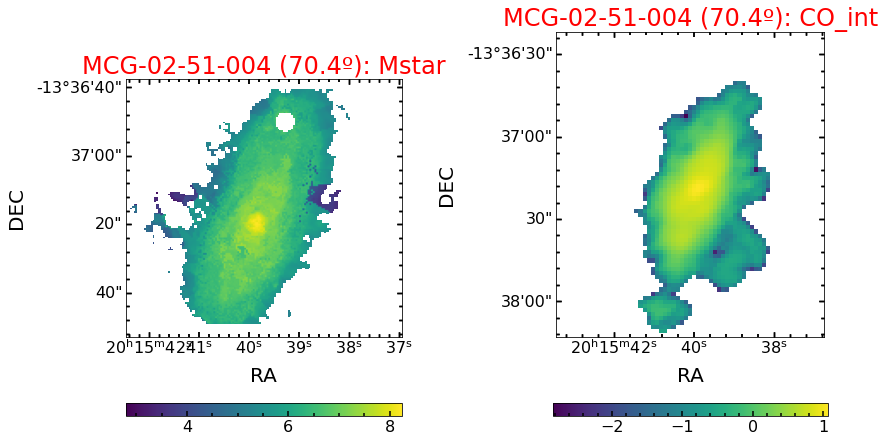


Initializing source 10 of 58: NGC0001


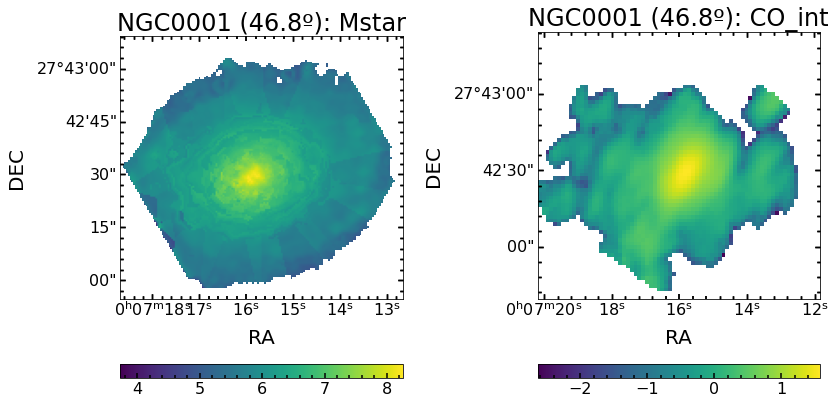


Initializing source 11 of 58: NGC0155


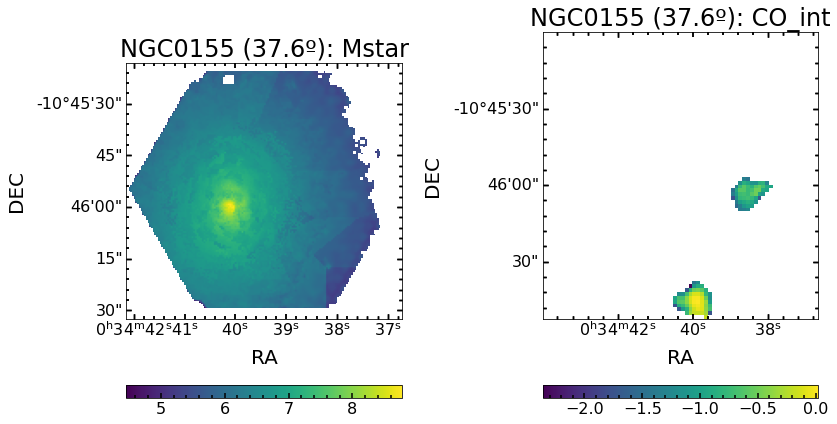


Initializing source 12 of 58: NGC0169


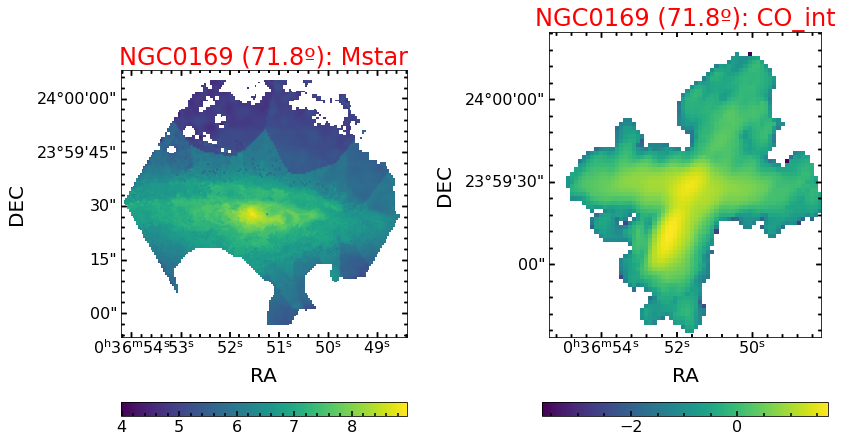


Initializing source 13 of 58: NGC0171


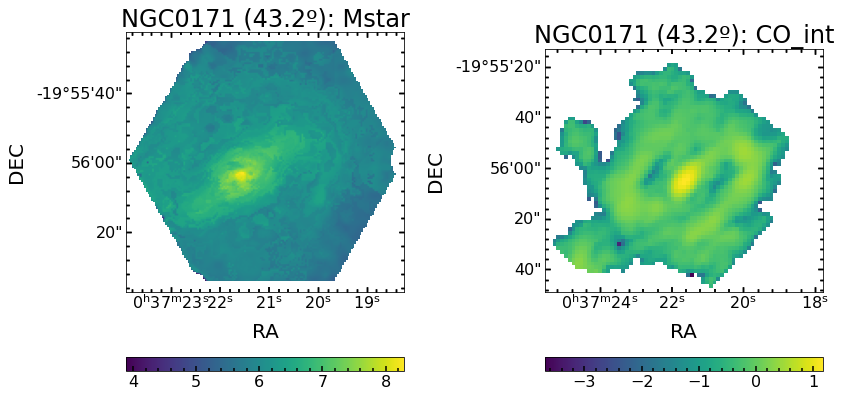


Initializing source 14 of 58: NGC0180


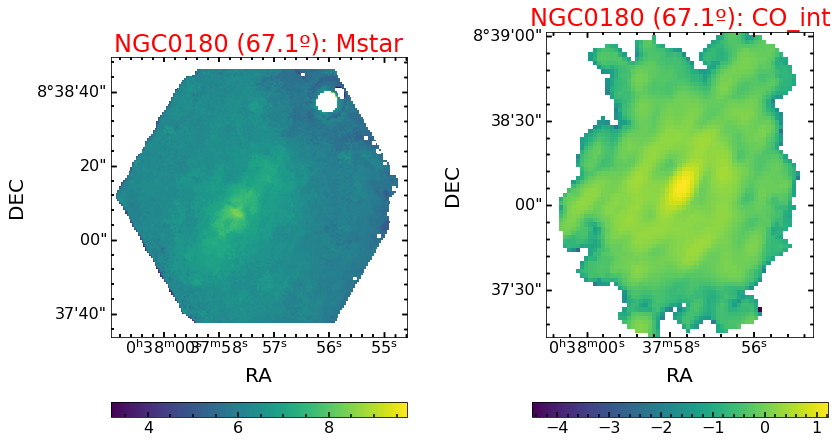


Initializing source 15 of 58: NGC0693


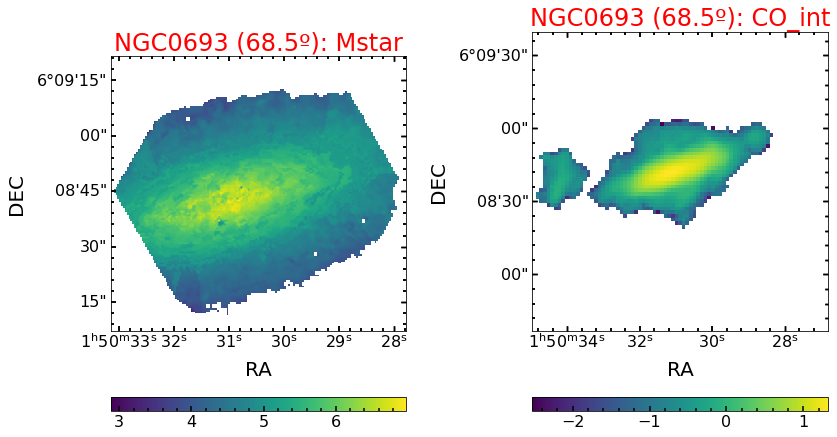


Initializing source 16 of 58: NGC0731


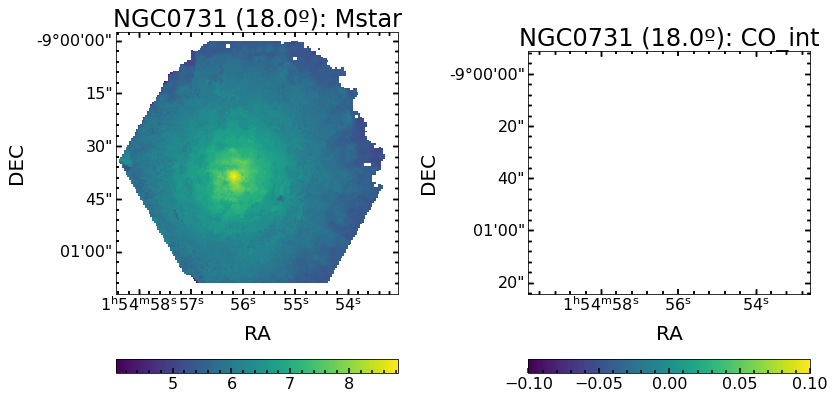


Initializing source 17 of 58: NGC0768


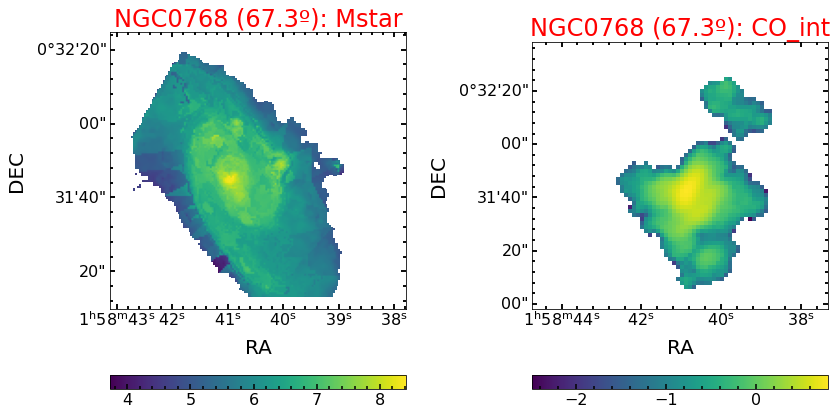


Initializing source 18 of 58: NGC0955


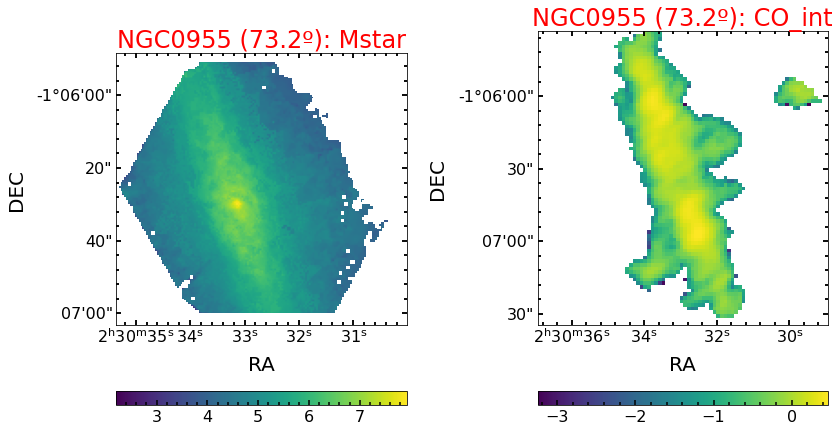


Initializing source 19 of 58: NGC1056


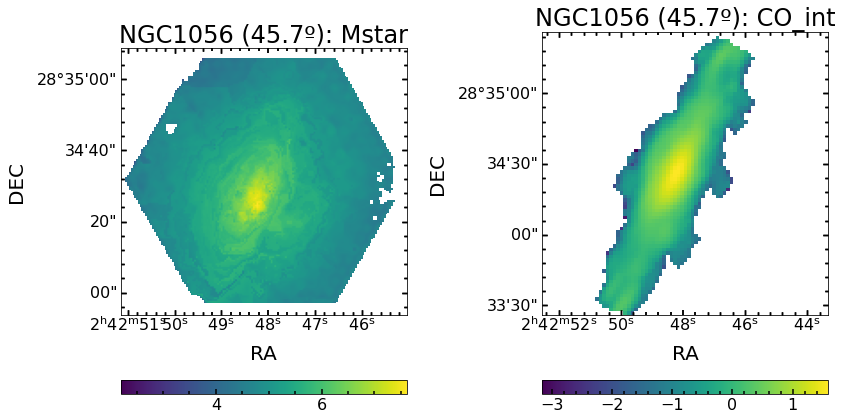


Initializing source 20 of 58: NGC1542


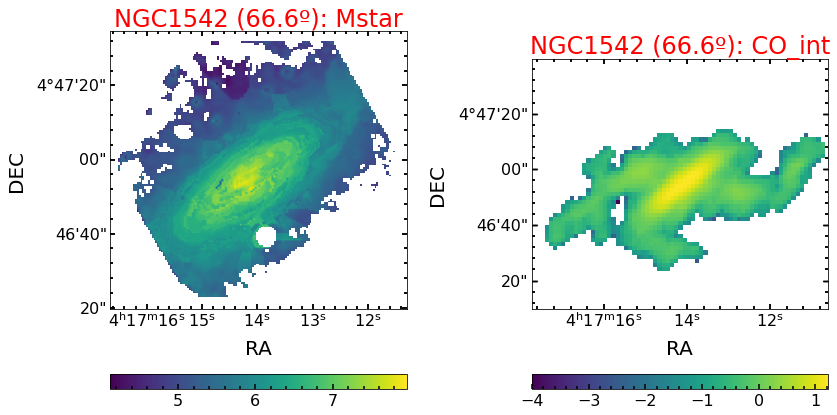


Initializing source 21 of 58: NGC2449


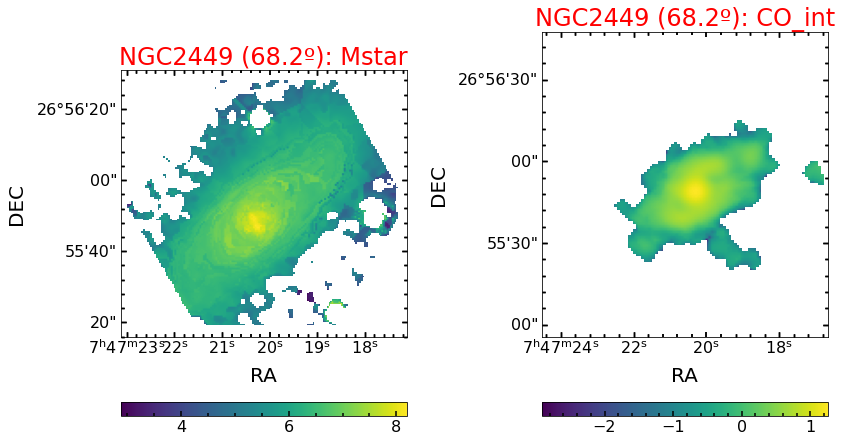


Initializing source 22 of 58: NGC2540


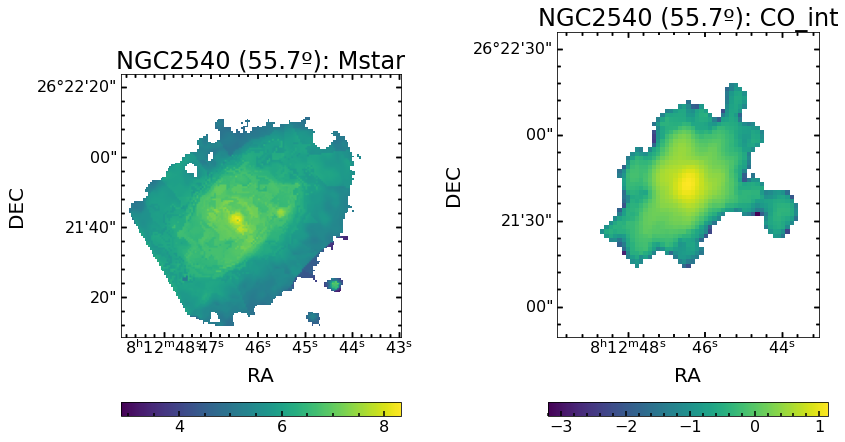


Initializing source 23 of 58: NGC2554


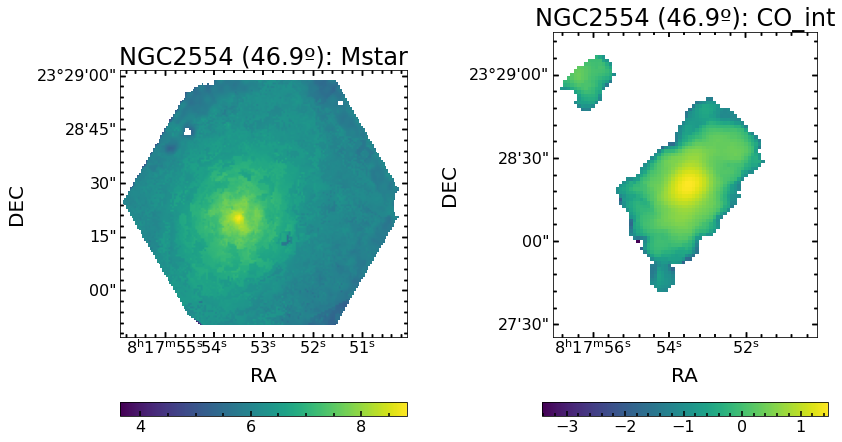


Initializing source 24 of 58: NGC2595


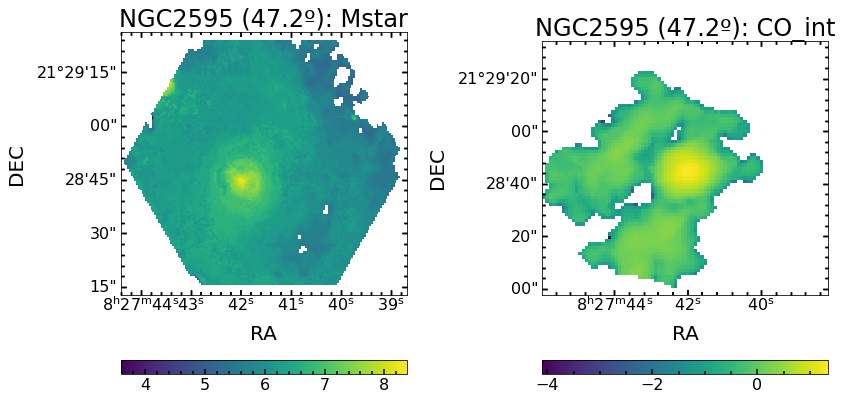


Initializing source 25 of 58: NGC3300


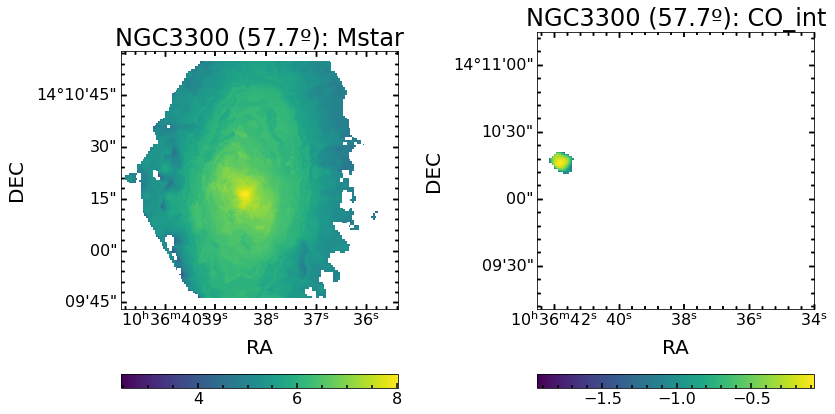


Initializing source 26 of 58: NGC6427


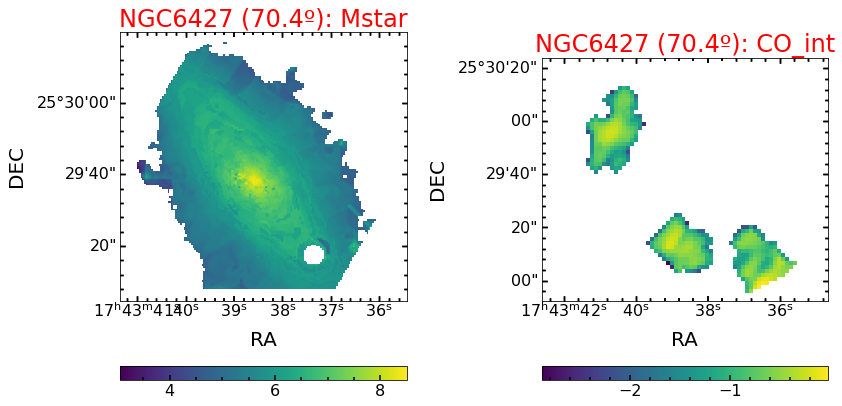


Initializing source 27 of 58: NGC7025


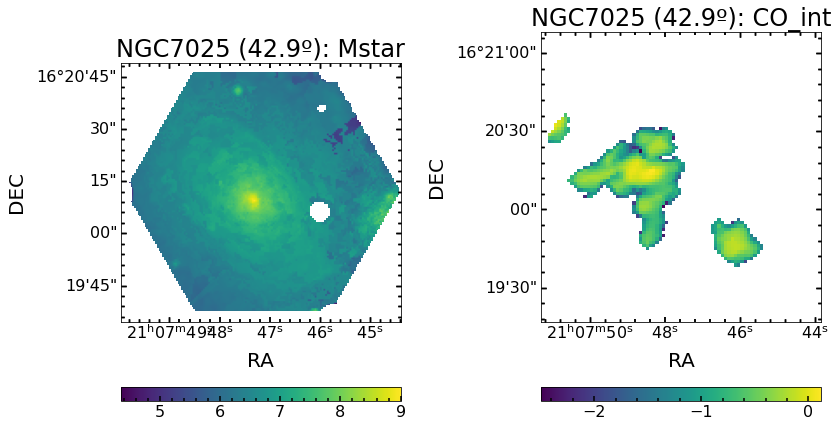


Initializing source 28 of 58: NGC7194


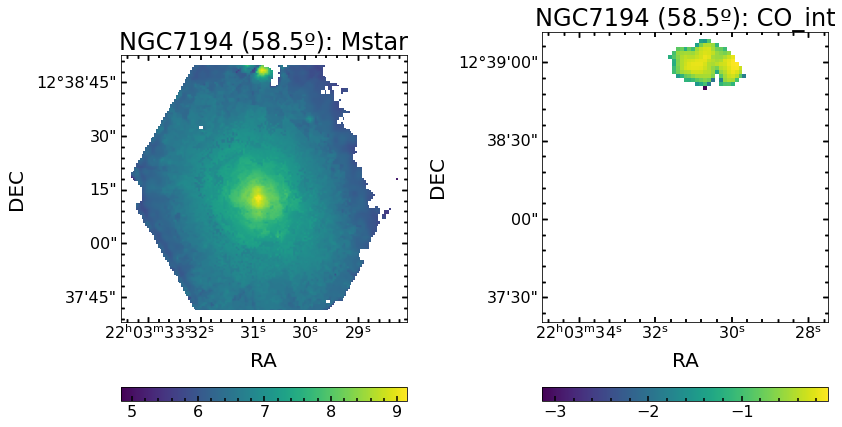


Initializing source 29 of 58: NGC7311


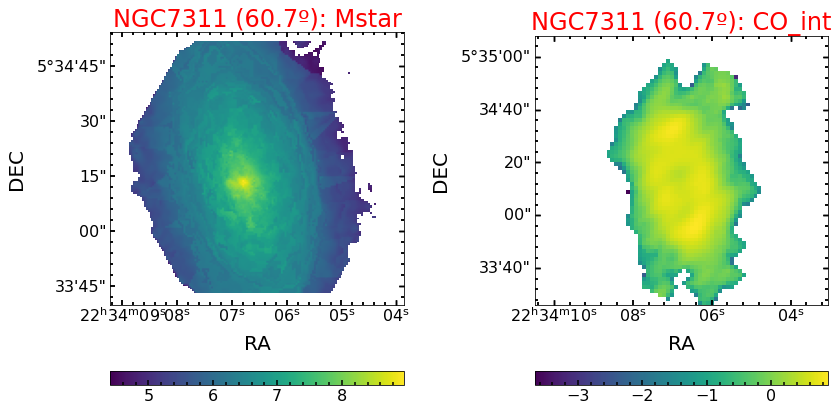


Initializing source 30 of 58: NGC7321


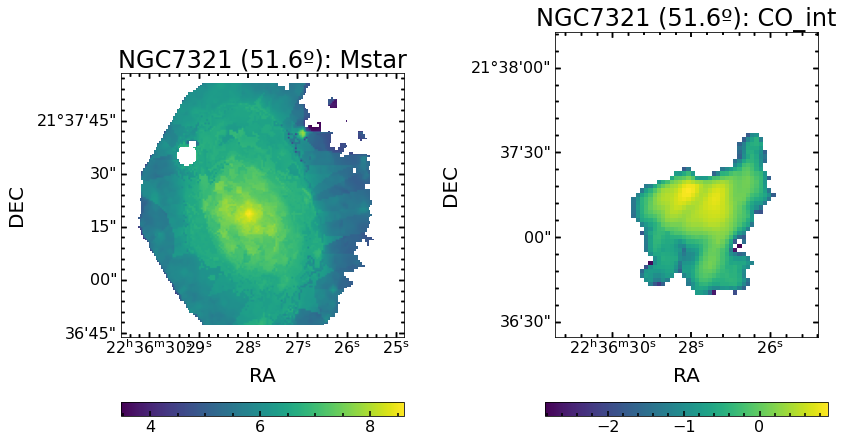


Initializing source 31 of 58: NGC7364


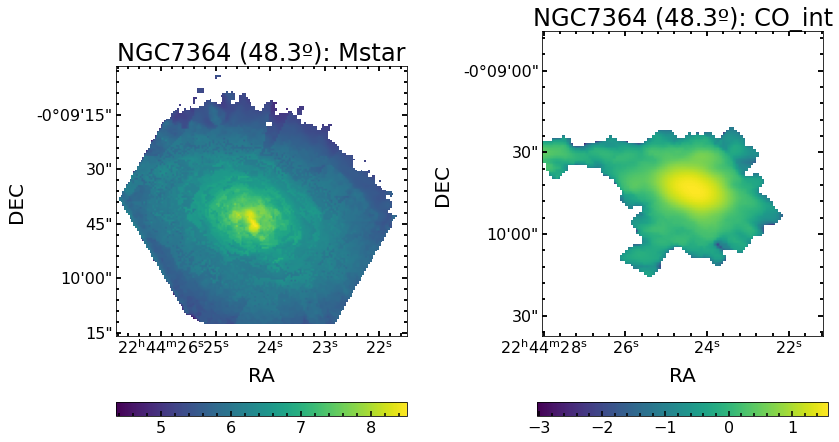


Initializing source 32 of 58: NGC7466


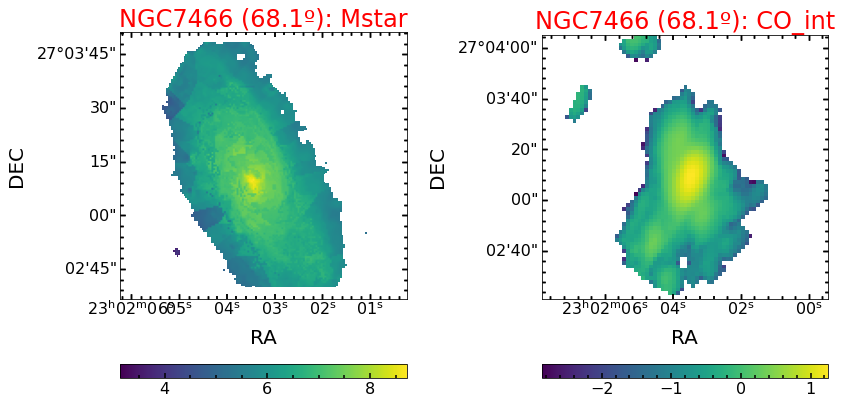


Initializing source 33 of 58: NGC7489


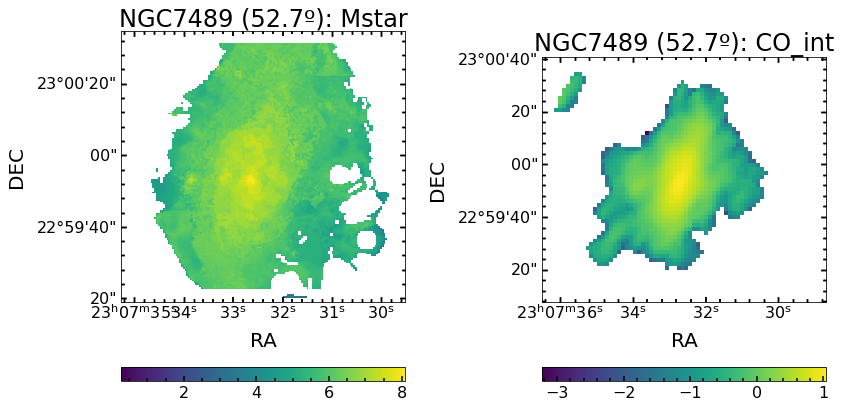


Initializing source 34 of 58: NGC7625


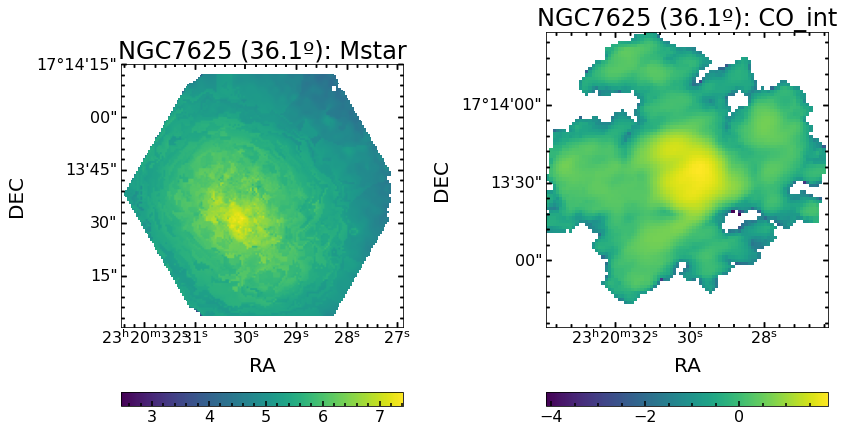


Initializing source 35 of 58: NGC7716


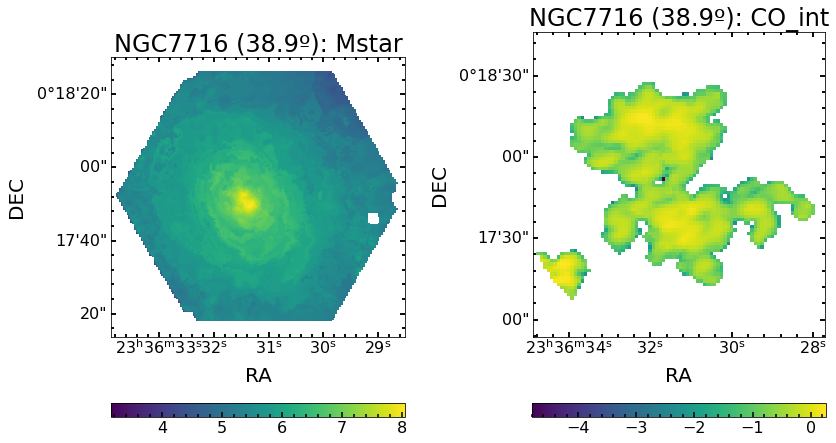


Initializing source 36 of 58: UGC00312


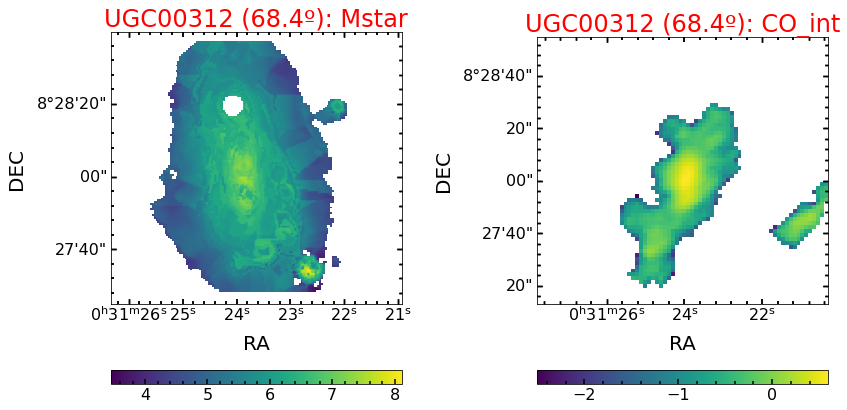


Initializing source 37 of 58: UGC00335NED02


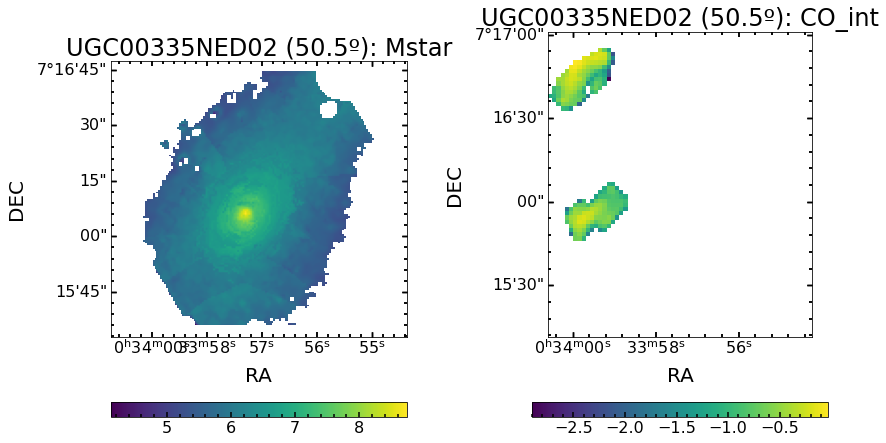


Initializing source 38 of 58: UGC01123


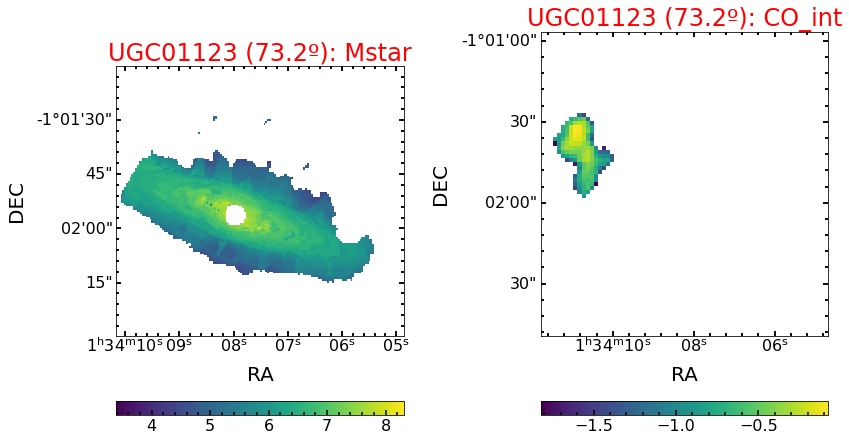


Initializing source 39 of 58: UGC01368


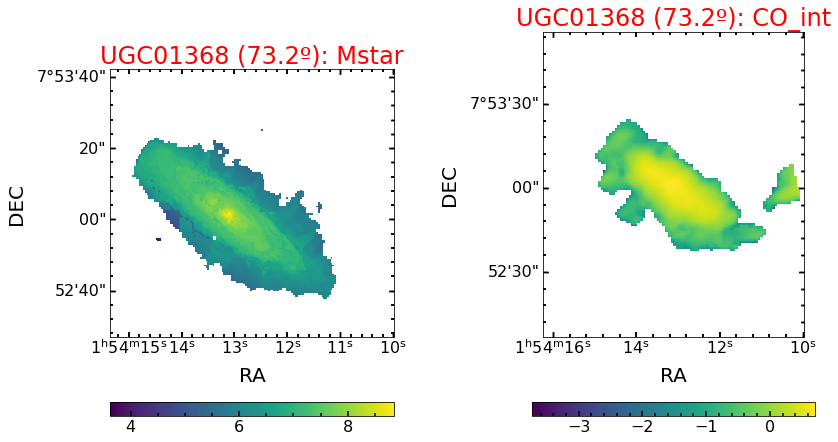


Initializing source 40 of 58: UGC01938


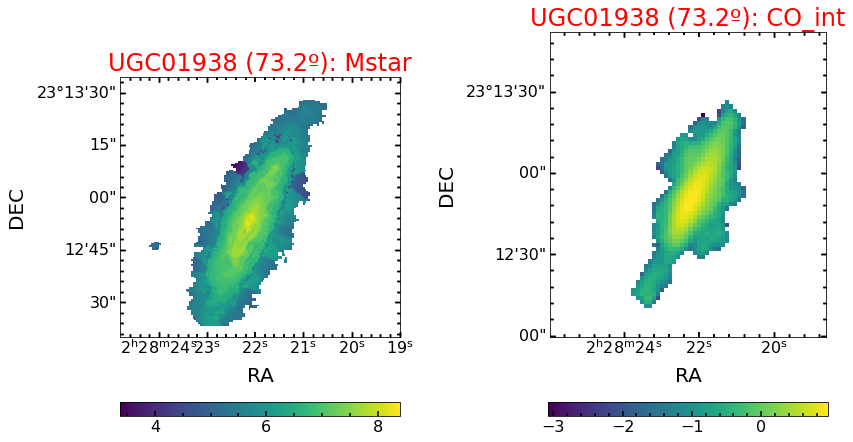


Initializing source 41 of 58: UGC02099


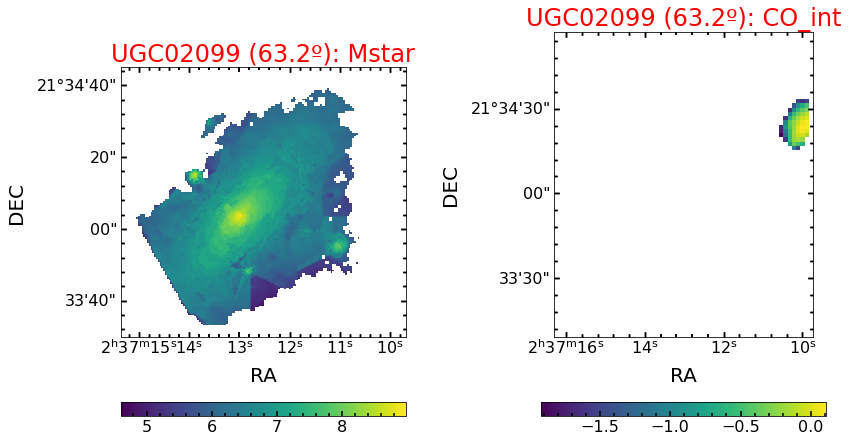


Initializing source 42 of 58: UGC04240


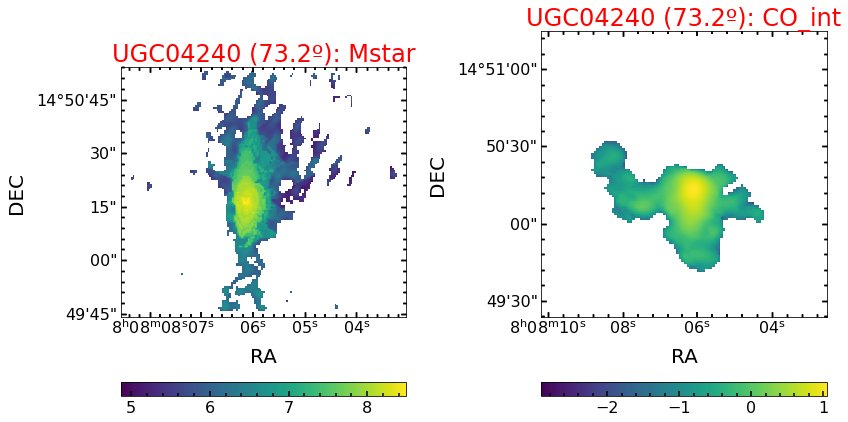


Initializing source 43 of 58: UGC04245


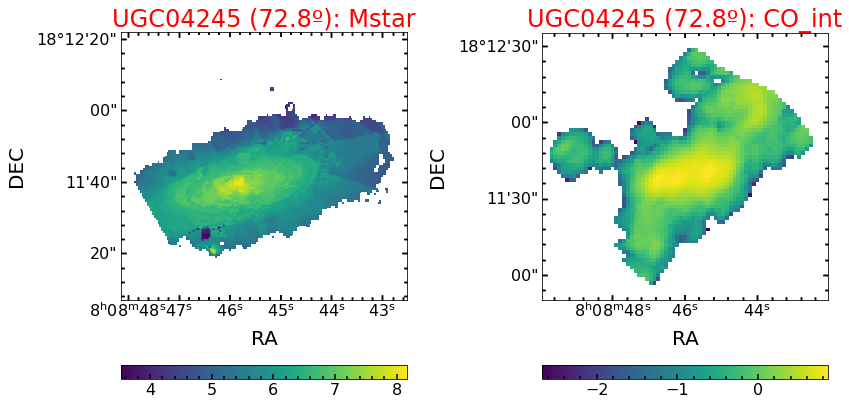


Initializing source 44 of 58: UGC04455


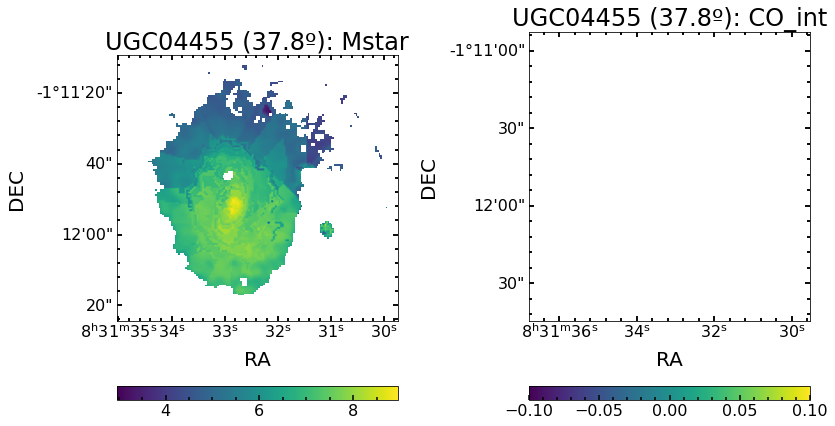


Initializing source 45 of 58: UGC05396


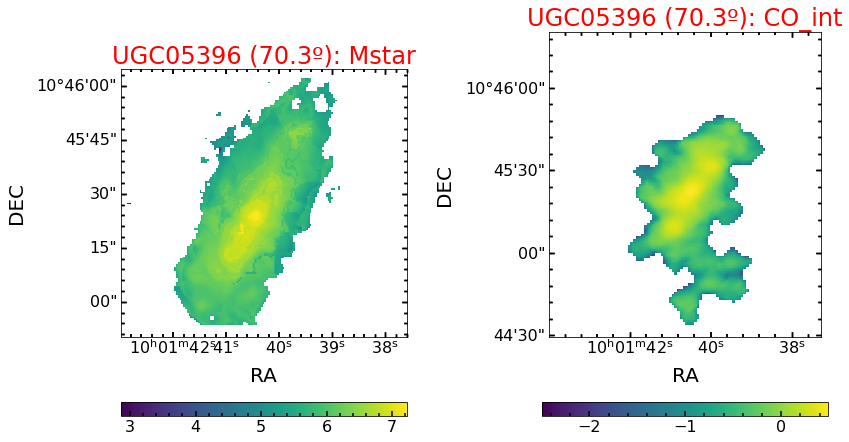


Initializing source 46 of 58: UGC08322


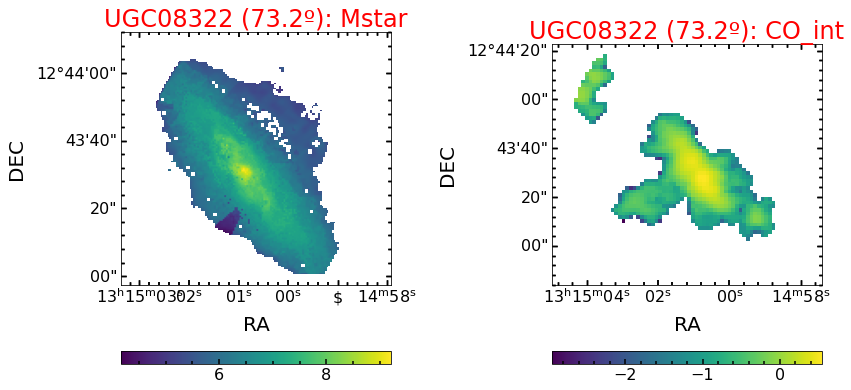


Initializing source 47 of 58: UGC08781


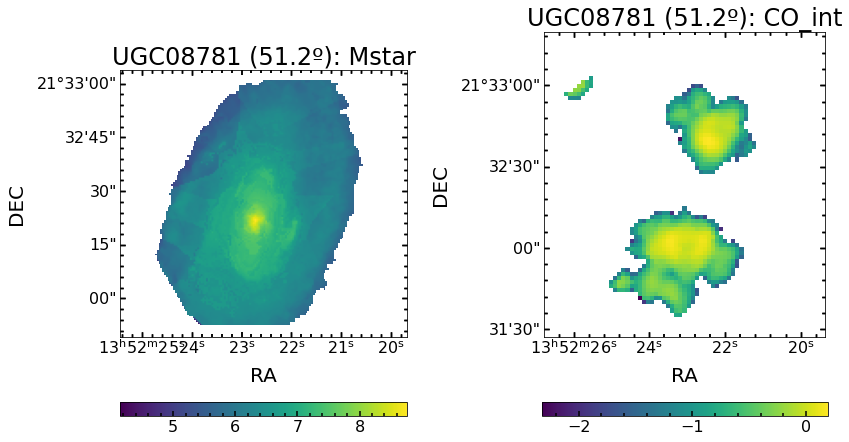


Initializing source 48 of 58: UGC10972


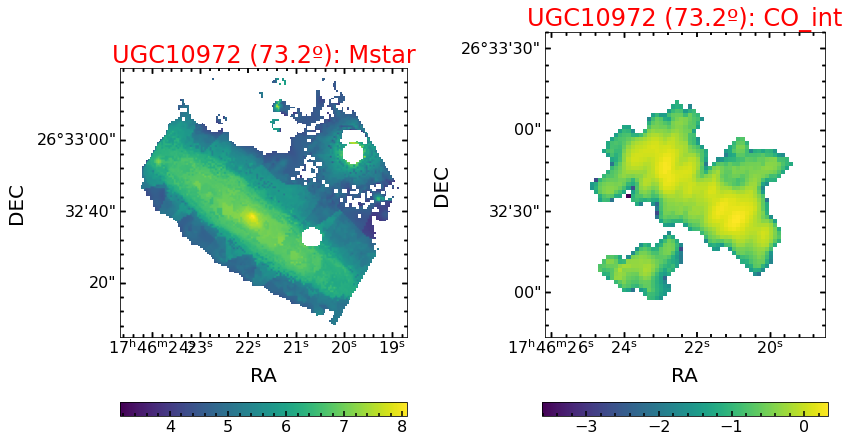


Initializing source 49 of 58: UGC11649


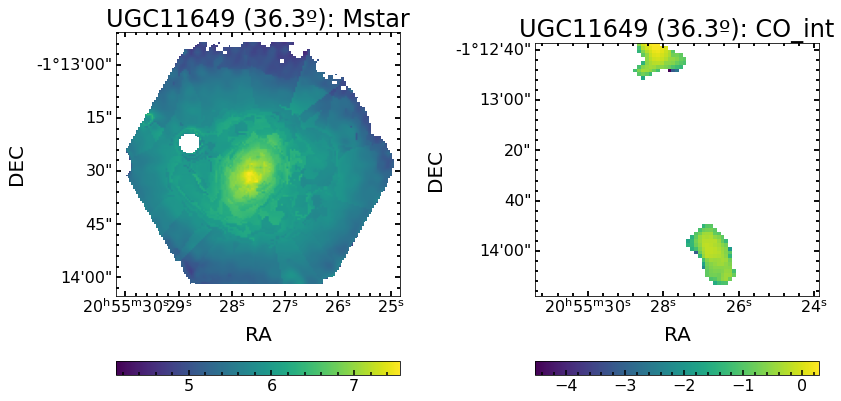


Initializing source 50 of 58: UGC11680NED02


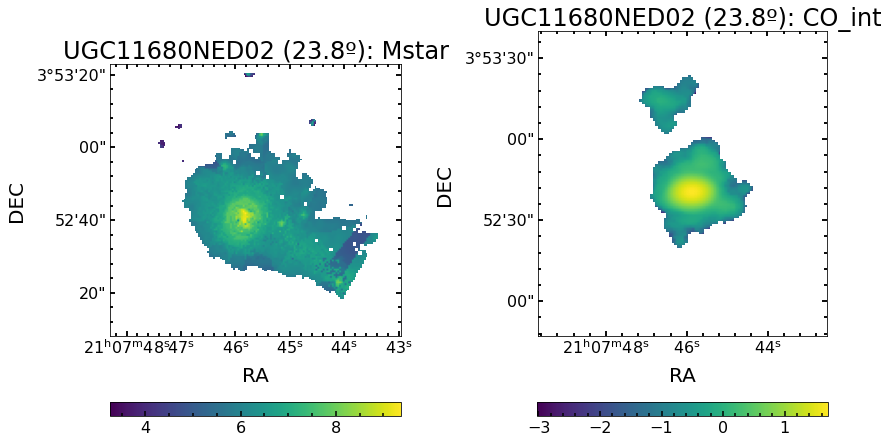


Initializing source 51 of 58: UGC11792


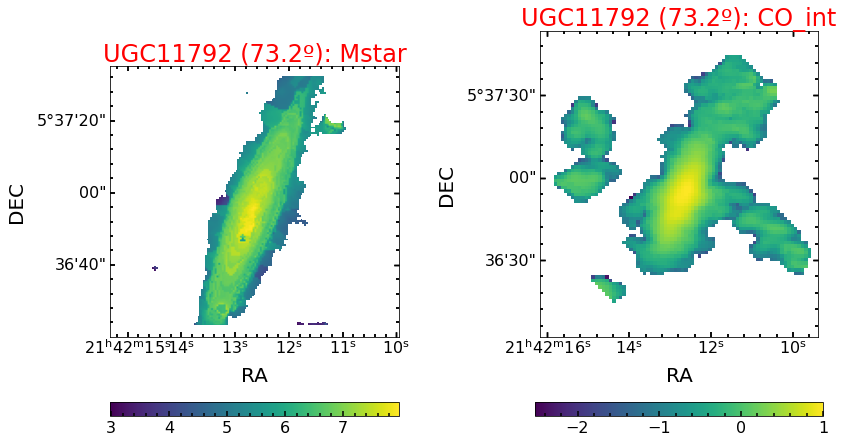


Initializing source 52 of 58: UGC11958


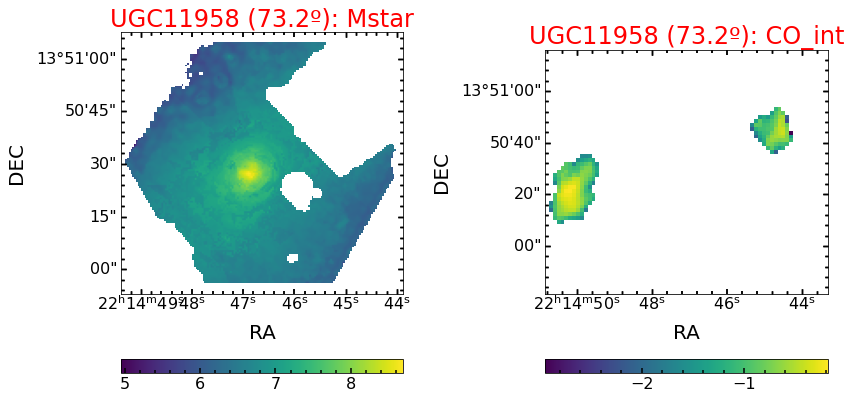


Initializing source 53 of 58: UGC11982


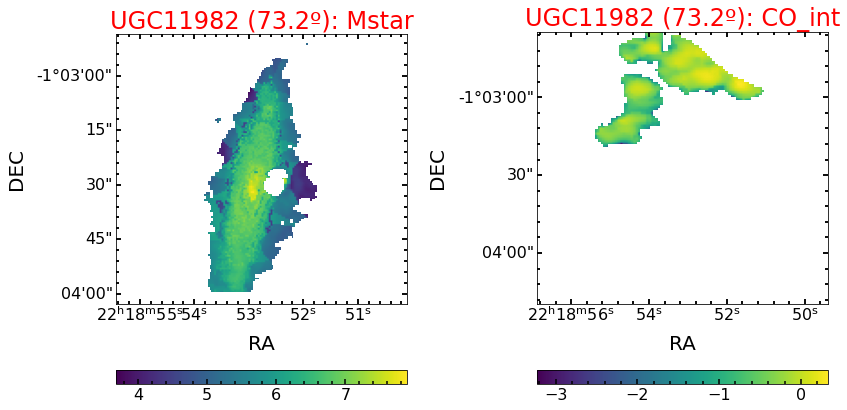


Initializing source 54 of 58: UGC12224


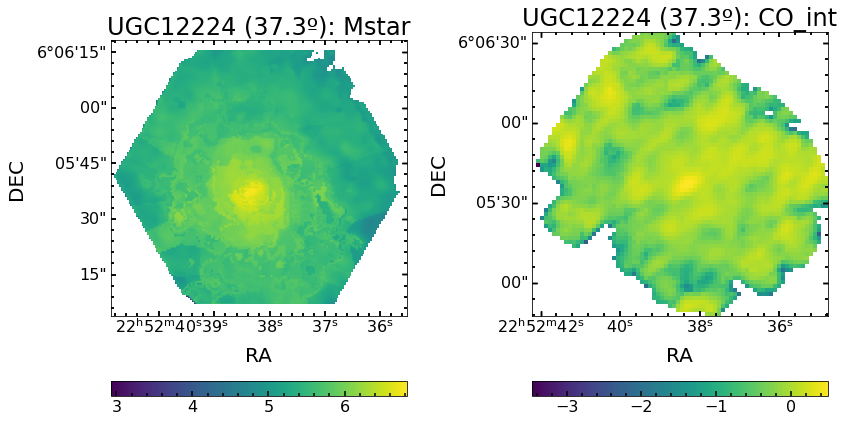


Initializing source 55 of 58: UGC12250


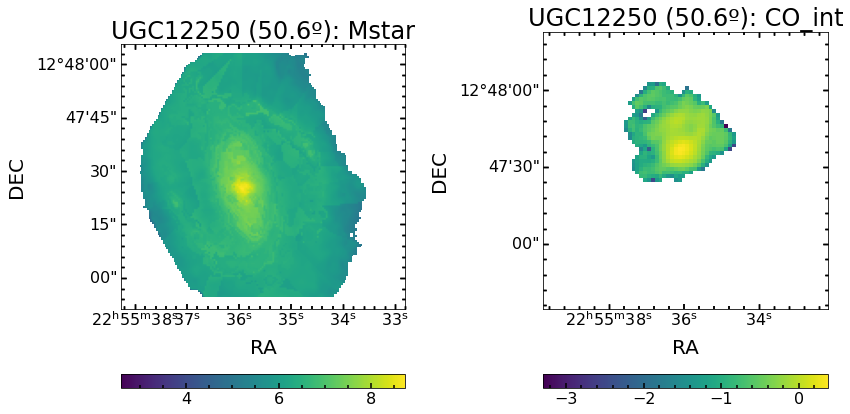


Initializing source 56 of 58: UGC12274


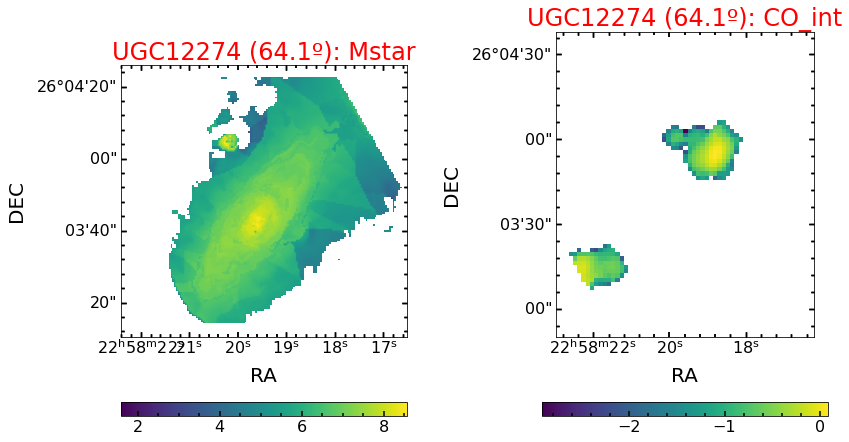


Initializing source 57 of 58: UGC12348


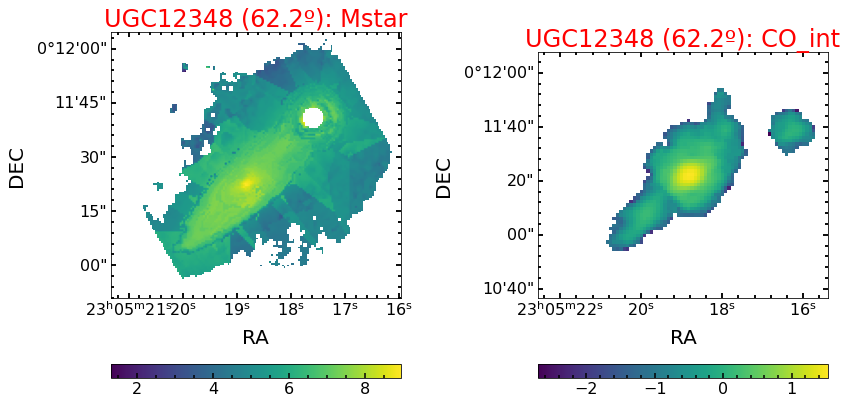


Initializing source 58 of 58: VV488NED02


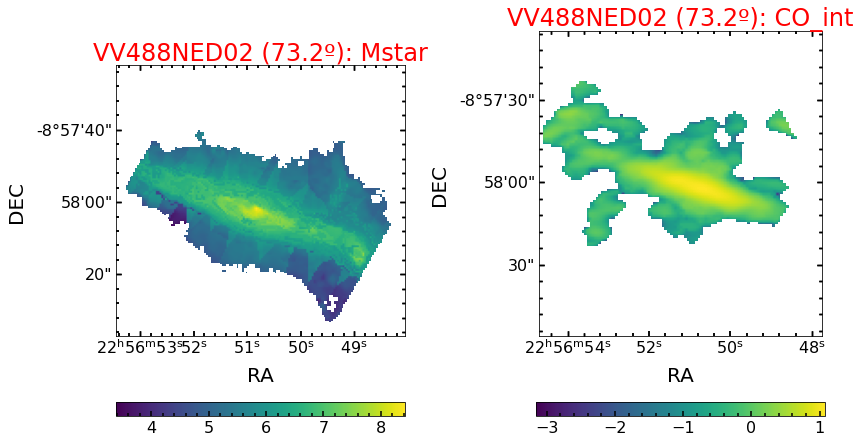

In [25]:
Database = []
for n,source in enumerate(sources[:]):
    print(f'\nInitializing source {n+1} of {len(sources)}:',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']

    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    fig = plt.figure(figsize=(12,7))
    ax1 = fig.add_subplot(1,2,1,projection=WCS(califa_hdr))
    ax2 = fig.add_subplot(1,2,2,projection=WCS(aca_hdr))
    for ax,frame,label in zip([ax1,ax2],[Mstar,CO_int],['Mstar','CO_int']):
        im = ax.imshow(np.log10(frame), origin='lower')
        fig.colorbar(im,ax=ax,orientation='horizontal')
        ax.set_title(source+f' ({inc:.3}º): '+label)#,fontsize=15)
        if inc>=60:
            ax.set_title(source+f' ({inc:.3}º): '+label,c='r')
        ax.coords['ra'].set_axislabel('RA')
        ax.coords['dec'].set_axislabel('DEC')
    fig.tight_layout()
    plt.show()
    plt.close()

In [8]:
n = 0
for source in sources:
    hdu_list = fits.open(califainpath+source+'.Pipe3D.cube.fits.gz')
    n+=1
    hdu_list.close()
print(n)

55


In [16]:
hdu_list = fits.open(califainpath+'UGC12250'+'.Pipe3D.cube.fits.gz')

In [20]:
WCS(hdu_list[0].header).to_header()

WCSAXES =                    3 / Number of coordinate axes                      
CRPIX1  =                 69.0 / Pixel coordinate of reference point            
CRPIX2  =                 63.0 / Pixel coordinate of reference point            
CRPIX3  =                  1.0 / Pixel coordinate of reference point            
PC1_1   = -0.00013888888888888 / Coordinate transformation matrix element       
PC2_2   =  0.00013888888888889 / Coordinate transformation matrix element       
PC3_3   =                  2.0 / Coordinate transformation matrix element       
CDELT1  =                  1.0 / [deg] Coordinate increment at reference point  
CDELT2  =                  1.0 / [deg] Coordinate increment at reference point  
CDELT3  =                  1.0 / [Angstrom] Coordinate increment at reference po
CUNIT1  = 'deg'                / Units of coordinate increment and value        
CUNIT2  = 'deg'                / Units of coordinate increment and value        
CUNIT3  = 'Angstrom'        

outputpath = '/vol/aibn1081/data1/brodriguez/'
califapath = '/vol/alcina/data1/shared/EDGE/PIPE3DS_v2.3/'
acapath = '/vol/alcina/data1/shared/EDGE/aca_edge_natv/cubes/'

path = '/vol/aibn1081/data1/brodriguez/'
source = 'UGC12250'
cube_path = path+source+'_7m_co21_pbcor.fits'
reduced_path = cube_path.replace('pbcor','reduced')
mask_path = cube_path.replace('pbcor','smoothmask')
integrated_path = cube_path.replace('pbcor','integrated')

In [11]:
from astropy.cosmology import LambdaCDM#, FlatLambdaCDM
cosmo = LambdaCDM(H0=69.7,Om0=0.3,Ode0=0.7)

In [12]:
def get_data(filename,header=False):
    hdu_list = fits.open(filename)
    data = hdu_list[0].data
    hdr = hdu_list[0].header
    hdu_list.close()
    if header:
        return data, hdr
    else:
        return data

In [304]:
for source in sources[:]:
    #print('\nInitializing source',source)
    #M_star, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)    
    Ha_mask = get_data(califaoutpath+source+'_Ha_mask.fits')
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    eF_Ha = get_data(califaoutpath+source+'_eF_Ha.fits')
    if (F_Ha[Ha_mask]/eF_Ha[Ha_mask]<3).any():
    #if (F_Ha/eF_Ha<1).any():
        print('Source:',source)

## Auxiliary D4000 - sSFR database from CALIFA sources

### From all CALIFA sources

In [13]:
califa_table = pd.read_csv('/users/brodriguez/Documents/get_proc_elines_CALIFA_2022.csv',sep=',',skiprows=587,index_col=0,
                    usecols=['name','z_stars','log_Mass','log_SFR_SF','Re_arc','Re_kpc','Inclination','P.A.'])

In [22]:
califa_sources = califa_sources[np.isin(califa_sources,califa_table.index)]

In [23]:
califa_table.loc[califa_sources,:]

,z_stars,Re_kpc,log_Mass,Re_arc,P.A.,Inclination,log_SFR_SF
name,,,,,,,
2MASSXJ22532475,0.024498,1.881128,10.442787,3.874320,205.208543,50.158228,-0.255035
2MASXJ01331766+1319567,0.008998,3.104613,9.495103,16.961292,265.362703,73.160751,-0.914198
2MASXJ09065870,0.079961,27.233599,11.862408,18.265788,197.403426,49.851198,-0.683756
2MASXJ12095669,0.031270,1.515250,10.617118,2.452500,242.811973,25.840918,-1.125297
2MASXJ15024995+4847010,0.025518,1.646660,9.745953,3.252636,93.318761,64.193299,-0.785153
...,...,...,...,...,...,...,...
sn2003gt,0.014719,3.922816,11.020919,13.279572,99.548649,73.160751,-0.005941
sn2004dt,0.019298,4.457383,11.049707,11.583108,100.620263,41.241019,-0.752264
sn2005A,0.019011,7.778657,11.436588,20.417076,100.178646,67.112651,1.134466


In [40]:
D4000_Data = []
t1 = time()
for source in califa_sources[:]:
    print('\nInitializing source',source)
    #t1 = time()
    try:
        hdu_list = fits.open(califainpath+source+'.Pipe3D.cube.fits.gz')
    except:
        print('Could not open fits file for source',source)
        continue
    califa_hdr = WCS(hdu_list[0].header).celestial.to_header()
    #pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    
    z = califa_table.loc[source,'z_stars']
    inc = califa_table.loc[source,'Inclination']
    cos = np.cos(np.deg2rad(inc))
    PA = califa_table.loc[source,'P.A.']-90 # Position angle in degrees
    Re = califa_table.loc[source,'Re_arc'] # Effective radius in arcsec
    D_lum = cosmo.luminosity_distance(z)
    D_ang = cosmo.angular_diameter_distance(z)
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    
    # fluxes (and errors) in 10^-16 erg s^-1 cm^-2
    F_NII = hdu_list[5].data[46]
    F_OIII = hdu_list[5].data[26]
    F_Ha = hdu_list[5].data[45]
    F_Hb = hdu_list[5].data[28]
    eF_NII = hdu_list[5].data[262]
    eF_OIII = hdu_list[5].data[242]
    eF_Ha = hdu_list[5].data[261]
    eF_Hb = hdu_list[5].data[244]
    # Equivalent Width in Angstrom
    EW_Ha = -hdu_list[5].data[207] # emission line EW defined as negative
    eEW_Ha = hdu_list[5].data[423]
    # obtaining stellar mass by correcting with dezonification zone
    Mstar = np.power(10,hdu_list[1].data[19])*hdu_list[1].data[2]
    #eMstar = np.power(10,hdu_list[1].data[20])*hdu_list[1].data[2]
    
    D4000 = hdu_list[3].data[0]
    eD4000 = hdu_list[3].data[35]
    Age = np.power(10,hdu_list[1].data[5])*hdu_list[1].data[2]
    
    # 2D masks
    gaia = hdu_list[7].data # bright star mask
    region = hdu_list[8].data # valid region mask
    hdu_list.close()
    region = region&np.where(gaia!=0,0,1)&np.where(Mstar>0,1,0)
    for frame in [F_Ha,F_Hb,F_OIII,F_NII,EW_Ha,Mstar,eF_Ha,eF_Hb,eF_OIII,eF_NII,eEW_Ha,D4000,eD4000,Age]:#,eMstar
        frame[region<1] = np.nan
        
    # creating mask according to Ha_EW>6A and Ha_EW S/N>1
    Ha_mask = (EW_Ha/eEW_Ha>1)&(EW_Ha>6)
    
    # creating a mask for high S/N in all emission lines
    High_SN = (F_Ha>3*eF_Ha)&(F_Hb>3*eF_Hb)&(F_OIII>3*eF_OIII)&(F_NII>3*eF_NII)
    
    SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)
    quiescent = (Age>3*10**9)&(F_Ha<eF_Ha)&((F_Hb<3*eF_Hb)|(F_OIII<3*eF_OIII)|(F_NII<3*eF_NII))
    
    Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    #Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    #A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    #A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    #SFR = 1.6*7.9*(10**-(42+16))*F_Ha*np.power(10,A_Ha/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    SFR =      7.9*(10**-(42+16))*F_Ha*np.power(10,A_Ha/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    S_Mstar = Mstar*cos/pix_area_califa.value # stellar mass surface density in M_sun kpc^-2
    S_SFR   = SFR  *cos/pix_area_califa.value
    flat_region = ((S_Mstar>0)&(D4000>5*eD4000)).flatten()

    Partial_Database = pd.DataFrame({'Source':np.broadcast_to(source,S_Mstar.flatten().shape)[flat_region],
                                     'Inclination':np.broadcast_to(inc,S_Mstar.flatten().shape)[flat_region],
                                     'S_Mstar':S_Mstar.flatten()[flat_region],
                                     'S_SFR_Ha':S_SFR.flatten()[flat_region],
                                     'Ha_mask':Ha_mask.flatten()[flat_region],
                                     'High_SN':High_SN.flatten()[flat_region],
                                     'quiescent':quiescent.flatten()[flat_region],
                                     'SF':SF.flatten()[flat_region],
                                     #'Ha':F_Ha.flatten()[flat_region],
                                     #'eHa':eF_Ha.flatten()[flat_region],
                                     #'Hb':F_Hb.flatten()[flat_region],
                                     #'eHb':eF_Hb.flatten()[flat_region],
                                     #'OIII':F_OIII.flatten()[flat_region],
                                     #'eOIII':eF_OIII.flatten()[flat_region],
                                     #'NII':F_NII.flatten()[flat_region],
                                     #'eNII':eF_NII.flatten()[flat_region],
                                     'D4000':D4000.flatten()[flat_region]})
                                     #'eD4000':eD4000.flatten()[flat_region],
                                     #'Age':Age.flatten()[flat_region]})
    D4000_Data.append(Partial_Database)
t2 = time()
print('Time in seconds:',t2-t1)


Initializing source 2MASSXJ22532475


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ01331766+1319567


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ09065870


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ12095669


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ15024995+4847010


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ15393305+3205382


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ15570268+3725001


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source 2MASXJ16152860


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source AGC210538


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ARP118


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ARP180


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ARP220


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ASAS15cb


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ASAS15cd


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ASAS15db


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ASAS15dd


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ASASSN-15fs


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ASASSN15fj


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source Arp142


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source Arp143


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source Arp148


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source Arp70


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source BKD2008WR209


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source BKD2008WR346


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG004035


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG008-023


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG097-073


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG097-076


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG097-078


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG097-091


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG097-093


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG097-114


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG115-018aF1


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG163-062


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG229-009


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG242-073


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG251-041


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG429-012


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG452-052AF1


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG452-052B1


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG476117


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG536-030


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97026


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97027


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97036d


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97041c


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97062a


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97063a


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97068


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97079


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97120d


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CGCG97121


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CSP13N


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CSP14acx


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source CygA


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ESO539-G014


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source ESO540-G003


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source FGC175A


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source GIN010


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0159


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0208


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0307


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0480


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0485


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0522


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0540


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0674


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0776


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0781


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0944


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0994


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC0995


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1014


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1078


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1079


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1151


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1199


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1256


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1481


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1528


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1602


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1652


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1683


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1689


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC1755


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2095


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2098


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2101


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2247


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2341


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2373


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2378


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2402


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2481


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2487


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC2604


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3065


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3328


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3586


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3598


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3631


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3652


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC391


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC3918


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC4215


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC4526


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC4534


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC4566


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC4582


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC5309


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC5376


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IC701


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source IZw45


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source KUG1349+143


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source LSBCF560-04


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source LSQ12gef


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source LSQ13vy


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source LSQ14Q


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source LSQ14azy


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source LSQ15agh


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+05-30-111


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+07-17-002


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+08-19-17


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+08-36-16


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+09-18-064


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+09-22-53


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG+10-17-007


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-01-012


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-09-006


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-10-015


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-10-019


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-33-007


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-52-012


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-01-54-016


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-02-02-030


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-02-02-040


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-02-02-086


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-02-06-016


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-02-08-014


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG-02-51-004


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MCG0258008


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MGC+07-05-39


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MGC+08-01-03


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MGC+08-10-07


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MGC+11-08-25


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source MGC+11-10-34


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source Mrk1418


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source Mrk1423


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NCG5917


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0001


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0014


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0023


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0036


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0155


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0165


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0171


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0180


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0192


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0197


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0214


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0216


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0217


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0234


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0237


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0257


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0309


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0364


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0384


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0426


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0429


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0444


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0447


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0472


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0477


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0495


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0496


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0499


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0504


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0507


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0508


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0515


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0517


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0523


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0528


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0529


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0548


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0551


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0570


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0647


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0675


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0681


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0693


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0731


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0741


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0755


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0768


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0774


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0776


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0810


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0825


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0833


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0835


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0842


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0873


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0924


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0932


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0938


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0941


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0955


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0962


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC0991


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1015S


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1026


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1041


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1056


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1060


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1070


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1093


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1094


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1132


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1142


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1167


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1211


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1259


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1270


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1271


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1277


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1281


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1324


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1349


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1361


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1542


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1590


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1645


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1656


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1659


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1665


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1666


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1667


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC1677


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2253


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2315


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2333


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2347


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2410


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2431


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2445


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2449


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2476


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2480


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2481


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2484


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2487


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2513


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2522


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2526


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2530


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2540


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2543


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2553


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2554


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2558


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2565


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2572


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2592


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2595


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2604


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2623


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2638


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2639


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2691


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2730


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2748


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2765


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2767


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2771


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2780


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2787


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2793


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2805


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2880


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2906


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2916


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2918


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC2926


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3021


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3057


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3106


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3158


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3160


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3182


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3220


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3300


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3303


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3353short


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3381


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3395


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3396


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3406NED01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3451


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3499


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3600


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3605


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3610


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3614


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3615


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3619


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3687


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3773


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3811


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3842


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3847


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3893


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3896


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3905


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3913


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3945


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3972


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3990


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3991


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC3994


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4003


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4037


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4047


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4149


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4185


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4210


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4291


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4384


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4390


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4415


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4431


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4470


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4479


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4486B


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4630


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4644


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4676A


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4676B


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4816


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4866


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4874


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4956


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC4961


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5000


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5016


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5029


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5056


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5145


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5157


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5198


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5205


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5216


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5218


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5267


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5289


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5320


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5338


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5339


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5358


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5376


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5378


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5379


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5394


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5395


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5402


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5406


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5410


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5421NED02


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5423


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5425


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5426


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5427


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5434B


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5439


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5443


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5468


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5473


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5475


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5480


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5481


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5485


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5513


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5519


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5520


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5522


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5525


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5533


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5546


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5549


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5557


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5559


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5576


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5580


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5587


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5598


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5602


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5610


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5611


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5614


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5616


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5622


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5623


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5630


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5631


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5633


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5635


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5642


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5656


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5657


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5659


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5665


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5675


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5682


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5684


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5689


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5714


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5720


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5730


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5731


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5732


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5735


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5739


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5772


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5784


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5794


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5797


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5829


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5845


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5876


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5888


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5908


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5934


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5935


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5936


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5947


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5950


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5954


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5957


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5966


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5971


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5980


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC5987


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6004


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6020


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6021


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6023


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6032


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6060


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6063


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6081


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6086


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6125


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6132


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6146


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6150


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6150B


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6154


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6155


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6168


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6173


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6186


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6251


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6261


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6278


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6285


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6286


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6301


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6310


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6314


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6323


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6338


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6361


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6373


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6394


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6411


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6427


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6478


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6497


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6515


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6762


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6786


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6789


/tmp/ipykernel_3309083/3579788435.py:52: RuntimeWarning: invalid value encountered in true_divide
  Ha_mask = (EW_Ha/eEW_Ha>1)&(EW_Ha>6)
/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in true_divide
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)
/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)
/tmp/ipykernel_3309083/3579788435.py:60: RuntimeWarning: invalid value encountered in true_divide
  Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86



Initializing source NGC6941


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6945


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6962


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6977


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC6978


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7025


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7047


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7052


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7194


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7236


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7250


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7311


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7321


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7364


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7436B


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7457


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7457NW


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7461


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7466


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7469


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7489


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7503


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7536


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7549


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7550


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7562


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7563


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7591


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7608


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7611


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7619


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7623


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7625


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7631


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7653


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7671


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7683


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7684


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7716


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7722


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7738


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7768


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7782


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7783NED01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7787


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7800


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7803


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7819


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC7824


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source NGC784


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC0014370


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC0035860


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC0063016


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC0067911


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC0213858


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC042068


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC070520


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC10254


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC10652


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC10738


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC11179


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC12562


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC1481751


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC213672


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC32873


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC37426


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PGC74050


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PRCC-02


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PSNJ08351668+4819011


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PSNJ1504


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PTF11owc


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PTF11ppn


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PTF11qzq


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source PTF12ikt


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SDSSJ015424


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SDSSJ100141.02+371447.4


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SDSSJ163658


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2000B


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2000fa


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2001br


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2002dl


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2002ji


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2003du


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2003it


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2005bl


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2005mc


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2006N


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2006ev


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2006gz


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2006kf


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2007N


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2007ke


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2008C


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2008bi


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2008bw


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2008bz


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2008dr


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2009P


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2009cz


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2009dc


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2010dl


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2010et


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2011io


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2011iu


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2012bh


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2012bp


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2012fb


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2012fk


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2012id


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2012ij


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2013N


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2013fw


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2013gv


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2013hh


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2014D


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2014aa


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2014dl


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2016cyt


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2016hnk


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2017glx


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SN2017htb


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source SQbF1


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00005


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00029


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00036


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00139


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00312


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00312NED01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00335NED01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00809


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00841


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC00987


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01014


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01057


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01062


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01123


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01162


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01271


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01274


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01368


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01659


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01749


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01918


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC01938


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02018


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02099


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02134


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02222


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02225


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02239


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02319


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02367


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02403


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02405


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02443


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC02465


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03038


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03107


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03151


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03539


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03552


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03627


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03789


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03816


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03899


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03944


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03960


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03969


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03973


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC03995


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04029


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04054


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04132


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04136


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04140


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04145


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04176


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04190


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04195


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04197


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04210


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04233


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04240


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04241


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04245


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04258


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04262


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04280


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04308


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04375


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04425


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04455


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04461


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04546


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04551


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04659


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04722


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04730


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC04981


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05108


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05111


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05113


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05187


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05244


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05326


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05358


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05359


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05377


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05396


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05498NED01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05520


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05598


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05771


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05976


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC05990


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06035


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06036


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06181


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06249


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06256


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06312


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06320


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06517


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC06616


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC07012


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC07129


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC07145


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08004


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08107


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08231


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08234


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08250


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08267


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08322


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08503


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08516


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08662


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08733


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08778


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08781


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08984


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC08988


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09056


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09067


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09071


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09080


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09110


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09113


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09165


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09182


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09199


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09253


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09291


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09356


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09391


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09401


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09448


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09476


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09492


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09518


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09537


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09539


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09542


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09598


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09629


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09665


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09708


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09777


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09842


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09873


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09892


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09901


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09919


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC09937


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10042


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10043


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10063


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10097


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10117


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10123


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10205


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10297


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10331


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10337


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10380


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10384


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10388


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10650


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10693


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10695


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10710


/tmp/ipykernel_3309083/3579788435.py:52: RuntimeWarning: invalid value encountered in true_divide
  Ha_mask = (EW_Ha/eEW_Ha>1)&(EW_Ha>6)
/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in true_divide
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)
/tmp/ipykernel_3309083/3579788435.py:60: RuntimeWarning: invalid value encountered in true_divide
  Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86



Initializing source UGC10738


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10796


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10799


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10803


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10811


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC10972


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11162


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11228


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11262


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC112866


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11415


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11649


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11680NED01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11680NED02


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11694


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11723


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11740


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11792


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11922


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11975


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC11982


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12054


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12127


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12185


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12224


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12250


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12274


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12308


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12348


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12494


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12494NOTES01


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12518


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12519


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12633


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12653


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12688


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12723


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12767


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12810


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12816


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12857


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC12864


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC1859


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC2164


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC2308


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC2698


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC2912


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC2931


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC3236


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC3312


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC3513


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC3843


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC4310


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC4423


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC5392


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC5695


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC6182


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC6837


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC6930


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC8255


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC8472


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC8688


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC8856A


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC8909


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC8932


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC9562


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC9661


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC9663


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGC9837


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source UGCA021


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source VIIZw466a


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source VIIZw700


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source VV488NED02


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source iPTF13dkl


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source iPTF13ebh


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source iPTF13ez


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source iPTF14gnl


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2001bf


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2002cd


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2002eb


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2003gt


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2004dt


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2005A


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2006gj


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)



Initializing source sn2008gl
Time in seconds: 20058.49324154854


/tmp/ipykernel_3309083/3579788435.py:57: RuntimeWarning: invalid value encountered in log10
  SF = (np.log10(F_OIII/F_Hb)<(0.61/(np.log10(F_NII/F_Ha)-0.05) + 1.3))&(np.log10(F_NII/F_Ha)<0.05)


In [41]:
20058/3600

5.571666666666666

In [34]:
np.mean([22.88,23.22,23.05])

23.049999999999997

In [42]:
D4000_Data = pd.concat(D4000_Data,ignore_index=True)
D4000_Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9129587 entries, 0 to 9129586
Data columns (total 9 columns):
 #   Column       Dtype  
---  ------       -----  
 0   Source       object 
 1   Inclination  float64
 2   S_Mstar      float64
 3   S_SFR_Ha     float64
 4   Ha_mask      bool   
 5   High_SN      bool   
 6   quiescent    bool   
 7   SF           bool   
 8   D4000        float64
dtypes: bool(4), float64(4), object(1)
memory usage: 383.1+ MB


In [43]:
D4000_Data.to_csv('/users/brodriguez/Documents/D4000_database_'+strftime("%Y-%m-%d",localtime())+'.csv',index=False)

In [35]:
23.05*859/3600

5.499986111111111

### From ACA sources only

In [14]:
D4000_Data = []
for source in sources[:]:
    print('\nInitializing source',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90 # Position angle in degrees
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_lum = cosmo.luminosity_distance(z)
    D_ang = cosmo.angular_diameter_distance(z)
    #Re = np.deg2rad(Re/3600)*D_ang.to(u.kpc).value # Effective radius in kpc
    #hs = Re/(1.68*7.3) # disc scale height in kpc
    
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    
    Ha_mask = get_data(califaoutpath+source+'_Ha_mask.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    eF_NII = get_data(califaoutpath+source+'_eF_NII.fits')
    eF_OIII = get_data(califaoutpath+source+'_eF_OIII.fits')
    eF_Ha = get_data(califaoutpath+source+'_eF_Ha.fits')
    eF_Hb = get_data(califaoutpath+source+'_eF_Hb.fits')
    D4000 = get_data(califaoutpath+source+'_D4000.fits')
    eD4000 = get_data(califaoutpath+source+'_eD4000.fits')
    Age = get_data(califaoutpath+source+'_LumAge.fits')

    Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    #SFR = 1.6*7.9*(10**-(42+16))*F_Ha*np.power(10,A_Ha/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    SFR = 7.9*(10**-(42+16))*F_Ha*np.power(10,A_Ha/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    S_Mstar = Mstar*cos/pix_area_califa.value # stellar mass surface density in M_sun kpc^-2
    S_SFR   = SFR  *cos/pix_area_califa.value
    flat_region = Mstar.flatten()>0

    Partial_Database = pd.DataFrame({'Source':np.broadcast_to(source,S_Mstar.flatten().shape)[flat_region],
                                     'Inclination':np.broadcast_to(inc,S_Mstar.flatten().shape)[flat_region],
                                     'S_Mstar':S_Mstar.flatten()[flat_region],
                                     'S_SFR_Ha':S_SFR.flatten()[flat_region],
                                     'Ha_mask':Ha_mask.flatten()[flat_region],
                                     'Ha':F_Ha.flatten()[flat_region],
                                     'eHa':eF_Ha.flatten()[flat_region],
                                     'Hb':F_Hb.flatten()[flat_region],
                                     'eHb':eF_Hb.flatten()[flat_region],
                                     'OIII':F_OIII.flatten()[flat_region],
                                     'eOIII':eF_OIII.flatten()[flat_region],
                                     'NII':F_NII.flatten()[flat_region],
                                     'eNII':eF_NII.flatten()[flat_region],
                                     'D4000':D4000.flatten()[flat_region],
                                     'eD4000':eD4000.flatten()[flat_region],
                                     'Age':Age.flatten()[flat_region]})
    D4000_Data.append(Partial_Database)


Initializing source CGCG429-012

Initializing source IC1079

Initializing source IC1528

Initializing source IC2341

Initializing source MCG-01-01-012


/users/brodriguez/.local/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)



Initializing source MCG-01-10-015

Initializing source MCG-01-52-012

Initializing source MCG-02-02-030

Initializing source MCG-02-51-004

Initializing source NGC0001

Initializing source NGC0155

Initializing source NGC0169

Initializing source NGC0171

Initializing source NGC0180

Initializing source NGC0693

Initializing source NGC0731

Initializing source NGC0768

Initializing source NGC0955

Initializing source NGC1056

Initializing source NGC1542

Initializing source NGC2449

Initializing source NGC2540

Initializing source NGC2554

Initializing source NGC2595

Initializing source NGC3300

Initializing source NGC6427

Initializing source NGC7025

Initializing source NGC7194

Initializing source NGC7311

Initializing source NGC7321

Initializing source NGC7364

Initializing source NGC7466

Initializing source NGC7489

Initializing source NGC7625

Initializing source NGC7716

Initializing source UGC00312

Initializing source UGC00335NED02

Initializing source UGC01123

Initializi

In [15]:
D4000_Data = pd.concat(D4000_Data,ignore_index=True)
D4000_Data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 681394 entries, 0 to 681393
Data columns (total 16 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   Source       681394 non-null  object 
 1   Inclination  681394 non-null  float64
 2   S_Mstar      681394 non-null  float64
 3   S_SFR_Ha     599900 non-null  float64
 4   Ha_mask      681394 non-null  int64  
 5   Ha           681394 non-null  float64
 6   eHa          681394 non-null  float64
 7   Hb           681394 non-null  float64
 8   eHb          681394 non-null  float64
 9   OIII         681394 non-null  float64
 10  eOIII        681394 non-null  float64
 11  NII          681394 non-null  float64
 12  eNII         681394 non-null  float64
 13  D4000        681394 non-null  float64
 14  eD4000       681394 non-null  float64
 15  Age          681394 non-null  float64
dtypes: float64(14), int64(1), object(1)
memory usage: 83.2+ MB


In [16]:
D4000_Data.to_csv('/users/brodriguez/Documents/D4000_database_'+strftime("%Y-%m-%d",localtime())+'.csv',index=False)

## Main $\Sigma_*$ - $\Sigma_\mathrm{SFR}$ - $\Sigma_\mathrm{mol}$ database from ACA-EDGE sources

In [13]:
def deproject(ra, dec, galpos, vector = False,gal=None):

    np.seterr(divide='ignore', invalid='ignore')
    #print(ra.shape,dec.shape)

    if not gal is None:
        pa = np.deg2rad(gal["posang_deg"])
        inc = np.deg2rad(gal["incl_def"])
        xctr = gal["ra_deg"]
        yctr = gal["dec_deg"]
    elif len(galpos) == 5:
        vlsr = galpos[0]
        pa   = np.deg2rad(galpos[1])
        inc  = np.deg2rad(galpos[2])
        xctr = galpos[3]
        yctr = galpos[4]
    else:
        pa   = np.deg2rad(galpos[0])
        inc  = np.deg2rad(galpos[1])
        xctr = galpos[2]
        yctr = galpos[3]

    ra_size = np.shape(ra)
    dec_size = np.shape(dec)

    if ra_size[0]==1 and vector==False:
        # IF THE USER HAS SUPPLIED ARRAYS AND NOT IMAGES THEN MAKE 2-D GRID,
        # ONE CONTAINING RA AND ONE CONTAINING DEC
        rimg = np.outer(ra, np.ones(len(dec)))
        dimg = np.outer(np.ones(len(ra)), dec)
    else:
        rimg = ra
        dimg = dec
    # RECAST THE RA AND DEC ARRAYS IN TERMS OF THE CENTERS
    # ARRAYS ARE NOW IN DEGREES FROM CENTER
    xgrid = (rimg - xctr)*np.cos(np.deg2rad(yctr))
    ygrid = (dimg - yctr)
    # ROTATION ANGLE (ROTATE YOUR X-AXIS UP TO THE MAJOR AXIS)
    rotang =  (-1.*(pa - 1.0*np.pi/2.))
    # MAKE 2-D GRIDS FOR ROTATED X AND Y
    deproj_x = xgrid * np.cos(rotang) + ygrid * np.sin(rotang)
    deproj_y = ygrid * np.cos(rotang) - xgrid * np.sin(rotang)
    # REMOVE INCLINATION EFFECT
    deproj_y = deproj_y / np.cos((inc))
    # MAKE GRID OF DEPROJECTED DISTANCE FROM THE CENTER
    rgrid = np.sqrt(deproj_x**2 + deproj_y**2)
    #print(rgrid.shape)
    # MAKE GRID OF ANGLE W.R.T. PA
    tgrid = np.arctan2(deproj_y, deproj_x)

    return rgrid, tgrid

In [14]:
G = const.G.to(u.kpc**3/(u.Msun*u.s**2)).value # gravitational constant
k_B = (const.k_B).to(u.Msun*u.kpc**2/u.s**2/u.K).value # Boltzmann constant
S_H1 = 7.*10**6 # average atomic gas mass surface density in M_sun kpc^-2
Z_sun = 4.9*10**-4 # solar metallicity, Baumgartner & Mushotzky 2006
alphaCO_MW = 4.3 # M_sun/(K km s^-1 pc^2) from Milky Way observations

In [15]:
def create_bins(number,bin_width=1):
    q = np.floor(number/bin_width)
    return q*bin_width

In [16]:
D4000_sSFR = pd.read_csv('/users/brodriguez/Documents/D4000_sSFR_2024-05-08.csv',index_col=0)
D4_binwidth = 0.05
#D4000_sSFR.index = create_bins(D4000_sSFR['D4000'],D4_binwidth)

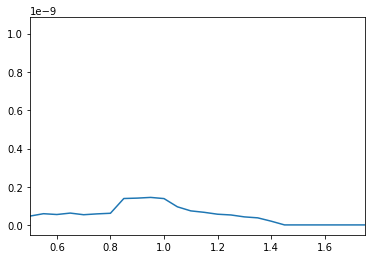

In [25]:
plt.plot(D4000_sSFR.index.to_numpy(),D4000_sSFR['sSFR_new'].to_numpy())
plt.xlim(0.5,1.75)
plt.show()

In [28]:
D4000_sSFR.index = np.floor(D4000_sSFR.index*20)/20

In [29]:
#D4000_sSFR.loc[:0.95,'sSFR_new'] = D4000_sSFR.loc[0.95,'sSFR_new']
#D4000_sSFR.loc[1.45:,'sSFR_new'] = D4000_sSFR.loc[1.45,'sSFR_new']
D4000_sSFR.index

Index([0.25,  0.3, 0.35,  0.4, 0.45,  0.5, 0.55,  0.6, 0.65,  0.7, 0.75,  0.8,
       0.85,  0.9, 0.95,  1.0, 1.05,  1.1, 1.15,  1.2, 1.25,  1.3, 1.35,  1.4,
       1.45,  1.5, 1.55,  1.6, 1.65,  1.7, 1.75,  1.8, 1.85,  1.9, 1.95,  2.0,
       2.05,  2.1, 2.15,  2.2, 2.25,  2.3, 2.35,  2.4, 2.45, 2.95,  3.5, 4.25],
      dtype='float64', name='D4000')

In [27]:
D4000_min = 0.9#np.min(D4000_sSFR.index)
D4000_max = 1.45#np.max(D4000_sSFR.index)
print(D4000_min,D4000_max)

0.9 1.45


In [30]:
import warnings
from spectral_cube.utils import SpectralCubeWarning
warnings.filterwarnings(action='ignore', category=SpectralCubeWarning,append=True)

In [31]:
Database = []
for n,source in enumerate(sources[:]):
    print(f'\nInitializing source {n+1} of {len(sources)}:',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90 # Position angle in degrees
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_lum = cosmo.luminosity_distance(z)
    D_ang = cosmo.angular_diameter_distance(z)
    Re = np.deg2rad(Re/3600)*D_ang.to(u.kpc).value # Effective radius in kpc
    hs = Re/(1.68*7.3) # disc scale height in kpc
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    
    # Deprojecting inclination effects
    reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    mom0 = reduced_cube.moment(order=0)
    dec, ra = mom0.world[:]
    ra = ra.value
    dec = dec.value
    rgrid, tgrid = deproject(ra, dec, [PA,inc,aca_table.loc[source,'RA'],aca_table.loc[source,'DEC']])
    rgrid = np.deg2rad(rgrid)*D_ang.to(u.kpc)
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    CO_vdisp = get_data(acaoutpath+source+'map_2nd.fits')
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    CO_int = np.where(np.log10(CO_vdisp)>-1,CO_int,np.nan)
    CO_vdisp = np.where(np.log10(CO_vdisp)>-1,CO_vdisp,np.nan)
    
    Mstar, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    Ha_mask = get_data(califaoutpath+source+'_Ha_mask.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    eF_Ha = get_data(califaoutpath+source+'_eF_Ha.fits')
    eF_Hb = get_data(califaoutpath+source+'_eF_Hb.fits')
    D4000 = get_data(califaoutpath+source+'_D4000.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0

    # defining beam properties for convolution
    fwhm_califa = 2.5
    fwhm_aca = 6.
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    
    Ha_to_Hb = np.where(F_Ha/F_Hb>2.86,F_Ha/F_Hb,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb = np.where(F_Ha>0,Ha_to_Hb,np.nan)
    # from Villanueva et al. 2023
    A_Ha = 5.86*np.log10(Ha_to_Hb/2.86)
    A_Ha_median = np.nanmedian(A_Ha[(A_Ha>0)&(F_Hb>eF_Hb)])
    A_Ha = np.where(~(F_Hb>eF_Hb)&(F_Ha>0),A_Ha_median,A_Ha)
    SFR = 7.9*(10**-(42+16))*F_Ha*np.power(10,A_Ha/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    # 1.6 factor converts from Salpeter IMF to Kroupa IMF
    #SFR = 1.6*7.9*(10**-(42+16))*F_Ha*np.power(10,A_Ha/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    
    D4_mask = (D4000>D4000_min)&(D4000<D4000_max)
    
    D4000_binned = D4000.copy()
    D4000_binned = create_bins(D4000_binned,D4_binwidth)
    D4000_binned = np.trunc(D4000_binned*100)/100
    #D4000_binned = np.where(D4000_binned<D4000_min,D4000_min,D4000_binned)
    #D4000_binned = np.where(D4000_binned>D4000_max,D4000_max,D4000_binned)
    D4000_binned = np.where(D4000_binned<D4000_min,np.nan,D4000_binned)
    D4000_binned = np.where(D4000_binned>D4000_max,np.nan,D4000_binned)
    sSFR_D4 = np.array([[D4000_sSFR.loc[element,'sSFR_new'] if ~np.isnan(element) else np.nan for element in row] for row in D4000_binned])
    SFR_D4 = sSFR_D4*Mstar
    
    
    # convolving CALIFA mpas to ACA resolution
    frames_cube = SpectralCube(data=np.array([Mstar,F_NII,F_OIII,F_Ha,F_Hb,SFR,SFR_D4]),wcs=WCS(califa_hdr3D))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)
    frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    
    area_factor = pix_area_aca.value/pix_area_califa.value
    reprojected_list = area_factor*np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    Ha_mask_rep = reproject_exact((Ha_mask&1,WCS(califa_hdr)),aca_hdr,return_footprint=False)
    D4_mask_rep = reproject_exact((D4_mask&1,WCS(califa_hdr)),aca_hdr,return_footprint=False)
    
    [Mstar_rep,F_NII_rep,F_OIII_rep,F_Ha_rep,F_Hb_rep,SFR_rep2,SFR_D4_rep] = reprojected_list
    
    Ha_to_Hb_rep = np.where(F_Ha_rep/F_Hb_rep>2.86,F_Ha_rep/F_Hb_rep,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb_rep = np.where(F_Ha_rep>0,Ha_to_Hb_rep,np.nan)
    # from Villanueva et al. 2023
    A_Ha_rep = 5.86*np.log10(Ha_to_Hb_rep/2.86)
    A_Ha_median_rep = np.nanmedian(A_Ha_rep[A_Ha_rep>0])
    A_Ha_rep = np.where(np.isnan(F_Hb_rep)&(F_Ha_rep>0),A_Ha_median_rep,A_Ha_rep)
    
    #SFR_rep = 1.6*7.9*(10**-(42+16))*F_Ha_rep*np.power(10,A_Ha_rep/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    SFR_rep = 7.9*(10**-(42+16))*F_Ha_rep*np.power(10,A_Ha_rep/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    #R_21_rep = S_SFR_rep**0.1
    #R_21_rep = (S_SFR_rep1**0.12)*(10**-0.06)
    
    S_Mstar_rep = Mstar_rep*cos/pix_area_aca.value # stellar mass surface density in M_sun pc^-2
    S_SFR_rep = SFR_rep*cos/pix_area_aca.value
    S_SFR_rep2  = SFR_rep2 *cos/pix_area_aca.value
    S_SFR_D4_rep = SFR_D4_rep*cos/pix_area_aca.value
    
    # from Bolatto et al. 2017 and Marino et al. 2013:
    O3N2_rep = np.log10(F_OIII_rep*F_Ha_rep/(F_Hb_rep*F_NII_rep))
    N2_rep = np.log10(F_NII_rep/F_Ha_rep)
    Z_O3N2_rep = np.power(10,-12 + 8.533 - 0.214*O3N2_rep)/Z_sun
    Z_N2_rep = np.power(10,-12 + 8.743 + 0.462*N2_rep)/Z_sun
    # from Bolatto et al. 2013
    S_GMC = 1
    # using 10^8 instead of 100 because S_Mstar is in M_sun kpc^-2 instead of M_sun pc^-2
    alphaCO_O3N2_rep = 2.9*np.exp(0.4/(S_GMC*Z_O3N2_rep))*np.power(S_Mstar_rep/10**8,np.where(S_Mstar_rep>10**8,-0.5,0))
    alphaCO_N2_rep = 2.9*np.exp(0.4/(S_GMC*Z_N2_rep))*np.power(S_Mstar_rep/10**8,np.where(S_Mstar_rep>10**8,-0.5,0))
    
    # from Barrera-Ballesteros et al. 2021
    #star_vdisp = np.sqrt(2*np.pi*G*S_Mstar_rep*hs)*u.kpc.to(u.km) # stellar velocity dispersion in km s^-1
    
    smoothmask = get_data(acaoutpath+source+'_smoothmask.fits')
    nchannels = np.sum(smoothmask,axis=0)
    
    #flat_region = np.where(Mstar_rep.flatten()>0,True,False)
    flat_region = Mstar_rep.flatten()>0

    Partial_Database = pd.DataFrame({'Source':np.broadcast_to(source,S_Mstar_rep.flatten().shape)[flat_region],
                                     'Final_QS':np.broadcast_to(QS,S_Mstar_rep.flatten().shape)[flat_region],
                                     'Final_NA':np.broadcast_to(NA,S_Mstar_rep.flatten().shape)[flat_region],
                                     'Inclination':np.broadcast_to(inc,S_Mstar_rep.flatten().shape)[flat_region],
                                     'PA':np.broadcast_to(PA,S_Mstar_rep.flatten().shape)[flat_region],
                                     'Area_kpc2':np.broadcast_to(pix_area_aca.value/cos,S_Mstar_rep.flatten().shape)[flat_region],
                                     'Re_kpc':np.broadcast_to(Re,S_Mstar_rep.flatten().shape)[flat_region],
                                     'Rgal_kpc':rgrid.flatten()[flat_region],
                                     'RA':ra.flatten()[flat_region],
                                     'DEC':dec.flatten()[flat_region],
                                     'T_gal':tgrid.flatten()[flat_region],
                                     'S_Mstar':S_Mstar_rep.flatten()[flat_region],
                                     'S_SFR':S_SFR_rep.flatten()[flat_region],
                                     'S_SFR2':S_SFR_rep2.flatten()[flat_region],
                                     'S_SFR_D4':S_SFR_D4_rep.flatten()[flat_region],
                                     'Ha_mask':Ha_mask_rep.flatten()[flat_region],
                                     'D4_mask':D4_mask_rep.flatten()[flat_region],
                                     'Z_O3N2':Z_O3N2_rep.flatten()[flat_region],
                                     'Z_N2':Z_N2_rep.flatten()[flat_region],
                                     'alphaCO_O3N2':alphaCO_O3N2_rep.flatten()[flat_region],
                                     'alphaCO_N2':alphaCO_N2_rep.flatten()[flat_region],
                                     'CO_int':CO_int.flatten()[flat_region],
                                     'CO_nchannels':nchannels.flatten()[flat_region],
                                     'CO_vdisp':CO_vdisp.flatten()[flat_region]})
    Database.append(Partial_Database)


Initializing source 0 of 58: CGCG429-012

Initializing source 1 of 58: IC1079

Initializing source 2 of 58: IC1528

Initializing source 3 of 58: IC2341


/users/brodriguez/.local/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)



Initializing source 4 of 58: MCG-01-01-012

Initializing source 5 of 58: MCG-01-10-015

Initializing source 6 of 58: MCG-01-52-012

Initializing source 7 of 58: MCG-02-02-030

Initializing source 8 of 58: MCG-02-51-004

Initializing source 9 of 58: NGC0001

Initializing source 10 of 58: NGC0155

Initializing source 11 of 58: NGC0169

Initializing source 12 of 58: NGC0171

Initializing source 13 of 58: NGC0180

Initializing source 14 of 58: NGC0693

Initializing source 15 of 58: NGC0731

Initializing source 16 of 58: NGC0768

Initializing source 17 of 58: NGC0955

Initializing source 18 of 58: NGC1056

Initializing source 19 of 58: NGC1542

Initializing source 20 of 58: NGC2449

Initializing source 21 of 58: NGC2540

Initializing source 22 of 58: NGC2554

Initializing source 23 of 58: NGC2595

Initializing source 24 of 58: NGC3300

Initializing source 25 of 58: NGC6427

Initializing source 26 of 58: NGC7025

Initializing source 27 of 58: NGC7194

Initializing source 28 of 58: NGC7311



In [32]:
Database = pd.concat(Database,ignore_index=True)
Database.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87463 entries, 0 to 87462
Data columns (total 24 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Source        87463 non-null  object 
 1   Final_QS      87463 non-null  object 
 2   Final_NA      87463 non-null  object 
 3   Inclination   87463 non-null  float64
 4   PA            87463 non-null  float64
 5   Area_kpc2     87463 non-null  float64
 6   Re_kpc        87463 non-null  float64
 7   Rgal_kpc      87463 non-null  float64
 8   RA            87463 non-null  float64
 9   DEC           87463 non-null  float64
 10  T_gal         87463 non-null  float64
 11  S_Mstar       87463 non-null  float64
 12  S_SFR         87128 non-null  float64
 13  S_SFR2        87463 non-null  float64
 14  S_SFR_D4      87463 non-null  float64
 15  Ha_mask       87463 non-null  float64
 16  D4_mask       87463 non-null  float64
 17  Z_O3N2        80468 non-null  float64
 18  Z_N2          84993 non-nu

In [33]:
Database.to_csv('/users/brodriguez/Documents/ACA_database_'+strftime("%Y-%m-%d",localtime())+'.csv',index=False)

In [25]:
Database['log_S_SFR'] = np.log10(Database['S_SFR'])
Database['log_S_SFR2'] = np.log10(Database['S_SFR2'])
Database['log_S_SFR_D4'] = np.log10(Database['S_SFR_D4'])

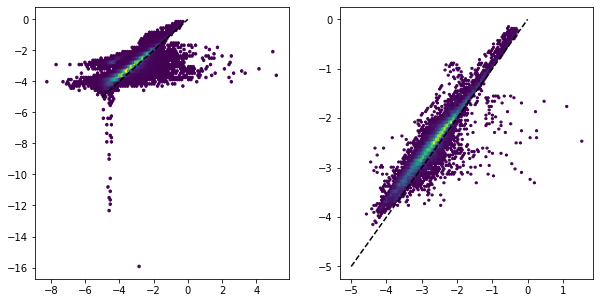

In [27]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
axs[0].hexbin(Database['log_S_SFR'],Database['log_S_SFR2'],mincnt=1)
axs[1].hexbin(Database.loc[np.floor(Database['Ha_mask'])==1,'log_S_SFR'],Database.loc[np.floor(Database['Ha_mask'])==1,'log_S_SFR2'],mincnt=1)
axs[0].plot([-5,0],[-5,0],c='k',ls='--')
axs[1].plot([-5,0],[-5,0],c='k',ls='--')
plt.show()

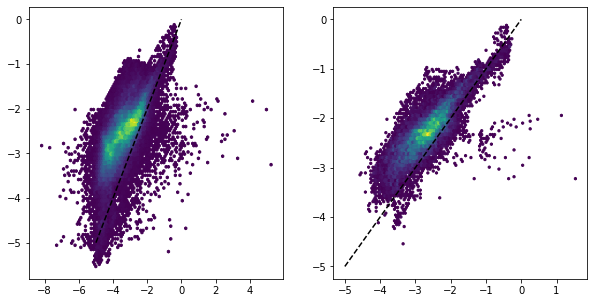

In [28]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
axs[0].hexbin(Database['log_S_SFR'],Database['log_S_SFR_D4'],mincnt=1)
axs[1].hexbin(Database.loc[np.floor(Database['Ha_mask'])==1,'log_S_SFR'],Database.loc[np.floor(Database['Ha_mask'])==1,'log_S_SFR_D4'],mincnt=1)
axs[0].plot([-5,0],[-5,0],c='k',ls='--')
axs[1].plot([-5,0],[-5,0],c='k',ls='--')
plt.show()

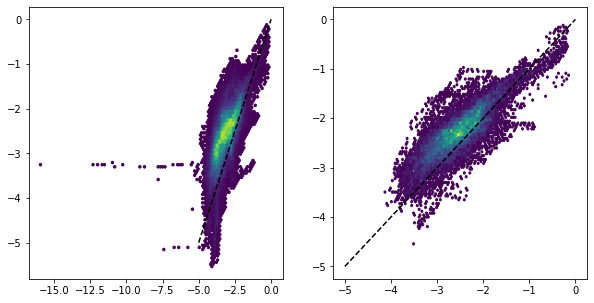

In [29]:
fig, axs = plt.subplots(1,2,figsize=(10,5))
axs[0].hexbin(Database['log_S_SFR2'],Database['log_S_SFR_D4'],mincnt=1)
axs[1].hexbin(Database.loc[np.floor(Database['Ha_mask'])==1,'log_S_SFR2'],Database.loc[np.floor(Database['Ha_mask'])==1,'log_S_SFR_D4'],mincnt=1)
axs[0].plot([-5,0],[-5,0],c='k',ls='--')
axs[1].plot([-5,0],[-5,0],c='k',ls='--')
plt.show()

In [280]:
Database = []
for source in sources[:]:
    print('\nInitializing source',source)
    z = aca_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']-90
    Re = aca_table.loc[source,'Re_arc_califa'] # Effective radius in arcsec
    D_lum = cosmo.luminosity_distance(z)
    D_ang = cosmo.angular_diameter_distance(z)
    #print(f'Luminsoty distance at z = {z:.4}: {D_lum:.5}')
    #print(f'Angular diameter distance at z = {z:.4}: {D_ang:.5}')
    Re = np.deg2rad(Re/3600)*D_ang.to(u.kpc).value # Effective radius in kpc
    hs = Re/(1.68*7.3) # disc scale height in kpc
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    print(QS,NA)
    
    reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    mom0 = reduced_cube.moment(order=0)
    dec, ra = mom0.world[:]
    ra = ra.value
    dec = dec.value
    rgrid, tgrid = deproject(ra, dec, [PA,inc,aca_table.loc[source,'RA'],aca_table.loc[source,'DEC']])
    rgrid = np.deg2rad(rgrid)*D_ang.to(u.kpc)
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    CO_vdisp = get_data(acaoutpath+source+'map_2nd.fits')
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    
    M_star, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    M_star *= 1.6
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    Ha_mask = get_data(califaoutpath+source+'_Ha_mask.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    eF_Ha = get_data(califaoutpath+source+'_eF_Ha.fits')
    eF_Hb = get_data(califaoutpath+source+'_eF_Hb.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0

    # convolving CALIFA mpas to ACA resolution
    fwhm_califa = 2.5
    fwhm_aca = 6.
    ppbeam_califa = (fwhm_califa/pix_scale_califa/2)**2 / np.log(2)*np.pi
    ppbeam_aca = (fwhm_aca/pix_scale_aca/2)**2 / np.log(2)*np.pi
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    
    frames_cube = SpectralCube(data=np.array([M_star,F_NII,F_OIII,F_Ha,F_Hb,eF_Ha**2,eF_Hb**2]),wcs=WCS(califa_hdr3D))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)
    frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    frames_cube_convolved[-1] = np.sqrt(frames_cube_convolved[-1])*np.sqrt(ppbeam_califa/ppbeam_aca)
    frames_cube_convolved[-2] = np.sqrt(frames_cube_convolved[-2])*np.sqrt(ppbeam_califa/ppbeam_aca)
    
    area_factor = pix_area_aca.value/pix_area_califa.value
    reprojected_list = area_factor*np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    Ha_mask_rep = reproject_exact((Ha_mask&1,WCS(califa_hdr)),aca_hdr,return_footprint=False)
    
    [M_star_rep,F_NII_rep,F_OIII_rep,F_Ha_rep,F_Hb_rep,eF_Ha_rep,eF_Hb_rep] = reprojected_list
    
    S_star_rep = M_star_rep*cos/pix_area_aca.to(u.kpc**2).value # stellar mass surface density in M_sun pc^-2
    
    Ha_to_Hb_rep = np.where(F_Ha_rep/F_Hb_rep>2.86,F_Ha_rep/F_Hb_rep,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb_rep = np.where(np.isfinite(F_Ha_rep),Ha_to_Hb_rep,np.nan)
    # from Villanueva et al. 2023
    A_Ha_rep = 5.86*np.log10(Ha_to_Hb_rep/2.86)
    A_Ha_mean_rep = np.nanmean(A_Ha_rep[A_Ha_rep>0])
    A_Ha_rep = np.where(np.isnan(F_Hb_rep)&~np.isnan(F_Ha_rep),A_Ha_mean_rep,A_Ha_rep)
    
    SFR_rep = 1.6*7.9*(10**-(42+16))*F_Ha_rep*np.power(10,A_Ha_rep/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    S_SFR_rep = SFR_rep*cos/pix_area_aca.value
    R_21_rep = S_SFR_rep**0.1
    
    # from Bolatto et al. 2017 and Marino et al. 2013:
    O3N2_rep = np.log10(F_OIII_rep*F_Ha_rep/(F_Hb_rep*F_NII_rep))
    N2_rep = np.log10(F_NII_rep/F_Ha_rep)
    Z_O3N2_rep = np.power(10,-12 + 8.533 - 0.214*O3N2_rep)/Z_sun
    Z_N2_rep = np.power(10,-12 + 8.743 + 0.462*N2_rep)/Z_sun
    
    # from Bolatto et al. 2013
    S_GMC = 1
    # using 10^8 instead of 100 because S_star is in M_sun kpc^-2 instead of M_sun pc^-2
    alphaCO_O3N2_rep = 2.9*np.exp(0.4/(S_GMC*Z_O3N2_rep))*np.power(S_star_rep/10**8,np.where(S_star_rep>10**8,-0.5,0))
    alphaCO_N2_rep = 2.9*np.exp(0.4/(S_GMC*Z_N2_rep))*np.power(S_star_rep/10**8,np.where(S_star_rep>10**8,-0.5,0))
    
    # 10^6 factor converts from pc^-2 in alpha_CO to kpc^-2
    #S_mol_MW  = CO_int*cos*alphaCO_MW      *10**6/R_21_rep
    S_mol_O3N2 = CO_int*cos*alphaCO_O3N2_rep*10**6/R_21_rep
    #S_mol_N2  = CO_int*cos*alphaCO_N2_rep  *10**6/R_21_rep
    
    # from Barrera-Ballesteros et al. 2021
    star_vdisp = np.sqrt(2*np.pi*G*S_star_rep*hs)*u.kpc.to(u.km) # stellar velocity dispersion in km s^-1
    # from Elmegreen et al. 1989
    Ph_rep = (np.pi*G/2)*(S_mol_O3N2+S_H1)*((S_mol_O3N2+S_H1)+S_star_rep*CO_vdisp/star_vdisp)
    Ph_rep = Ph_rep/k_B/(u.kpc**3).to(u.cm**3)
    # from Kim, Kim & Ostriker 2011 and Sun et al. 2020
    Pde_rep = (np.pi*G/2)*(S_mol_O3N2+S_H1)**2 + (S_mol_O3N2+S_H1)*np.sqrt(G*S_star_rep/hs/2)*CO_vdisp/u.kpc.to(u.km)
    Pde_rep = Pde_rep/k_B/(u.kpc**3).to(u.cm**3)
    
    f_CO_rep = S_mol_O3N2/S_star_rep
    sSFR_rep = SFR_rep/M_star_rep
    SFE_rep  = S_SFR_rep/S_mol_O3N2
    flat_region = np.where(M_star_rep.flatten()>0,True,False)

    Partial_Database = pd.DataFrame({'Source':np.broadcast_to(source,S_star_rep.flatten().shape)[flat_region],
                                     'Final_QS':np.broadcast_to(QS,S_star_rep.flatten().shape)[flat_region],
                                     'Final_NA':np.broadcast_to(NA,S_star_rep.flatten().shape)[flat_region],
                                     'Inclination':np.broadcast_to(inc,S_star_rep.flatten().shape)[flat_region],
                                     'PA':np.broadcast_to(PA,S_star_rep.flatten().shape)[flat_region],
                                     'Re_kpc':np.broadcast_to(Re,S_star_rep.flatten().shape)[flat_region],
                                     'RA':ra.flatten()[flat_region],
                                     'DEC':dec.flatten()[flat_region],
                                     'Rgal_kpc':rgrid.flatten()[flat_region],
                                     'T_gal':tgrid.flatten()[flat_region],
                                     'S_Mstar':S_star_rep.flatten()[flat_region],
                                     'S_SFR':S_SFR_rep.flatten()[flat_region],
                                     'Ha_mask':Ha_mask_rep.flatten()[flat_region],
                                     'R_21':R_21_rep.flatten()[flat_region],
                                     'Z_O3N2':Z_O3N2_rep.flatten()[flat_region],
                                     'Z_N2':Z_N2_rep.flatten()[flat_region],
                                     'alphaCO_O3N2':alphaCO_O3N2_rep.flatten()[flat_region],
                                     'alphaCO_N2':alphaCO_N2_rep.flatten()[flat_region],
                                     'S_mol_O3N2':S_mol_O3N2.flatten()[flat_region],
                                     'CO_vdisp':CO_vdisp.flatten()[flat_region],
                                     'star_vdisp':star_vdisp.flatten()[flat_region],
                                     'f_CO':f_CO_rep.flatten()[flat_region],
                                     'sSFR':sSFR_rep.flatten()[flat_region],
                                     'SFE':SFE_rep.flatten()[flat_region],
                                     'P_h':Ph_rep.flatten()[flat_region],
                                     'P_DE':Pde_rep.flatten()[flat_region]})
    Database.append(Partial_Database)


Initializing source CGCG429-012
fR nonA

Initializing source IC1079
MX nonA

Initializing source IC1528
SF nonA

Initializing source IC2341
fR nonA

Initializing source MCG-01-01-012
MX nonA

Initializing source MCG-01-10-015
SF nonA

Initializing source MCG-01-52-012
nR nonA

Initializing source MCG-02-02-030
QnR sAGN

Initializing source MCG-02-51-004
SF nonA

Initializing source NGC0001
SF nonA

Initializing source NGC0155
fR nonA

Initializing source NGC0169
MX wAGN

Initializing source NGC0171
cQ nonA

Initializing source NGC0180
QnR nonA

Initializing source NGC0693
SF nonA

Initializing source NGC0731
fR nonA

Initializing source NGC0768
SF nonA

Initializing source NGC0955
nR nonA

Initializing source NGC1056
SF nonA

Initializing source NGC1542
MX nonA

Initializing source NGC2449
MX nonA

Initializing source NGC2540
SF nonA

Initializing source NGC2554
nR wAGN

Initializing source NGC2595
QnR nonA

Initializing source NGC3300
fR nonA

Initializing source NGC6427
fR nonA

Ini

In [281]:
Database = pd.concat(Database,ignore_index=True)
Database

,Source,Final_QS,Final_NA,Inclination,PA,Re_kpc,RA,DEC,Rgal_kpc,T_gal,...,alphaCO_O3N2,alphaCO_N2,S_mol_O3N2,CO_vdisp,star_vdisp,f_CO,sSFR,SFE,P_h,P_DE
0,CGCG429-012,fR,nonA,59.991884,6.449515,1.397272,339.209394,14.378665,12.518788,-2.541135,...,4.342843,3.992809,NaN,NaN,1.732646,NaN,1.427581e-11,NaN,NaN,NaN
1,CGCG429-012,fR,nonA,59.991884,6.449515,1.397272,339.208964,14.378665,12.002631,-2.617069,...,4.662306,4.193988,NaN,NaN,1.796422,NaN,1.358039e-11,NaN,NaN,NaN
2,CGCG429-012,fR,nonA,59.991884,6.449515,1.397272,339.208534,14.378665,11.561619,-2.699303,...,5.077261,4.663437,NaN,NaN,1.862751,NaN,1.673094e-11,NaN,NaN,NaN
3,CGCG429-012,fR,nonA,59.991884,6.449515,1.397272,339.208104,14.378665,11.204629,-2.787408,...,5.457726,5.266703,NaN,NaN,1.924607,NaN,2.147072e-11,NaN,NaN,NaN
4,CGCG429-012,fR,nonA,59.991884,6.449515,1.397272,339.207244,14.378665,10.774203,-2.977394,...,6.630550,6.229237,NaN,NaN,2.047223,NaN,2.043582e-11,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87458,VV488NED02,SF,nonA,73.160751,68.756316,3.143968,344.205560,-8.962386,29.284013,1.725595,...,6.223236,5.606821,NaN,NaN,2.900236,NaN,5.364717e-10,NaN,NaN,NaN
87459,VV488NED02,SF,nonA,73.160751,68.756316,3.143968,344.205279,-8.962386,29.745294,1.733761,...,6.326578,5.701627,NaN,NaN,2.922467,NaN,5.843134e-10,NaN,NaN,NaN
87460,VV488NED02,SF,nonA,73.160751,68.756316,3.143968,344.216246,-8.961830,16.989412,1.110715,...,5.349539,5.075181,NaN,NaN,4.504568,NaN,4.136860e-11,NaN,NaN,NaN
87461,VV488NED02,SF,nonA,73.160751,68.756316,3.143968,344.216246,-8.961552,18.008724,1.131169,...,5.247439,5.060841,NaN,NaN,4.596295,NaN,4.094734e-11,NaN,NaN,NaN


In [279]:
Database.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87463 entries, 0 to 87462
Data columns (total 26 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Source        87463 non-null  object 
 1   Final_QS      87463 non-null  object 
 2   Final_NA      87463 non-null  object 
 3   Inclination   87463 non-null  float64
 4   PA            87463 non-null  float64
 5   Re_kpc        87463 non-null  float64
 6   RA            87463 non-null  float64
 7   DEC           87463 non-null  float64
 8   Rgal_kpc      87463 non-null  float64
 9   T_gal         87463 non-null  float64
 10  S_Mstar       87463 non-null  float64
 11  S_SFR         87463 non-null  float64
 12  Ha_mask       87463 non-null  float64
 13  R_21          87128 non-null  float64
 14  Z_O3N2        80468 non-null  float64
 15  Z_N2          84993 non-null  float64
 16  alphaCO_O3N2  80468 non-null  float64
 17  alphaCO_N2    84993 non-null  float64
 18  S_mol_O3N2    45864 non-nu

In [282]:
Database.to_csv('/users/brodriguez/Documents/ACA_database_'+strftime("%Y-%m-%d",localtime())+'.csv',index=False)

(1.0, 1.0, 1.0, 1.0)
(1.0, 1.0, 1.0, 1.0)


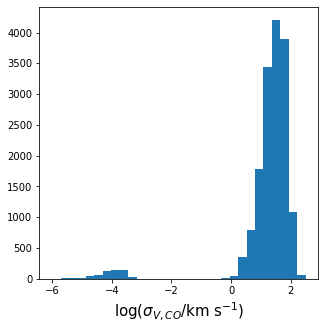

In [232]:
fig, ax = plt.subplots(figsize=(5,5))
ax.hist(np.log10(Database_SF['CO_vdisp']),bins=np.linspace(-6,2.5,31))
ax.set_xlabel('log($\sigma_{V,CO}$/km s$^{-1}$)',fontsize=15)
print(ax.get_facecolor())
#fig.set_facecolor((0.,0.,0.,0.))
print(fig.get_facecolor())
plt.show()

(1.0, 1.0, 1.0, 1.0)
(1.0, 1.0, 1.0, 1.0)


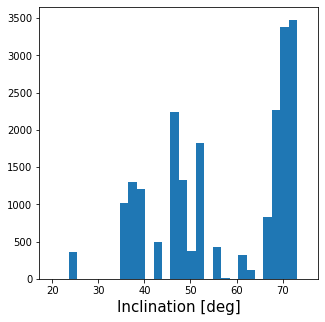

In [275]:
fig, ax = plt.subplots(figsize=(5,5))
ax.hist(Database_SF['Inclination'],bins=np.linspace(20,75,31))
ax.set_xlabel('Inclination [deg]',fontsize=15)
print(ax.get_facecolor())
#fig.set_facecolor((0.,0.,0.,0.))
print(fig.get_facecolor())
plt.show()


Initializing source UGC01368
Luminsoty distance at z = 0.02652: 116.39 Mpc
SF nonA
4.000000000000577
0.8333333333333932


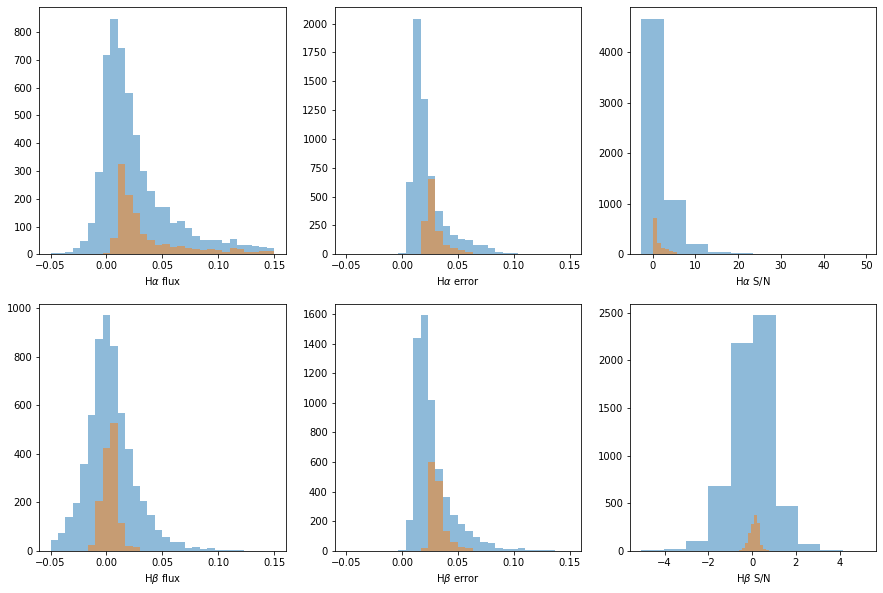

True
False
False


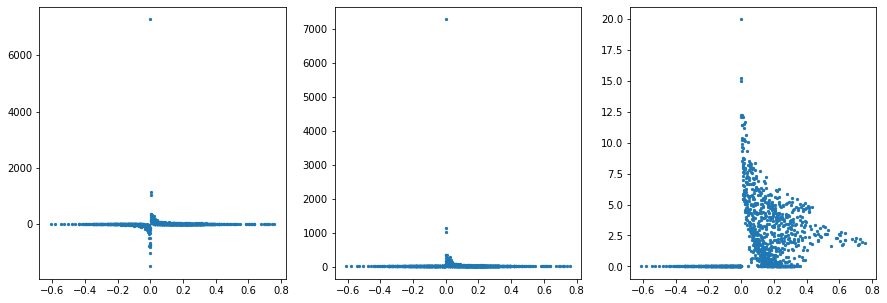

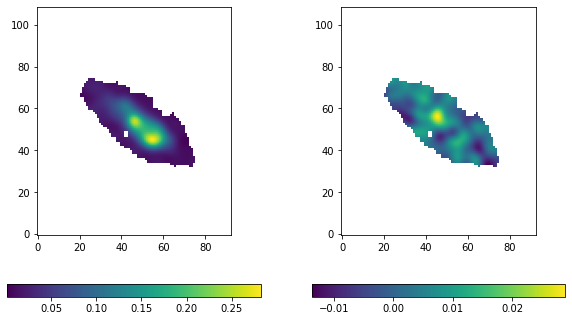

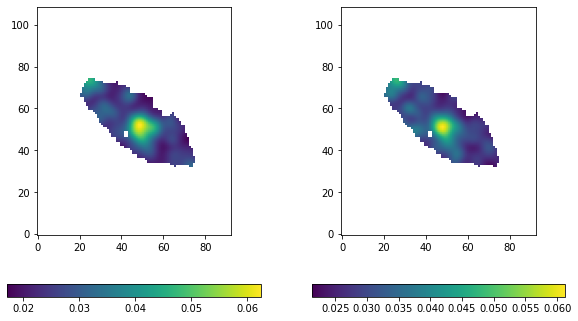

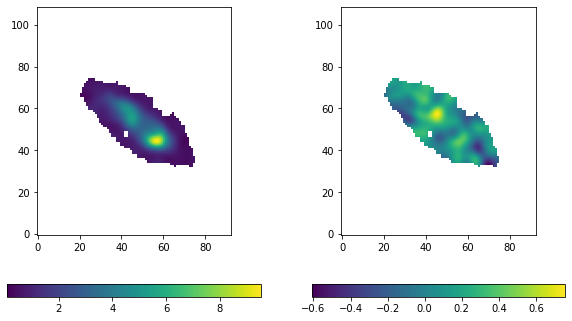

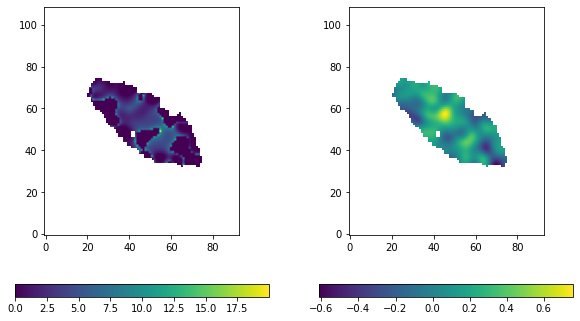

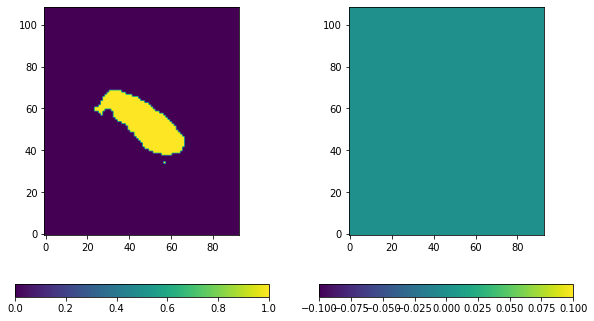

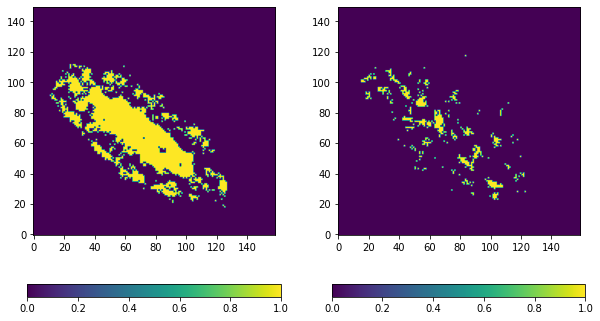

/tmp/ipykernel_870345/2200876307.py:162: RuntimeWarning: Mean of empty slice
  A_Ha_mean_rep = np.nanmean(A_Ha_rep[(A_Ha_rep>=0)&(F_Hb_rep>eF_Hb_rep)])


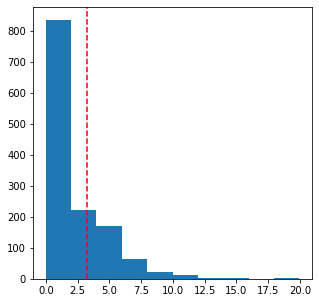

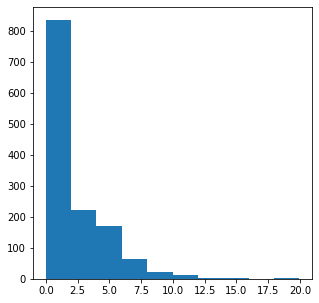

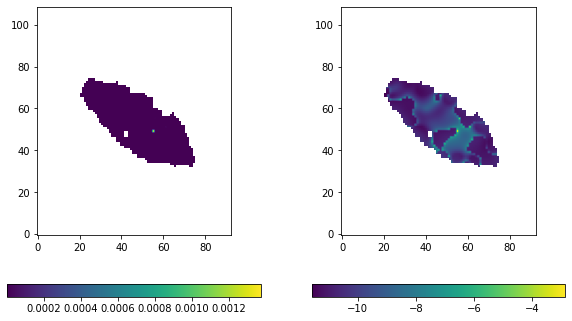

In [258]:
for source in ['UGC01368']:
    print('\nInitializing source',source)
    z = califa_table.loc[source,'z_stars']
    inc = aca_table.loc[source,'inclination_califa']
    cos = np.cos(np.deg2rad(inc))
    PA = aca_table.loc[source,'PA_califa']
    Re = califa_table.loc[source,'Re_kpc'] # Effective radius in kpc
    hs = Re/(1.68*7.3) # disc scale height in kpc
    D_lum = cosmo.luminosity_distance(z)
    D_ang = cosmo.angular_diameter_distance(z)
    print(f'Luminsoty distance at z = {z:.4}: {D_lum:.5}')
    #print(f'Angular diameter distance at z = {z:.4}: {D_ang:.5}')
    QS = aca_table.loc[source,'Final_QS']
    NA = aca_table.loc[source,'Final_NA']
    print(QS,NA)
    
    #reduced_cube = SpectralCube.read(acaoutpath+source+'_reduced.fits')
    #mom0 = reduced_cube.moment(order=0)
    #dec, ra = mom0.world[:]
    #ra = ra.value
    #dec = dec.value
    #rgrid, tgrid = deproject(ra, dec, [PA,inc,aca_table.loc[source,'RA'],aca_table.loc[source,'DEC']])
    #rgrid = np.deg2rad(rgrid)*D_ang.to(u.kpc)
    
    CO_int, aca_hdr = get_data(acaoutpath+source+'_integrated.fits',header=True)
    CO_vdisp = get_data(acaoutpath+source+'map_2nd.fits')
    pix_scale_aca = aca_hdr['CDELT2']*3600 # spaxel size in arcsec
    pix_area_aca = ((np.deg2rad(aca_hdr['CDELT2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of ACA spaxel: {pix_scale_aca:.2} arcsec')
    #print(f'Surface area per ACA spaxel: {pix_area_aca:.6}')
    
    M_star, califa_hdr = get_data(califaoutpath+source+'_Mstar.fits',header=True)
    region, califa_hdr3D = get_data(califaoutpath+source+'_region.fits',header=True)
    pix_scale_califa = califa_hdr['PC2_2']*3600 # pixel size in arcsec
    pix_area_califa = ((np.deg2rad(califa_hdr['PC2_2'])*D_ang)**2).to(u.kpc**2)
    #print(f'Angular size of CALIFA pixel: {pix_scale_califa:.2} arcsec')
    #print(f'Surface area per CALIFA pixel: {pix_area_califa:.6}\n')
    
    Ha_mask = get_data(califaoutpath+source+'_Ha_mask.fits')
    F_NII = get_data(califaoutpath+source+'_F_NII.fits')
    F_OIII = get_data(califaoutpath+source+'_F_OIII.fits')
    F_Ha = get_data(califaoutpath+source+'_F_Ha.fits')
    F_Hb = get_data(califaoutpath+source+'_F_Hb.fits')
    eF_Ha = get_data(califaoutpath+source+'_eF_Ha.fits')
    eF_Hb = get_data(califaoutpath+source+'_eF_Hb.fits')
    califa_hdr3D['NAXIS1'] = 0
    califa_hdr3D['NAXIS2'] = 0
    #print(califa_hdr)
    #print(WCS(califa_hdr3D))
    #print(WCS(califa_hdr))
    # convolving CALIFA mpas to ACA resolution
    fwhm_califa = 2.5
    fwhm_aca = 6.
    ppbeam_califa = (fwhm_califa/pix_scale_califa/2)**2 / np.log(2)*np.pi
    ppbeam_aca = (fwhm_aca/pix_scale_aca/2)**2 / np.log(2)*np.pi
    beam_califa = radio_beam.Beam(major=fwhm_califa*u.arcsec, minor=fwhm_califa*u.arcsec, pa=0*u.deg)
    beam_aca = radio_beam.Beam(major=fwhm_aca*u.arcsec, minor=fwhm_aca*u.arcsec, pa=0*u.deg)
    area_factor = pix_area_aca.value/pix_area_califa.value
    scale_factor = np.sqrt(ppbeam_califa/ppbeam_aca)
    
    frames_cube = SpectralCube(data=np.array([M_star,F_NII,F_OIII,F_Ha,F_Hb,eF_Ha**2,eF_Hb**2]),wcs=WCS(califa_hdr3D))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)
    frames_cube_convolved = frames_cube.convolve_to(beam_aca)
    frames_cube_convolved = np.array([frame for frame in frames_cube_convolved])
    #frames_cube_convolved[0:5] *= area_factor
    frames_cube_convolved[-1] = np.sqrt(frames_cube_convolved[-1])#*scale_factor
    frames_cube_convolved[-2] = np.sqrt(frames_cube_convolved[-2])#*scale_factor
    
    print(area_factor)
    print(np.sqrt(ppbeam_califa/ppbeam_aca))
    reprojected_list = np.array([reproject_exact((frame,WCS(califa_hdr)),aca_hdr,return_footprint=False) for frame in frames_cube_convolved])
    Ha_mask_rep = reproject_exact((Ha_mask&1,WCS(califa_hdr)),aca_hdr,return_footprint=False)
    
    [M_star_rep,F_NII_rep,F_OIII_rep,F_Ha_rep,F_Hb_rep,eF_Ha_rep,eF_Hb_rep] = reprojected_list
    
    S_star_rep = M_star_rep*cos/pix_area_aca.to(u.kpc**2).value # stellar mass surface density in M_sun pc^-2
        
    Ha_to_Hb_rep = np.where(F_Ha_rep/F_Hb_rep>2.86,F_Ha_rep/F_Hb_rep,2.86) # imposing minimum ratio of 2.86
    Ha_to_Hb_rep = np.where(np.isfinite(F_Ha_rep),Ha_to_Hb_rep,np.nan)
    
    fig, axs = plt.subplots(2,3,figsize=(15,10))
    axs[0,0].hist(F_Ha.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[0,0].hist(F_Ha_rep.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[0,0].set_xlabel(r'H$\alpha$ flux')
    axs[0,1].hist(eF_Ha.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[0,1].hist(eF_Ha_rep.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[0,1].set_xlabel(r'H$\alpha$ error')
    axs[0,2].hist(F_Ha.flatten()/eF_Ha.flatten(),alpha=0.5)#,bins=np.linspace(-0.05,0.15,31))
    axs[0,2].hist(F_Ha_rep.flatten()/eF_Ha_rep.flatten(),alpha=0.5)#,bins=np.linspace(-0.05,0.15,31))
    axs[0,2].set_xlabel(r'H$\alpha$ S/N')
    axs[1,0].hist(F_Hb.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[1,0].hist(F_Hb_rep.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[1,0].set_xlabel(r'H$\beta$ flux')
    axs[1,1].hist(eF_Hb.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[1,1].hist(eF_Hb_rep.flatten(),alpha=0.5,bins=np.linspace(-0.05,0.15,31))
    axs[1,1].set_xlabel(r'H$\beta$ error')
    axs[1,2].hist(F_Hb.flatten()/eF_Hb.flatten(),alpha=0.5)#,bins=np.linspace(-0.05,0.15,31))
    axs[1,2].hist(F_Hb_rep.flatten()/eF_Hb_rep.flatten(),alpha=0.5)#,bins=np.linspace(-0.05,0.15,31))
    axs[1,2].set_xlabel(r'H$\beta$ S/N')
    
    #ax[,].axvline(A_Ha_mean_rep,c='k',ls='-')
    #ax[,].axvline(A_Ha_median_rep,c='r',ls='--')
    plt.show()
    
    # from Villanueva et al. 2023
    A_Ha_rep = 5.86*np.log10(Ha_to_Hb_rep/2.86)
    
    print((F_Ha_rep>eF_Ha_rep).any())
    print((F_Hb_rep>eF_Hb_rep).any())
    print(((A_Ha_rep>=0)&(F_Hb_rep>eF_Hb_rep)).any())
    
    fig, axs = plt.subplots(1,3,figsize=(15,5))
    axs[0].scatter(F_Hb_rep/eF_Hb_rep,F_Ha_rep/F_Hb_rep,s=5)
    axs[1].scatter(F_Hb_rep/eF_Hb_rep,Ha_to_Hb_rep,s=5)
    axs[2].scatter(F_Hb_rep/eF_Hb_rep,A_Ha_rep,s=5)
    plt.show()
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(F_Ha_rep,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(F_Hb_rep,origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(eF_Ha_rep,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(eF_Hb_rep,origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(F_Ha_rep/eF_Ha_rep,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(F_Hb_rep/eF_Hb_rep,origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(A_Ha_rep,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(F_Hb_rep/eF_Hb_rep,origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(F_Ha_rep/eF_Ha_rep>1,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(F_Hb_rep/eF_Hb_rep>1,origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(F_Ha/eF_Ha>1,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(F_Hb/eF_Hb>1,origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()
    
    A_Ha_mean_rep = np.nanmean(A_Ha_rep[A_Ha_rep>0])
    A_Ha_mean_rep = np.nanmean(A_Ha_rep[(A_Ha_rep>=0)&(F_Hb_rep>eF_Hb_rep)])
    A_Ha_median_rep = np.nanmedian(A_Ha_rep[A_Ha_rep>0])
    
    fig, ax = plt.subplots(figsize=(5,5))
    ax.hist(A_Ha_rep.flatten())
    ax.axvline(A_Ha_mean_rep,c='k',ls='-')
    ax.axvline(A_Ha_median_rep,c='r',ls='--')
    plt.show()
    
    #A_Ha_rep = np.where(~(F_Hb_rep>eF_Hb_rep)&~np.isnan(F_Ha_rep),A_Ha_mean_rep,A_Ha_rep)
    
    A_Ha_rep = np.where(np.isnan(F_Hb_rep)&~np.isnan(F_Ha_rep),A_Ha_median_rep,A_Ha_rep)
    
    fig, ax = plt.subplots(figsize=(5,5))
    ax.hist(A_Ha_rep.flatten())
    #ax.axvline(A_Ha_mean_rep,c='k',ls='-')
    #ax.axvline(A_Ha_median_rep,c='r',ls='--')
    plt.show()
    
    SFR_rep = 1.61*7.9*(10**-(42+16))*F_Ha_rep*np.power(10,A_Ha_rep/2.5)*4*np.pi*(D_lum**2).to(u.cm**2).value
    S_SFR_rep = SFR_rep*cos/pix_area_aca.value
    
    fig, axs = plt.subplots(1,2,figsize=(10,6))
    im = axs[0].imshow(S_SFR_rep/S_star_rep,origin='lower')
    fig.colorbar(im,ax=axs[0],orientation='horizontal')
    im = axs[1].imshow(np.log10(S_SFR_rep/S_star_rep),origin='lower')
    fig.colorbar(im,ax=axs[1],orientation='horizontal')
    plt.show()


In [ ]:
fig, axs = plt.subplots(2,2,figsize=(10,10))#,sharex='col',sharey='row')
for ax,frame,title,label in zip(axs.ravel(),[np.log10(Database_SF['f_CO']),np.log10(Database_SF['S_SFR']),np.log10(Database_SF['sSFR']),np.log10(Database_SF['SFE'])],
                          [r'$f_\mathrm{CO}$',r'$\Sigma_\mathrm{SFR}$','sSFR','SFE'],[r'log($f_\mathrm{CO}$)',r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)',r'log(sSFR/yr$^{-1}$)',r'log(SFE/yr$^{-1}$)']):
    #mask = np.floor(Database['Ha_mask'])==1
    ax.scatter(np.log10(Database_SF['P_h']),frame,s=5)#,label='ACA resolution')
    #ax.scatter(np.log10(Database.loc[~mask,'P_h']),frame[~mask],s=5,label='ACA resolution')
    #ax.scatter(np.log10(Ph_hex),frame[1],s=5,label='PyStructure')
    ax.set_ylabel(label,size=15)
    ax.grid(True)
    ax.set_xlabel(r'log(P$_\mathrm{h}$/$k_\mathrm{B}$K cm$^{-3}$)',size=15)
    #ax.legend(loc='best')
fig.tight_layout()
plt.show()

In [ ]:
fig, axs = plt.subplots(2,2,figsize=(10,10))#,sharex='col',sharey='row')
for ax,frame,title,label in zip(axs.ravel(),[np.log10(Database_SF['f_CO']),np.log10(Database_SF['S_SFR']),np.log10(Database_SF['sSFR']),np.log10(Database_SF['SFE'])],
                          [r'$f_\mathrm{CO}$',r'$\Sigma_\mathrm{SFR}$','sSFR','SFE'],[r'log($f_\mathrm{CO}$)',r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)',r'log(sSFR/yr$^{-1}$)',r'log(SFE/yr$^{-1}$)']):
    #mask = np.floor(Database['Ha_mask'])==1
    ax.hexbin(np.log10(Database_SF['P_h']),frame,mincnt=1)#,label='ACA resolution')
    #ax.scatter(np.log10(Database.loc[~mask,'P_h']),frame[~mask],s=5,label='ACA resolution')
    #ax.scatter(np.log10(Ph_hex),frame[1],s=5,label='PyStructure')
    ax.set_ylabel(label,size=15)
    ax.grid(True)
    ax.set_xlabel(r'log(P$_\mathrm{h}$/$k_\mathrm{B}$K cm$^{-3}$)',size=15)
    #ax.legend(loc='best')
fig.tight_layout()
plt.show()

In [ ]:
fig, axs = plt.subplots(2,2,figsize=(10,10))#,sharex='col',sharey='row')
for ax,frame,title,label in zip(axs.ravel(),[np.log10(Database_SF['f_CO']),np.log10(Database_SF['S_SFR']),np.log10(Database_SF['sSFR']),np.log10(Database_SF['SFE'])],
                          [r'$f_\mathrm{CO}$',r'$\Sigma_\mathrm{SFR}$','sSFR','SFE'],[r'log($f_\mathrm{CO}$)',r'log($\Sigma_\mathrm{SFR}$/M$_\odot$yr$^{-1}$kpc$^{-2}$)',r'log(sSFR/yr$^{-1}$)',r'log(SFE/yr$^{-1}$)']):
    #mask = np.floor(Database['Ha_mask'])==1
    for QS in ['SF','MX','nR','cQ','QnR','fR']:
        ax.scatter(np.log10(Database_SF.loc[Database_SF['Final_QS']==QS,'P_h']),frame[Database_SF['Final_QS']==QS],s=5,label=QS)
    #ax.scatter(np.log10(Database.loc[~mask,'P_h']),frame[~mask],s=5,label='ACA resolution')
    #ax.scatter(np.log10(Ph_hex),frame[1],s=5,label='PyStructure')
    ax.set_ylabel(label,size=15)
    ax.grid(True)
    ax.set_xlabel(r'log(P$_\mathrm{h}$/$k_\mathrm{B}$K cm$^{-3}$)',size=15)
    ax.legend(loc='best')
fig.tight_layout()
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
#for ax,O3N2,N2,title in zip(axs.ravel(),[alphaCO_O3N2,alphaCO_O3N2_rep],[alphaCO_N2,alphaCO_N2_rep],['Original maps','Reprojected maps']):
ax.hist(Database['R_21'],bins=np.linspace(0,1.5,30),alpha=0.5,label=r'R$_\mathrm{21}$ distribution')
median = np.nanmedian(Database['R_21'])
ax.axvline(np.nanmedian(Database['R_21']),ls='--',c='b',label=f'median: {median:.3}')
ax.set_xlabel(r'R$_\mathrm{21}$',size=12)
ax.set_title(r'R$_\mathrm{21}$ distribution',size=15)
ax.legend(loc='best')
plt.show()

In [ ]:
fig, ax = plt.subplots(figsize=(5,5))
#for ax,O3N2,N2,title in zip(axs.ravel(),[alphaCO_O3N2,alphaCO_O3N2_rep],[alphaCO_N2,alphaCO_N2_rep],['Original maps','Reprojected maps']):
ax.hist(Database['alphaCO_O3N2'],bins=np.linspace(0.,12,30),alpha=0.5,label='from O3N2')
ax.hist(Database['alphaCO_N2'],bins=np.linspace(0.,12,30),alpha=0.5,label='from N2')
median_O3N2 = np.nanmedian(Database['alphaCO_O3N2'])
median_N2 = np.nanmedian(Database['alphaCO_N2'])
ax.axvline(median_O3N2,ls='--',c='b',label=f'median: {median_O3N2:.3}')
ax.axvline(median_N2,ls='--',c='r',label=f'median: {median_N2:.3}')
ax.axvline(alphaCO_MW,ls='--',c='g',label=f'Milky Way: {alphaCO_MW:.3}')
ax.set_xlabel(r'$\alpha_\mathrm{CO}$ [M$_\odot$K$^{-1}$km$^{-1}$s pc$^{-2}$]',size=12)
ax.legend(loc='best')
plt.show()

In [ ]:
fig, axs = plt.subplots(1,2,figsize=(10,5))#,sharey='row')
#for ax,ZO3N2,ZN2 in zip(axs.ravel(),[Z_O3N2.flatten(),Z_O3N2_rep.flatten()],[Z_N2.flatten(),Z_N2_rep.flatten()]):
axs[0].hexbin(np.log10(Database['Z_O3N2']),np.log10(Database['Z_N2']),bins='log',mincnt=1)
axs[0].plot([-1.,1.],[-1.,1.],c='k',ls='--')
axs[0].set_xlabel(r'log(Z$_\mathrm{O3N2}$/Z$_\odot$)',size=15)
axs[0].set_ylabel(r'log(Z$_\mathrm{N2}$/Z$_\odot$)',size=15)
axs[1].hexbin(Database.loc[(Database['alphaCO_O3N2']<=12)&(Database['alphaCO_N2']<=12),'alphaCO_O3N2'],Database.loc[(Database['alphaCO_O3N2']<=12)&(Database['alphaCO_N2']<=12),'alphaCO_N2'],bins='log',mincnt=1)
axs[1].plot([1.,12.],[1.,12.],c='k',ls='--')
axs[1].set_xlabel(r'$\alpha_\mathrm{CO (O3N2)}$ [M$_\odot$/(K km s$^{-1}$ pc$^2$)]',size=15)
axs[1].set_ylabel(r'$\alpha_\mathrm{CO (N2)}$ [M$_\odot$/(K km s$^{-1}$ pc$^2$)]',size=15)
fig.tight_layout()
plt.show()

In [29]:
    beam_califa = radio_beam.Beam(major=2.5*u.arcsec, minor=2.5*u.arcsec, pa=0*u.deg)
    beam_CO = radio_beam.Beam(major=6*u.arcsec, minor=6*u.arcsec, pa=0*u.deg)

    frames_cube = SpectralCube(data=np.array([M_star,F_NII,F_OIII,F_Ha,F_Hb]),wcs=WCS(califa_hdr))
    frames_cube = frames_cube.with_mask(region)
    frames_cube = frames_cube.with_beam(beam_califa)

    frames_cube_convolved = frames_cube.convolve_to(beam_CO)

    area_factor = pix_area_aca.value/pix_area_califa.value
    reprojected_list = []
    for frame in frames_cube_convolved:
        reprojected, footprint = reproject_exact((frame,WCS(califa_hdr)),target_header)
        reprojected_list.append(reprojected*area_factor)
    reprojected_list = np.array(reprojected_list)

    [M_star_rep,F_NII_rep,F_OIII_rep,F_Ha_rep,F_Hb_rep] = reprojected_list

CGCG429-012
Luminsoty distance at z = 0.01746: 76.125 Mpc
Angular diameter distance at z = 0.01746: 73.534 Mpc
Angular size of ACA spaxel: 1.5 arcsec
Surface area per ACA spaxel: 0.285961 kpc2
Angular size of CALIFA pixel: 0.5 arcsec
Surface area per CALIFA pixel: 0.0317734 kpc2

IC1079
Luminsoty distance at z = 0.02907: 127.81 Mpc
Angular diameter distance at z = 0.02907: 120.69 Mpc
Angular size of ACA spaxel: 1.5 arcsec
Surface area per ACA spaxel: 0.770337 kpc2
Angular size of CALIFA pixel: 0.5 arcsec
Surface area per CALIFA pixel: 0.085593 kpc2

IC1528
Luminsoty distance at z = 0.01252: 54.363 Mpc
Angular diameter distance at z = 0.01252: 53.027 Mpc
Angular size of ACA spaxel: 1.0 arcsec
Surface area per ACA spaxel: 0.0660911 kpc2
Angular size of CALIFA pixel: 0.5 arcsec
Surface area per CALIFA pixel: 0.0165228 kpc2



In [ ]:
    fig, axs = plt.subplots(2,2,figsize=(10,12),subplot_kw={'projection':WCS(califa_hdr)})
    for ax,image,label in zip(axs.ravel(),[M_star,F_OIII,F_Ha,F_Hb],['M_star','F_OIII','F_Ha','F_Hb']):
        im = ax.imshow(image,origin='lower')#,vmin=vmin,vmax=vmax)
        fig.colorbar(im, ax=ax,orientation='horizontal')
        ax.set_title(label+' map',fontsize=15)
        ax.coords['ra'].set_axislabel('RA')
        ax.coords['dec'].set_axislabel('DEC')
    plt.show()
    
    fig, axs = plt.subplots(2,2,figsize=(10,12),subplot_kw={'projection':WCS(aca_hdr)})
    for ax,image,label in zip(axs.ravel(),[M_star_rep,F_OIII_rep,F_Ha_rep,F_Hb_rep],['M_star','F_OIII','F_Ha','F_Hb']):
        im = ax.imshow(image,origin='lower')#,vmin=vmin,vmax=vmax)
        fig.colorbar(im, ax=ax,orientation='horizontal')
        ax.set_title(label+' map',fontsize=15)
        ax.coords['ra'].set_axislabel('RA')
        ax.coords['dec'].set_axislabel('DEC')
    plt.show()

>f8


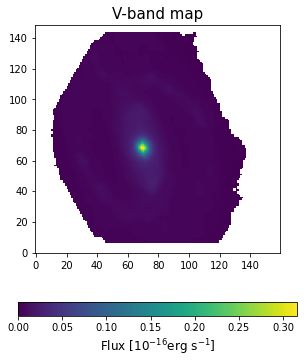

In [78]:
hdu_list = fits.open(califainpath+'UGC12250'+'.Pipe3D.cube.fits.gz')
gaia = hdu_list[7].data
region = hdu_list[8].data
print(gaia.dtype)
    #region = region&(~np.ceil(gaia))
    
v_band = np.where(region,hdu_list[1].data[0],np.nan)
    
fig, ax = plt.subplots(figsize=(5,6))
im = ax.imshow(v_band,origin='lower')
cb = fig.colorbar(im,ax=ax,orientation='horizontal')
cb.set_label(r'Flux [10$^{-16}$erg s$^{-1}$]',size=12)
ax.set_title('V-band map',size=15)
plt.show()
plt.close()
    
hdu_list.close()

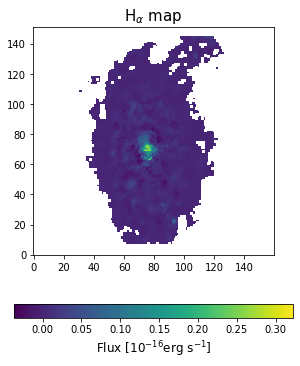

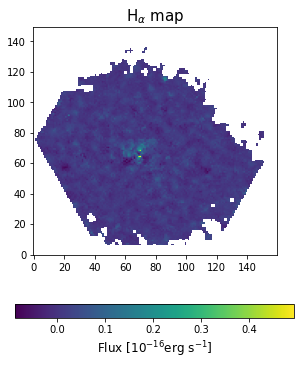

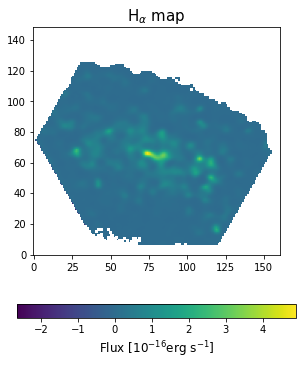

In [24]:
for source in sources[:3]:
    hdu_list = fits.open(califainpath+source+'.Pipe3D.cube.fits.gz')
    gaia = hdu_list[7].data
    region = hdu_list[8].data
    #print(gaia.dtype)
    region = region&np.where(gaia!=0,0,1)
    
    #v_band = np.where(region,hdu_list[1].data[0],np.nan)
    Ha = np.where(region,hdu_list[5].data[45],np.nan)
    
    fig, ax = plt.subplots(figsize=(5,6))
    im = ax.imshow(Ha,origin='lower')
    cb = fig.colorbar(im,ax=ax,orientation='horizontal')
    cb.set_label(r'Flux [10$^{-16}$erg s$^{-1}$]',size=12)
    ax.set_title(r'H$_\alpha$ map',size=15)
    plt.show()
    #plt.savefig(califaoutpath+'/califa_images/'+source+'vband.png')
    plt.close()
    
    hdu_list.close()